In [5]:
#Author: ML Tlachac, 2024
#Paper: Mental Health and Mobile Communication Profiles of Crowdsourced Participants
#github: https://github.com/mltlachac/Communication-Profiles

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn.cluster import KMeans
#https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans

In [6]:
data1 = pd.read_csv("summaryDepreST-CAT.csv")
data2 = pd.read_csv("surveysDepreST-CAT.csv")
data3 = pd.read_csv("featureSet2weeksDepreST-CAT.csv")
data4 = pd.read_csv("timeSeriesDepreST-CAT.csv")
data = data1.merge(data2, on = 'id')
data = data.merge(data3, on = 'id')
print(data.shape)
print(data.columns)
data.head()

(369, 607)
Index(['id', 'inCalls', 'outCalls', 'allCalls', 'inText', 'outText', 'allText',
       'allLogs', 'phq9_x', 'gad7_x',
       ...
       'outCalls0_Wavelet variance_2', 'outCalls0_Wavelet variance_3',
       'outCalls0_Wavelet variance_4', 'outCalls0_Wavelet variance_5',
       'outCalls0_Wavelet variance_6', 'outCalls0_Wavelet variance_7',
       'outCalls0_Wavelet variance_8', 'outCalls0_Zero crossing rate',
       'phq9_y', 'gad7_y'],
      dtype='object', length=607)


,id,inCalls,outCalls,allCalls,inText,outText,allText,allLogs,phq9_x,gad7_x,...,outCalls0_Wavelet variance_2,outCalls0_Wavelet variance_3,outCalls0_Wavelet variance_4,outCalls0_Wavelet variance_5,outCalls0_Wavelet variance_6,outCalls0_Wavelet variance_7,outCalls0_Wavelet variance_8,outCalls0_Zero crossing rate,phq9_y,gad7_y
0,8SEHPRKH5,2699,1635,4334,271,159,430,4764,11,9,...,4.045134e+05,3.154076e+05,2.307977e+05,177738.097688,147068.120980,128451.466641,116002.530161,4.0,11,9
1,9UK1BSBLV,1963,37,2000,3497,104,3601,5601,6,1,...,6.075872e+02,4.647918e+02,2.988297e+02,182.340760,112.353802,71.603635,47.553689,6.0,6,1
2,8LOAAXQ52,1820,1319,3139,6806,0,6806,9945,8,5,...,7.011985e+06,4.160517e+06,1.927105e+06,939889.397772,623484.349712,575110.868332,613022.998698,2.0,8,5
3,3NL2J473W,1653,347,2000,548,243,791,2791,12,8,...,6.962548e+02,2.341504e+02,7.659223e+01,39.255697,40.123745,50.110467,60.012478,5.0,12,8
4,OVW13SMGC,1648,352,2000,1544,812,2356,4356,3,5,...,3.925101e+02,2.744714e+02,1.691722e+02,104.908265,69.412641,49.783911,38.477216,2.0,3,5


In [7]:
print(data3.shape)
data3.head()

(369, 571)


,id,inTexts0_Absolute energy,inTexts0_Area under the curve,inTexts0_Autocorrelation,inTexts0_Centroid,inTexts0_ECDF Percentile Count_0,inTexts0_ECDF Percentile Count_1,inTexts0_ECDF Percentile_0,inTexts0_ECDF Percentile_1,inTexts0_ECDF_0,...,outCalls0_Wavelet variance_2,outCalls0_Wavelet variance_3,outCalls0_Wavelet variance_4,outCalls0_Wavelet variance_5,outCalls0_Wavelet variance_6,outCalls0_Wavelet variance_7,outCalls0_Wavelet variance_8,outCalls0_Zero crossing rate,phq9,gad7
0,00WRNS3MK,9.0,0.015,9.0,0.000000,2.0,11.0,0.0,0.0,0.071429,...,459.477150,470.749139,418.339485,359.621089,313.628753,279.227008,252.763489,6.0,19,17
1,053F3JF85,0.0,0.000,0.0,0.000000,0.0,0.0,0.0,0.0,0.071429,...,71313.172411,36465.583963,17095.999871,9816.542806,7844.960672,7736.559582,8121.111828,4.0,21,18
2,06YZBXW0E,3502.0,1.885,3502.0,0.052364,2.0,11.0,4.0,19.0,0.071429,...,204709.752186,186733.562302,156745.895593,133391.876158,117398.100146,106005.951572,97271.892871,4.0,4,2
3,0832IIHPX,12330.0,3.380,12330.0,0.057781,2.0,11.0,4.0,35.0,0.071429,...,41170.830053,29359.972379,20128.281500,15130.132857,12683.304503,11425.601575,10674.777554,8.0,7,6
4,0AS1KO35P,860.0,0.845,860.0,0.055721,2.0,11.0,1.0,8.0,0.071429,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,4,0


In [8]:
import statistics as stats
#depression
print(data1.phq9.sum()/369)
print(stats.stdev(data1.phq9))
#anxiety
print(data1.gad7.sum()/369)
print(stats.stdev(data1.gad7))

11.319783197831978
7.304009021007302
8.693766937669377
6.324640319717416


In [9]:
#depression
d = 0
for score in data1.phq9:
    if score>= 10:
        d+=1
print(d/369)
#anxiety
a = 0
for score in data1.gad7:
    if score>= 10:
        a+=1
print(a/369)

0.5663956639566395
0.4363143631436314


In [10]:
data3 = pd.read_csv("featureSet2weeksDepreST-CAT.csv")
print(data3.shape)
data3.head()


(369, 571)


,id,inTexts0_Absolute energy,inTexts0_Area under the curve,inTexts0_Autocorrelation,inTexts0_Centroid,inTexts0_ECDF Percentile Count_0,inTexts0_ECDF Percentile Count_1,inTexts0_ECDF Percentile_0,inTexts0_ECDF Percentile_1,inTexts0_ECDF_0,...,outCalls0_Wavelet variance_2,outCalls0_Wavelet variance_3,outCalls0_Wavelet variance_4,outCalls0_Wavelet variance_5,outCalls0_Wavelet variance_6,outCalls0_Wavelet variance_7,outCalls0_Wavelet variance_8,outCalls0_Zero crossing rate,phq9,gad7
0,00WRNS3MK,9.0,0.015,9.0,0.000000,2.0,11.0,0.0,0.0,0.071429,...,459.477150,470.749139,418.339485,359.621089,313.628753,279.227008,252.763489,6.0,19,17
1,053F3JF85,0.0,0.000,0.0,0.000000,0.0,0.0,0.0,0.0,0.071429,...,71313.172411,36465.583963,17095.999871,9816.542806,7844.960672,7736.559582,8121.111828,4.0,21,18
2,06YZBXW0E,3502.0,1.885,3502.0,0.052364,2.0,11.0,4.0,19.0,0.071429,...,204709.752186,186733.562302,156745.895593,133391.876158,117398.100146,106005.951572,97271.892871,4.0,4,2
3,0832IIHPX,12330.0,3.380,12330.0,0.057781,2.0,11.0,4.0,35.0,0.071429,...,41170.830053,29359.972379,20128.281500,15130.132857,12683.304503,11425.601575,10674.777554,8.0,7,6
4,0AS1KO35P,860.0,0.845,860.0,0.055721,2.0,11.0,1.0,8.0,0.071429,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,4,0


In [11]:
corr = data1.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

C:\Users\mltlachac\AppData\Local\Temp\ipykernel_16544\2061797323.py:2: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  corr.style.background_gradient(cmap='coolwarm').set_precision(2)


,inCalls,outCalls,allCalls,inText,outText,allText,allLogs,phq9,gad7
inCalls,1.00,0.63,0.94,0.39,0.15,0.37,0.56,0.05,0.04
outCalls,0.63,1.00,0.86,0.38,0.22,0.38,0.55,0.09,0.07
allCalls,0.94,0.86,1.00,0.42,0.20,0.42,0.62,0.07,0.06
inText,0.39,0.38,0.42,1.00,0.38,0.95,0.93,0.05,0.09
outText,0.15,0.22,0.20,0.38,1.00,0.66,0.62,0.03,0.07
allText,0.37,0.38,0.42,0.95,0.66,1.00,0.97,0.05,0.10
allLogs,0.56,0.55,0.62,0.93,0.62,0.97,1.00,0.06,0.10
phq9,0.05,0.09,0.07,0.05,0.03,0.05,0.06,1.00,0.85
gad7,0.04,0.07,0.06,0.09,0.07,0.10,0.10,0.85,1.00


In [12]:
features = data3[data3.columns[1:-2]]
ids = data3[data3.columns[0:1]]
targets = data3[data3.columns[-2:]]
cnames = features.columns
print(features.shape)
features.head()

(369, 568)


,inTexts0_Absolute energy,inTexts0_Area under the curve,inTexts0_Autocorrelation,inTexts0_Centroid,inTexts0_ECDF Percentile Count_0,inTexts0_ECDF Percentile Count_1,inTexts0_ECDF Percentile_0,inTexts0_ECDF Percentile_1,inTexts0_ECDF_0,inTexts0_ECDF_1,...,outCalls0_Wavelet variance_0,outCalls0_Wavelet variance_1,outCalls0_Wavelet variance_2,outCalls0_Wavelet variance_3,outCalls0_Wavelet variance_4,outCalls0_Wavelet variance_5,outCalls0_Wavelet variance_6,outCalls0_Wavelet variance_7,outCalls0_Wavelet variance_8,outCalls0_Zero crossing rate
0,9.0,0.015,9.0,0.000000,2.0,11.0,0.0,0.0,0.071429,0.142857,...,1044.461838,595.378697,459.477150,470.749139,418.339485,359.621089,313.628753,279.227008,252.763489,6.0
1,0.0,0.000,0.0,0.000000,0.0,0.0,0.0,0.0,0.071429,0.142857,...,107303.053660,87506.881312,71313.172411,36465.583963,17095.999871,9816.542806,7844.960672,7736.559582,8121.111828,4.0
2,3502.0,1.885,3502.0,0.052364,2.0,11.0,4.0,19.0,0.071429,0.142857,...,224107.095817,218449.207781,204709.752186,186733.562302,156745.895593,133391.876158,117398.100146,106005.951572,97271.892871,4.0
3,12330.0,3.380,12330.0,0.057781,2.0,11.0,4.0,35.0,0.071429,0.142857,...,53971.533653,50730.442089,41170.830053,29359.972379,20128.281500,15130.132857,12683.304503,11425.601575,10674.777554,8.0
4,860.0,0.845,860.0,0.055721,2.0,11.0,1.0,8.0,0.071429,0.142857,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0


In [13]:
#normalize each feature between 0 and 1
min_max_scaler = preprocessing.MinMaxScaler()
np_scaled = min_max_scaler.fit_transform(features)
sfeatures = pd.DataFrame(np_scaled, columns = cnames)
print(sfeatures.shape)
sfeatures.head()

(369, 568)


,inTexts0_Absolute energy,inTexts0_Area under the curve,inTexts0_Autocorrelation,inTexts0_Centroid,inTexts0_ECDF Percentile Count_0,inTexts0_ECDF Percentile Count_1,inTexts0_ECDF Percentile_0,inTexts0_ECDF Percentile_1,inTexts0_ECDF_0,inTexts0_ECDF_1,...,outCalls0_Wavelet variance_0,outCalls0_Wavelet variance_1,outCalls0_Wavelet variance_2,outCalls0_Wavelet variance_3,outCalls0_Wavelet variance_4,outCalls0_Wavelet variance_5,outCalls0_Wavelet variance_6,outCalls0_Wavelet variance_7,outCalls0_Wavelet variance_8,outCalls0_Zero crossing rate
0,0.000045,0.001576,0.000045,0.000000,0.222222,1.0,0.000000,0.000,0.0,0.0,...,0.000029,0.000029,0.000031,0.000024,0.000019,0.000016,0.000014,0.000013,0.000013,0.6
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000,0.0,0.0,...,0.002951,0.004306,0.004751,0.001856,0.000771,0.000436,0.000360,0.000374,0.000417,0.4
2,0.017641,0.198108,0.017641,0.434450,0.222222,1.0,0.095238,0.152,0.0,0.0,...,0.006162,0.010749,0.013638,0.009505,0.007069,0.005930,0.005387,0.005122,0.004989,0.4
3,0.062112,0.355229,0.062112,0.479390,0.222222,1.0,0.095238,0.280,0.0,0.0,...,0.001484,0.002496,0.002743,0.001495,0.000908,0.000673,0.000582,0.000552,0.000548,0.8
4,0.004332,0.088807,0.004332,0.462298,0.222222,1.0,0.023810,0.064,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0


In [14]:
numberOfFeatures = 3
pcnames = []
for n in range(0, numberOfFeatures):
    pcnames.append("PC" + str(n))
pca = PCA(n_components=numberOfFeatures)
pca = pca.fit(sfeatures)
X_pca = pca.transform(sfeatures)
pcaDF = pd.DataFrame(X_pca, columns = pcnames)
pcaDF.head()

,PC0,PC1,PC2
0,0.547126,-0.839965,-1.522538
1,0.620034,-1.350896,-2.202705
2,1.016386,-1.132049,-0.038627
3,1.112085,-1.171040,0.189946
4,-3.474177,0.100178,1.198440


In [15]:
pca_exp = pd.DataFrame(pca.components_, columns = cnames).transpose()
pca_exp.columns = ["PC0", "PC1", "PC2"]
pca_exp.head(2)

,PC0,PC1,PC2
inTexts0_Absolute energy,0.002239,-0.003220,0.023383
inTexts0_Area under the curve,0.010055,-0.018595,0.080652


In [16]:
#pca_exp.sort_values(by = 'PC0')[:2] #-0.15
pca_exp.sort_values(by = 'PC0')["PC0"][-6:] #next 0.158

outCalls0_Wavelet entropy      0.180250
outCalls0_Maximum frequency    0.181192
outCalls0_Spectral roll-off    0.181192
inCalls0_Wavelet entropy       0.182980
inCalls0_Maximum frequency     0.184026
inCalls0_Spectral roll-off     0.184026
Name: PC0, dtype: float64

In [17]:
print(pca_exp.sort_values(by = 'PC1')["PC1"][:1]) #next -0.141
pca_exp.sort_values(by = 'PC1')["PC1"][-9:] #next 0.161

outTexts0_Spectral variation   -0.231293
Name: PC1, dtype: float64


outTexts0_Median frequency           0.180044
outTexts0_ECDF Percentile Count_1    0.186341
outTexts0_Power bandwidth            0.213380
outTexts0_Spectral centroid          0.219980
outTexts0_Spectral entropy           0.225428
outTexts0_Spectral spread            0.241294
outTexts0_Wavelet entropy            0.277711
outTexts0_Maximum frequency          0.278479
outTexts0_Spectral roll-off          0.278479
Name: PC1, dtype: float64

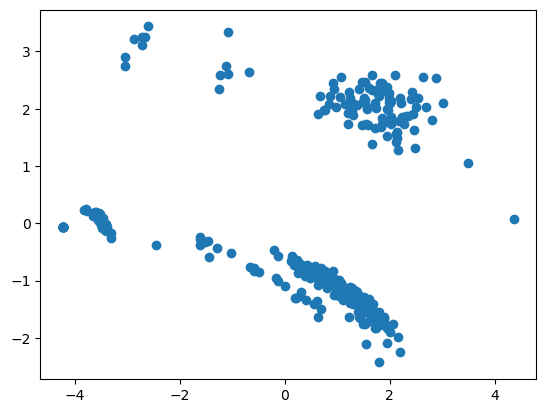

In [18]:
plt.scatter(pcaDF['PC0'], pcaDF['PC1'])
plt.show()
plt.close()

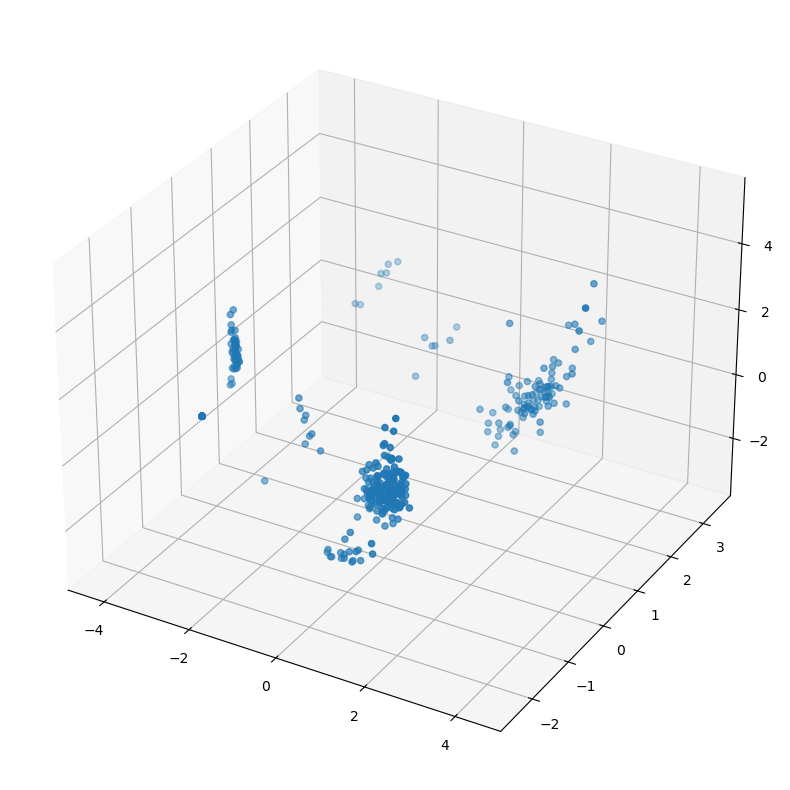

In [19]:
fig = plt.figure(figsize= (10,10))
ax = fig.add_subplot(projection='3d')
ax.scatter(pcaDF['PC0'], pcaDF['PC1'], pcaDF["PC2"])

In [20]:
pcaDF2 = pcaDF.assign(target = ids)
pcnames2 = pcnames + ["id"]
pcaDF2.columns = pcnames2
newdf = data2.merge(pcaDF2, on = "id")
newdf = newdf.merge(data1, on = "id")
newdf = newdf.merge(data4, on = "id")
print(newdf.columns)
newdf.head()

Index(['id', 'appVersion', 'PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4',
       'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9',
       'PHQ - Total', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4',
       'GAD - Q5', 'GAD - Q6', 'GAD - Q7', 'GAD - Total', 'Gender', 'Age',
       'StudentStatus', 'PriorDepressionTreatment', 'Remote', 'COVID', 'Group',
       'Timestamp', 'PC0', 'PC1', 'PC2', 'inCalls_x', 'outCalls_x', 'allCalls',
       'inText', 'outText', 'allText', 'allLogs', 'phq9', 'gad7', 'inTexts',
       'outTexts', 'inCalls_y', 'outCalls_y'],
      dtype='object')


,id,appVersion,PHQ - Q1,PHQ - Q2,PHQ - Q3,PHQ - Q4,PHQ - Q5,PHQ - Q6,PHQ - Q7,PHQ - Q8,...,inText,outText,allText,allLogs,phq9,gad7,inTexts,outTexts,inCalls_y,outCalls_y
0,1MZ0A5PA6,stereotype threat,2,1,2,3,2,1,3,0,...,4602,3654,8256,9133,15,12,"[1, 19, 9, 2, 3, 17, 15, 16, 3, 27, 21, 19, 15...","[0, 14, 5, 3, 4, 16, 7, 18, 4, 25, 22, 16, 9, ...","[0, 0, 0, 240, 91, 140, 45, 9, 0, 120, 0, 0, 0...","[0, 0, 0, 56, 0, 154, 0, 10, 0, 2, 116, 27, 20..."
1,E7EEQIEOV,control,1,0,1,1,0,1,1,0,...,858,707,1565,3848,5,5,"[5, 12, 14, 15, 25, 21, 5, 25, 17, 14, 10, 14,...","[4, 2, 6, 8, 5, 3, 0, 11, 7, 6, 0, 4, 3, 3, 11...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 60, 0, 47...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 288, 7, 36, ..."
2,IHNGBZ4G4,control,1,1,2,3,3,2,2,1,...,1924,0,1924,2955,16,7,"[9, 21, 21, 12, 24, 38, 31, 10, 27, 7, 9, 14, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,R8CI0EGMO,stereotype threat,1,2,3,2,2,3,3,0,...,2332,0,2332,4332,16,11,"[2, 28, 35, 17, 10, 18, 16, 18, 35, 42, 27, 21...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[617, 202, 46, 74, 54, 73, 1049, 4915, 207, 39...","[601, 195, 12, 151, 0, 6634, 146, 172, 47, 0, ..."
4,FWJ1GB40T,control,2,2,2,3,1,2,3,1,...,836,0,836,1336,16,19,"[0, 2, 1, 1, 1, 0, 0, 0, 0, 8, 4, 8, 1, 1, 3, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 975, 0, 0, 2435...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 4325, 1716, 568, 6..."


0.7642276422764228
0.84
0.7125
0.746031746031746


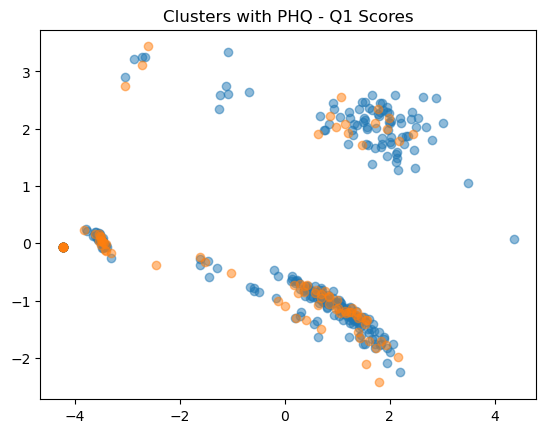

0.7425474254742548
0.79
0.7125
0.7301587301587301


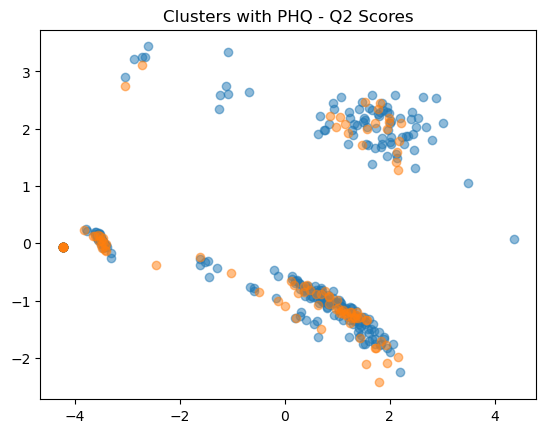

0.7859078590785907
0.88
0.7625
0.746031746031746


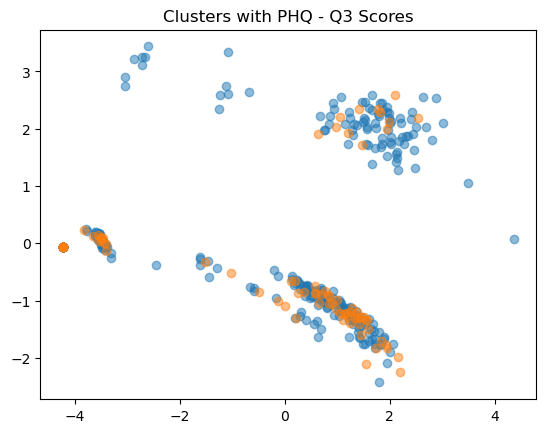

0.8346883468834688
0.9
0.775
0.8253968253968254


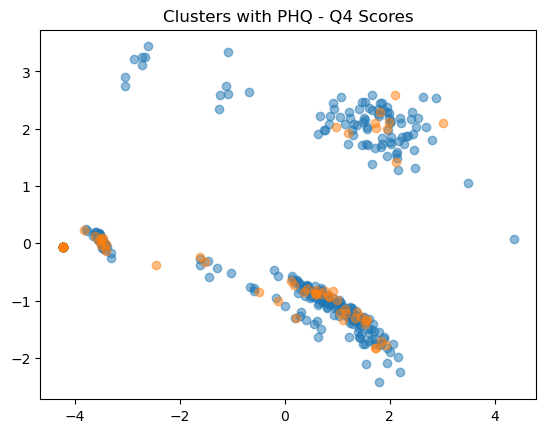

0.7127371273712737
0.78
0.575
0.7354497354497355


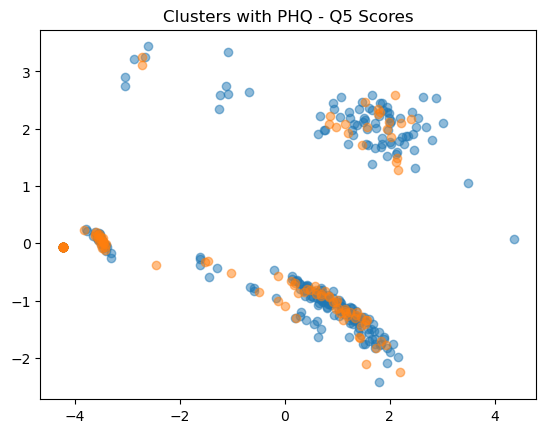

0.6964769647696477
0.74
0.675
0.6825396825396826


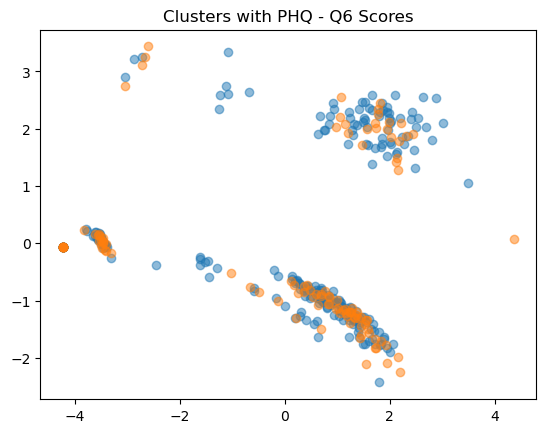

0.7208672086720868
0.83
0.675
0.6825396825396826


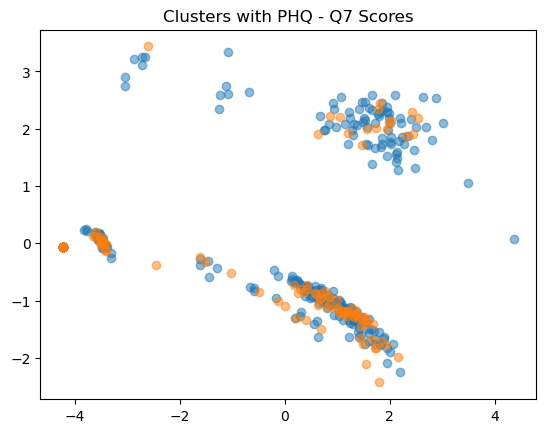

0.3062330623306233
0.35
0.2625
0.30158730158730157


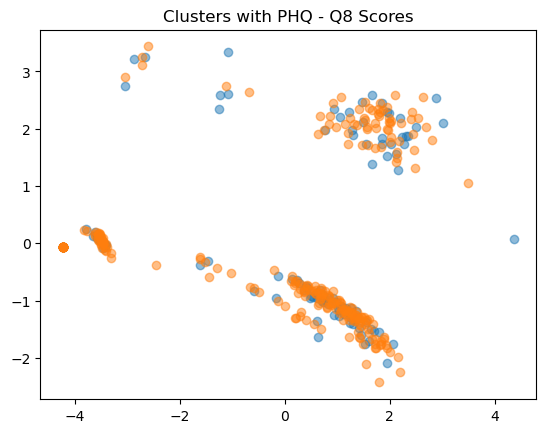

0.33875338753387535
0.43
0.2875
0.31216931216931215


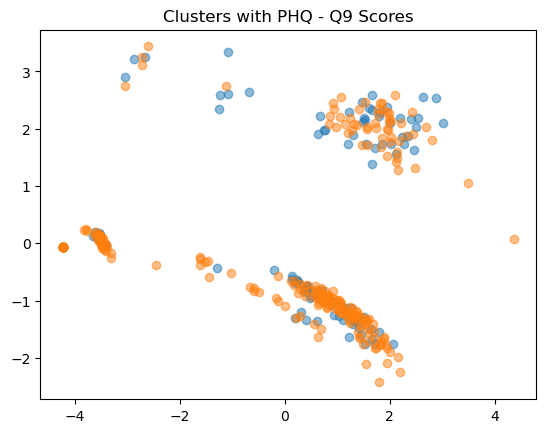

0.7723577235772358
0.85
0.7375
0.746031746031746


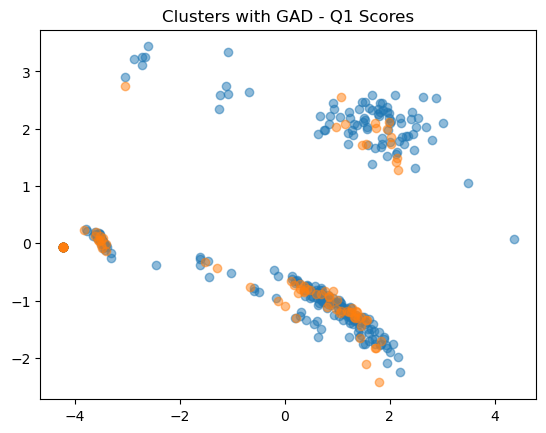

0.6585365853658537
0.74
0.6625
0.6137566137566137


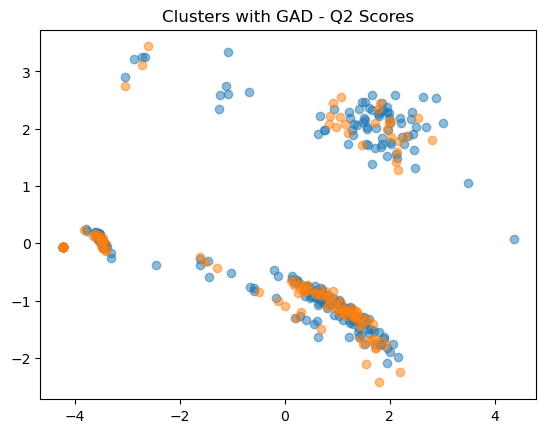

0.7262872628726287
0.78
0.7
0.708994708994709


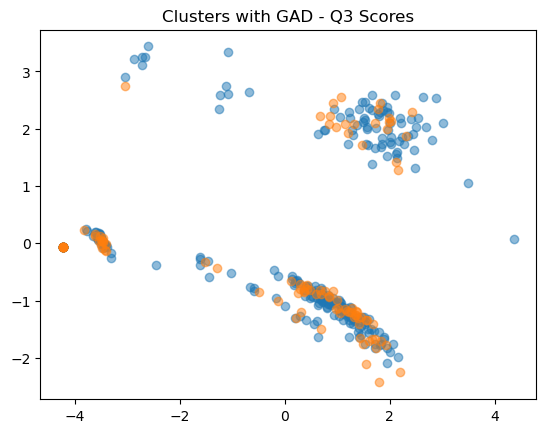

0.7588075880758808
0.86
0.7
0.7301587301587301


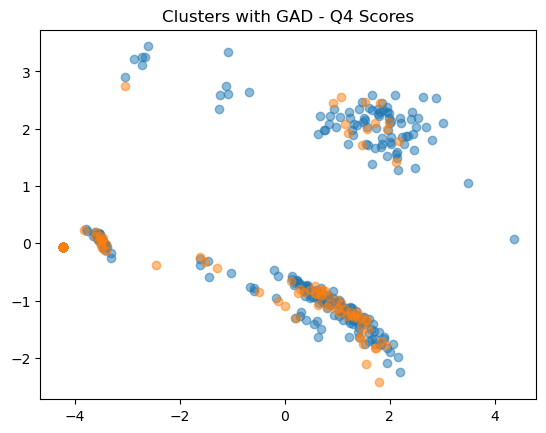

0.48509485094850946
0.59
0.375
0.47619047619047616


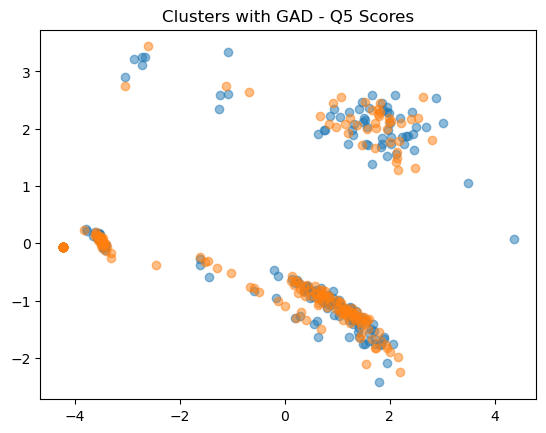

0.7371273712737128
0.78
0.7
0.7301587301587301


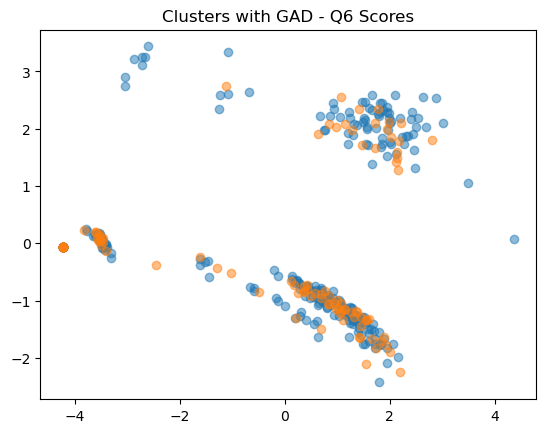

0.5528455284552846
0.65
0.525
0.5132275132275133


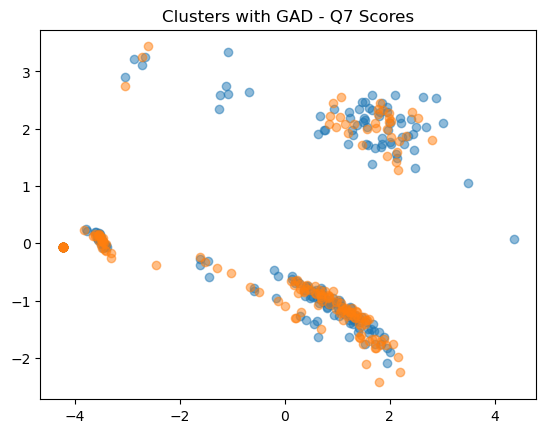

In [21]:
for v3 in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    newdf1 = newdf[newdf[v3] >= 1] #blue
    newdf2 = newdf[newdf[v3] < 1] #orange
    #print(newdf[newdf.PC1 >= 1].shape[0])
    print(newdf1.shape[0]/newdf.shape[0])
    print(newdf1[newdf1.PC1 >= 1].shape[0]/newdf[newdf.PC1 >= 1].shape[0])
    print(newdf1[(newdf1.PC1 < 1)&(newdf1.PC0 < -2)].shape[0]/newdf[(newdf.PC1 < 1)&(newdf.PC0 < -2)].shape[0])
    print(newdf1[(newdf1.PC1 < 1)&(newdf1.PC0 >= -2)].shape[0]/newdf[(newdf.PC1 < 1)&(newdf.PC0 >= -2)].shape[0])


    plt.scatter(newdf1['PC0'], newdf1['PC1'], alpha = 0.5)
    plt.scatter(newdf2['PC0'], newdf2['PC1'], alpha = 0.5)
    plt.title("Clusters with " + v3 + " Scores")
    plt.show()
    plt.close()

0.5663956639566395
0.59
0.525
0.5714285714285714


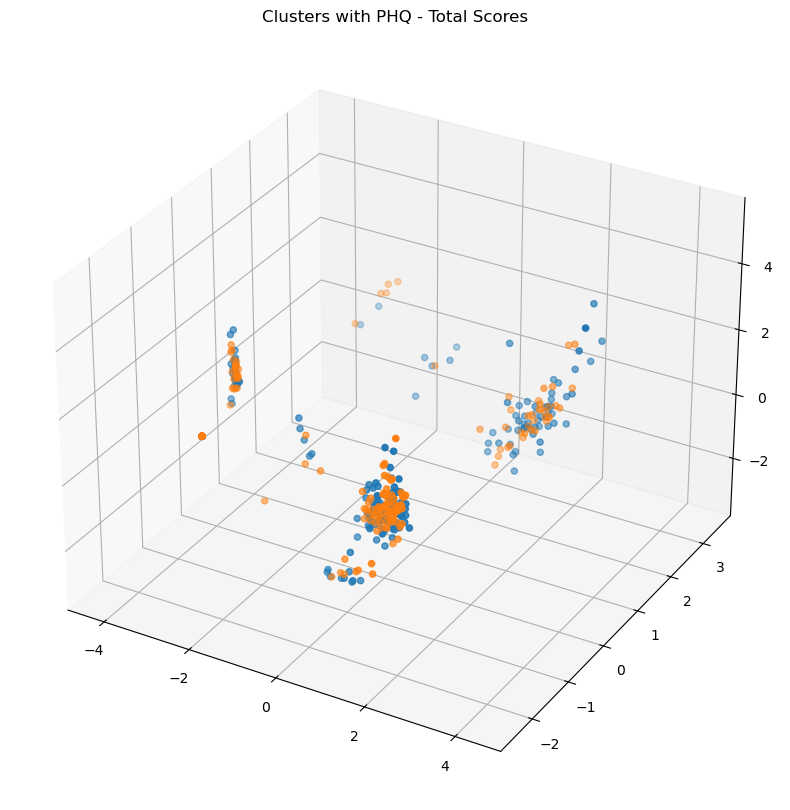

0.4363143631436314
0.52
0.4125
0.4021164021164021


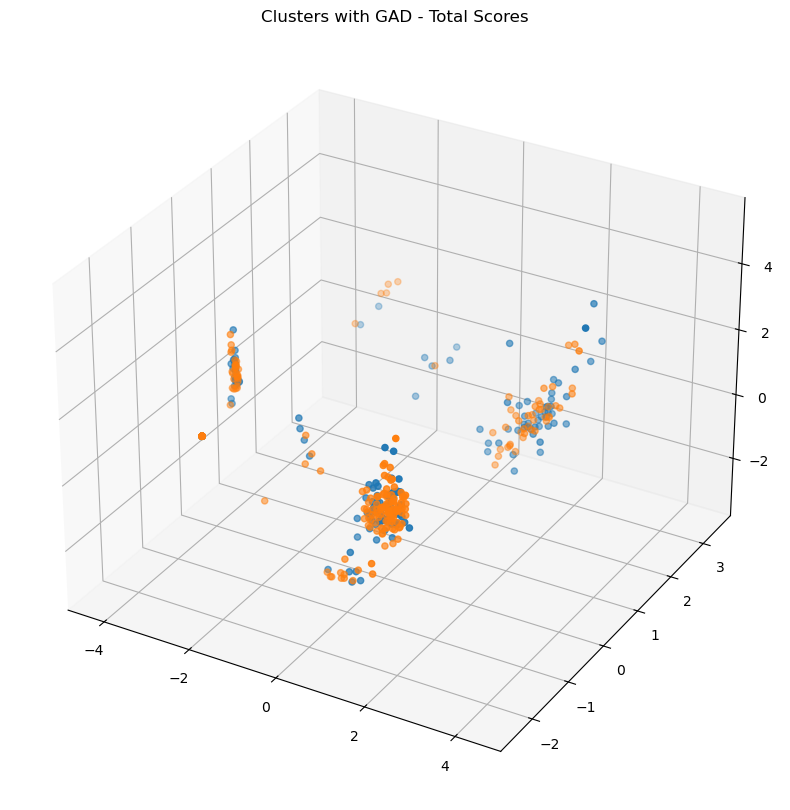

In [22]:
v3 = "PHQ - Total"
newdf1 = newdf[newdf[v3] >= 10] #blue
newdf2 = newdf[newdf[v3] < 10] #orange
#print(newdf[newdf.PC1 >= 1].shape[0])
print(newdf1.shape[0]/newdf.shape[0])
print(newdf1[newdf1.PC1 >= 1].shape[0]/newdf[newdf.PC1 >= 1].shape[0])
print(newdf1[(newdf1.PC1 < 1)&(newdf1.PC0 < -2)].shape[0]/newdf[(newdf.PC1 < 1)&(newdf.PC0 < -2)].shape[0])
print(newdf1[(newdf1.PC1 < 1)&(newdf1.PC0 >= -2)].shape[0]/newdf[(newdf.PC1 < 1)&(newdf.PC0 >= -2)].shape[0])
#plt.xlim(-0.5,2.5)
#plt.ylim(-2.5,0)

fig = plt.figure(figsize= (10,10))
ax = fig.add_subplot(projection='3d')
ax.scatter(newdf1['PC0'], newdf1['PC1'], newdf1["PC2"])
ax.scatter(newdf2['PC0'], newdf2['PC1'], newdf2["PC2"])
#plt.scatter(newdf1['PC0'], newdf1['PC1'], alpha = 0.5)
#plt.scatter(newdf2['PC0'], newdf2['PC1'], alpha = 0.5)
plt.title("Clusters with " + v3 + " Scores")
plt.show()
plt.close()

v3 = "GAD - Total"
newdf1 = newdf[newdf[v3] >= 10]
newdf2 = newdf[newdf[v3] < 10]
#print(newdf[newdf.PC1 >= 1].shape[0])
print(newdf1.shape[0]/newdf.shape[0])
print(newdf1[newdf1.PC1 >= 1].shape[0]/newdf[newdf.PC1 >= 1].shape[0])
print(newdf1[(newdf1.PC1 < 1)&(newdf1.PC0 < -2)].shape[0]/newdf[(newdf.PC1 < 1)&(newdf.PC0 < -2)].shape[0])
print(newdf1[(newdf1.PC1 < 1)&(newdf1.PC0 >= -2)].shape[0]/newdf[(newdf.PC1 < 1)&(newdf.PC0 >= -2)].shape[0])

fig = plt.figure(figsize= (10,10))
ax = fig.add_subplot(projection='3d')
ax.scatter(newdf1['PC0'], newdf1['PC1'], newdf1["PC2"])
ax.scatter(newdf2['PC0'], newdf2['PC1'], newdf2["PC2"])
#plt.scatter(newdf1['PC0'], newdf1['PC1'], alpha = 0.5)
#plt.scatter(newdf2['PC0'], newdf2['PC1'], alpha = 0.5)
plt.title("Clusters with " + v3 + " Scores")
plt.show()
plt.close()

In [23]:
print(newdf.columns)
newdf.head(2)

Index(['id', 'appVersion', 'PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4',
       'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9',
       'PHQ - Total', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4',
       'GAD - Q5', 'GAD - Q6', 'GAD - Q7', 'GAD - Total', 'Gender', 'Age',
       'StudentStatus', 'PriorDepressionTreatment', 'Remote', 'COVID', 'Group',
       'Timestamp', 'PC0', 'PC1', 'PC2', 'inCalls_x', 'outCalls_x', 'allCalls',
       'inText', 'outText', 'allText', 'allLogs', 'phq9', 'gad7', 'inTexts',
       'outTexts', 'inCalls_y', 'outCalls_y'],
      dtype='object')


,id,appVersion,PHQ - Q1,PHQ - Q2,PHQ - Q3,PHQ - Q4,PHQ - Q5,PHQ - Q6,PHQ - Q7,PHQ - Q8,...,inText,outText,allText,allLogs,phq9,gad7,inTexts,outTexts,inCalls_y,outCalls_y
0,1MZ0A5PA6,stereotype threat,2,1,2,3,2,1,3,0,...,4602,3654,8256,9133,15,12,"[1, 19, 9, 2, 3, 17, 15, 16, 3, 27, 21, 19, 15...","[0, 14, 5, 3, 4, 16, 7, 18, 4, 25, 22, 16, 9, ...","[0, 0, 0, 240, 91, 140, 45, 9, 0, 120, 0, 0, 0...","[0, 0, 0, 56, 0, 154, 0, 10, 0, 2, 116, 27, 20..."
1,E7EEQIEOV,control,1,0,1,1,0,1,1,0,...,858,707,1565,3848,5,5,"[5, 12, 14, 15, 25, 21, 5, 25, 17, 14, 10, 14,...","[4, 2, 6, 8, 5, 3, 0, 11, 7, 6, 0, 4, 3, 3, 11...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 60, 0, 47...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 288, 7, 36, ..."


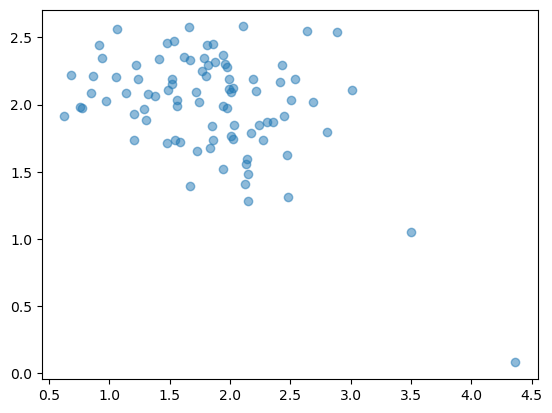

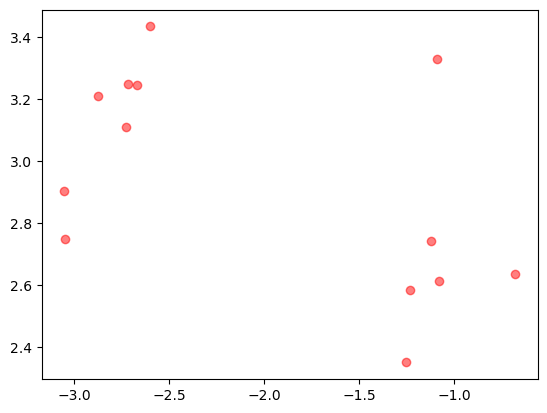

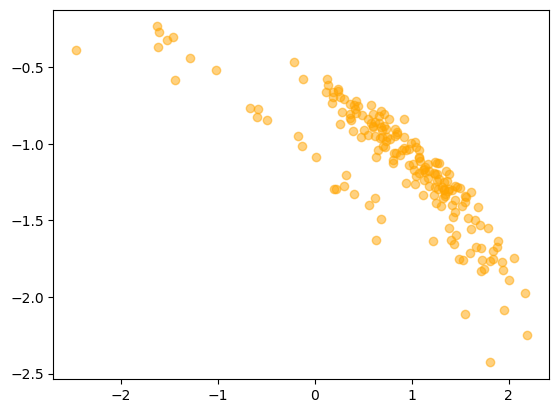

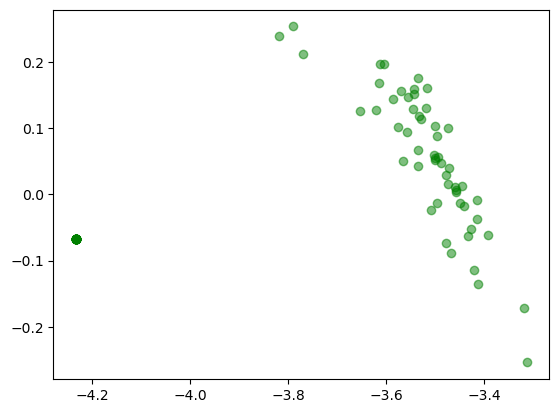

In [24]:
#just plots
newdfne = newdf[(newdf["PC1"] >= 0) & (newdf["PC0"] >= 0)]
plt.scatter(newdfne['PC0'], newdfne['PC1'], alpha = 0.5)
plt.show()
plt.close()

newdfnw = newdf[(newdf["PC1"] >= 0) & (newdf["PC0"] >= -3.25) & (newdf["PC0"] <= 0)]
plt.scatter(newdfnw['PC0'], newdfnw['PC1'], alpha = 0.5, color = 'red')
plt.show()
plt.close()

newdfright = newdf[(newdf["PC1"] < 0) & (newdf["PC0"] >= -3.25)]
plt.scatter(newdfright['PC0'], newdfright['PC1'], alpha = 0.5, color = 'orange')
plt.show()
plt.close()

newdfleft = newdf[(newdf["PC1"] < 0.5) & (newdf["PC0"] < -3.25)]
plt.scatter(newdfleft['PC0'], newdfleft['PC1'], alpha = 0.5, color = 'green')
plt.show()
plt.close()

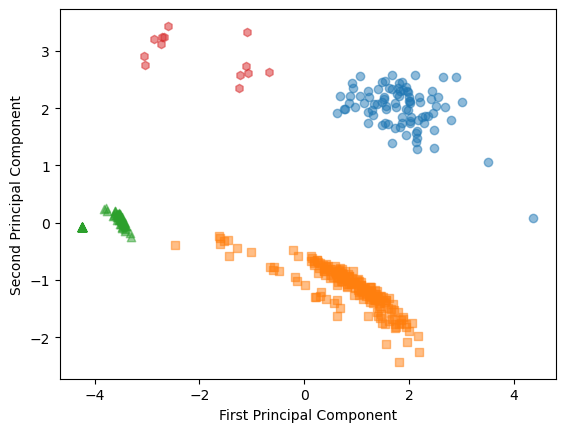

In [37]:
plt.scatter(newdfne['PC0'], newdfne['PC1'], alpha = 0.5)
plt.scatter(newdfright['PC0'], newdfright['PC1'], alpha = 0.5, marker = 's')
plt.scatter(newdfleft['PC0'], newdfleft['PC1'], alpha = 0.5, marker = '^')
plt.scatter(newdfnw['PC0'], newdfnw['PC1'], alpha = 0.5, marker = 'h')
plt.xlabel("First Principal Component")
plt.ylabel("Second Principal Component")

#plt.savefig("images/clustering.png", bbox_inches= 'tight')
plt.show()
plt.close()

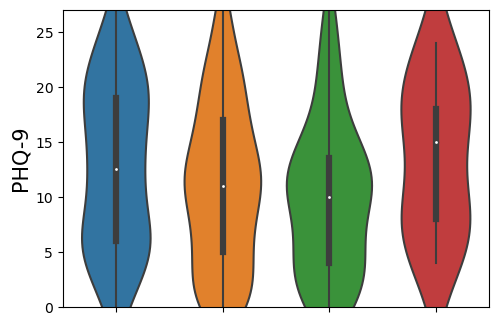

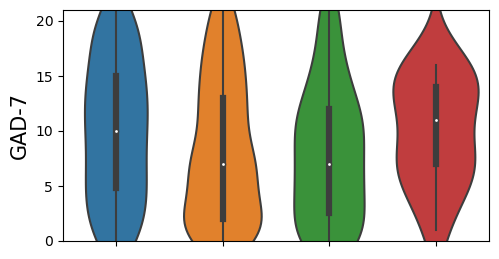

In [43]:
import seaborn as sns
from scipy.stats import ttest_ind
from scipy.stats import f_oneway

q = 'PHQ - Total'
#for v3 in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:

fig = plt.figure(figsize =(5.5,27/7))
fig = sns.violinplot(data=[newdfne[q], newdfright[q], newdfleft[q], newdfnw[q]])
plt.ylabel("PHQ-9", fontsize = 15)
plt.ylim(0,27)
fig.set(xticklabels=[])

#plt.savefig("images/" + q + ".png", bbox_inches= 'tight')
plt.show()
plt.close()

q = 'GAD - Total'
#for v3 in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:

fig = plt.figure(figsize =(5.5,21/7))
fig = sns.violinplot(data=[newdfne[q], newdfright[q], newdfleft[q], newdfnw[q]])
plt.ylabel("GAD-7", fontsize = 15)
fig.set_yticks(range(0,21,5))
plt.ylim(0,21)
fig.set(xticklabels=[])


#plt.savefig("images/" + q + ".png", bbox_inches= 'tight')
plt.show()
plt.close()

In [44]:
for q in ['PHQ - Total', 'GAD - Total']:  
    print("&"+str(round(ttest_ind(newdfne[q], newdfright[q])[1],3)) + "&" + str(round(ttest_ind(newdfne[q], newdfleft[q])[1],3)) + "&" + str(round(ttest_ind(newdfne[q], newdfnw[q])[1],3)) + "&" + str(round(ttest_ind(newdfright[q], newdfleft[q])[1],3))+ "&" + str(round(ttest_ind(newdfright[q], newdfnw[q])[1],3))+ "&" + str(round(ttest_ind(newdfleft[q], newdfnw[q])[1],3)))


&0.08&0.012&0.776&0.229&0.276&0.096
&0.055&0.051&0.968&0.727&0.405&0.309


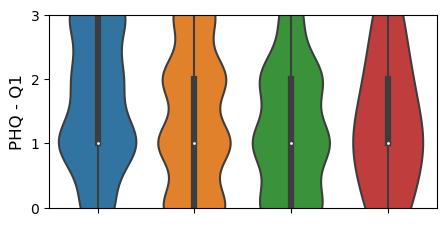

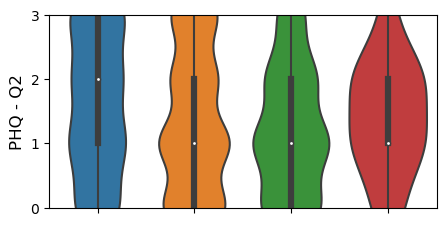

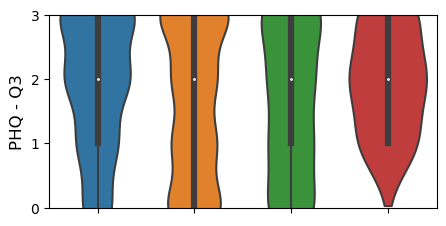

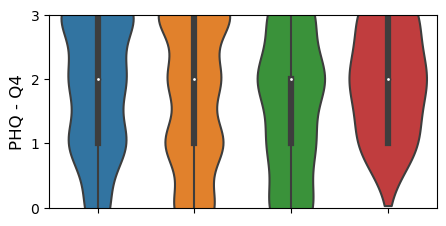

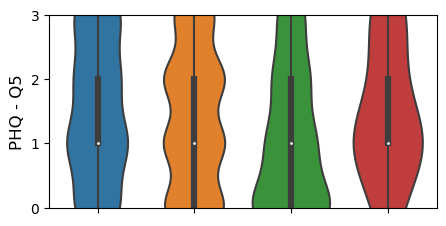

...

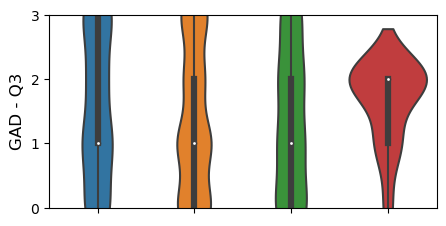

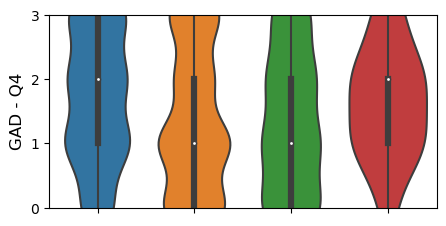

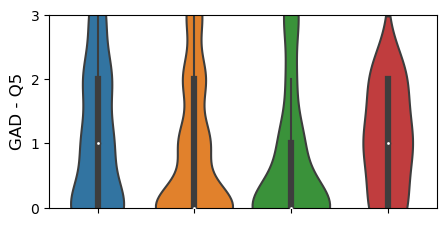

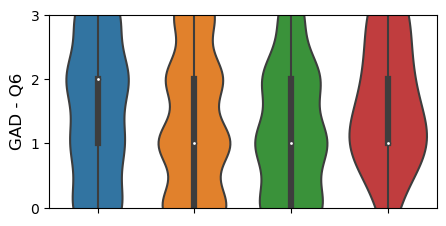

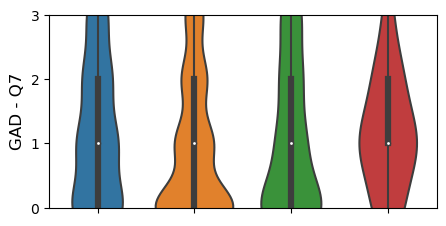

In [46]:
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:

    fig = plt.figure(figsize =(5,2.5))
    fig = sns.violinplot(data=[newdfne[q], newdfright[q], newdfleft[q], newdfnw[q]])
    #plt.title(q)
    #plt.xlabel("Clusters")
    fig.set_yticks(range(0,4,1))
    fig.set(xticklabels=[])
    plt.ylabel(q, fontsize = 12)
    plt.ylim(0,3)
    
    #plt.savefig("images/" + q + ".png", bbox_inches= 'tight')
    plt.show()
    plt.close()
    
    #print(q)
    #print("&"+str(round(ttest_ind(newdfne[q], newdfright[q])[1],3)) + "&" + str(round(ttest_ind(newdfne[q], newdfleft[q])[1],3)) + "&" + str(round(ttest_ind(newdfne[q], newdfnw[q])[1],3)) + "&" + str(round(ttest_ind(newdfright[q], newdfleft[q])[1],3))+ "&" + str(round(ttest_ind(newdfright[q], newdfnw[q])[1],3))+ "&" + str(round(ttest_ind(newdfleft[q], newdfnw[q])[1],3)))
    #print(f_oneway(newdfup[q], newdfright[q], newdfleft[q]))
    #print("______________________________________________________________")

In [47]:
for q in ["PHQ - Total", 'PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', "GAD - Total", 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    
    print(str(round(sum(newdfne[q])/len(newdfne[q]), 2)) + "\pm" + str(round(np.std(newdfne[q]),2)) + "&" + str(round(sum(newdfright[q])/len(newdfright[q]), 2)) + "\pm" + str(round(np.std(newdfright[q]),2)) + "&" + str(round(sum(newdfleft[q])/len(newdfleft[q]), 2)) + "\pm" + str(round(np.std(newdfleft[q]),2)) + "&" + str(round(sum(newdfnw[q])/len(newdfnw[q]), 2)) + "\pm" + str(round(np.std(newdfnw[q]),2)) + "&" + str(round(f_oneway(newdfne[q], newdfright[q], newdfleft[q], newdfnw[q])[1], 3)) + "\\\\")
    

12.76\pm7.39&11.09\pm7.33&9.92\pm6.84&13.38\pm6.59&0.056\\
1.6\pm1.03&1.35\pm1.05&1.2\pm0.96&1.31\pm0.99&0.086\\
1.57\pm1.11&1.34\pm1.09&1.22\pm0.99&1.38\pm0.84&0.191\\
1.9\pm1.04&1.62\pm1.19&1.62\pm1.16&2.0\pm0.78&0.185\\
1.85\pm1.03&1.71\pm1.11&1.57\pm1.06&2.0\pm0.78&0.288\\
1.48\pm1.09&1.37\pm1.06&1.05\pm1.08&1.46\pm1.01&0.063\\
1.56\pm1.2&1.39\pm1.16&1.18\pm1.03&1.62\pm1.27&0.171\\
1.62\pm1.08&1.31\pm1.14&1.18\pm1.03&1.69\pm0.91&0.033\\
0.53\pm0.85&0.51\pm0.91&0.42\pm0.81&0.92\pm1.0&0.287\\
0.65\pm0.93&0.49\pm0.85&0.49\pm0.9&1.0\pm0.88&0.136\\
9.92\pm6.3&8.32\pm6.44&8.03\pm6.06&9.85\pm4.64&0.153\\
1.64\pm1.02&1.41\pm1.09&1.38\pm1.03&1.69\pm0.91&0.27\\
1.42\pm1.1&1.16\pm1.14&1.09\pm0.98&1.15\pm0.77&0.204\\
1.52\pm1.14&1.35\pm1.13&1.34\pm1.11&1.62\pm0.62&0.56\\
1.67\pm1.03&1.35\pm1.11&1.33\pm1.09&1.62\pm0.84&0.1\\
1.05\pm1.07&0.84\pm1.04&0.68\pm1.03&1.0\pm0.78&0.146\\
1.49\pm1.08&1.32\pm1.06&1.2\pm0.99&1.62\pm0.92&0.252\\
1.14\pm1.07&0.89\pm1.04&1.0\pm1.11&1.15\pm0.86&0.302\\


## Bayesian Estimation

In [ ]:
import scipy.stats
import matplotlib.pyplot as plt
import pymc as pm
#code adapted from https://www.pymc.io/projects/examples/en/latest/case_studies/BEST.html

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 306 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,1.677,0.963,-0.096,3.542,0.010,0.007,8943.0,6548.0,1.0
difference of stds,0.154,0.701,-1.212,1.447,0.008,0.008,7936.0,4826.0,1.0
effect size,0.227,0.130,-0.018,0.471,0.001,0.001,8886.0,6589.0,1.0


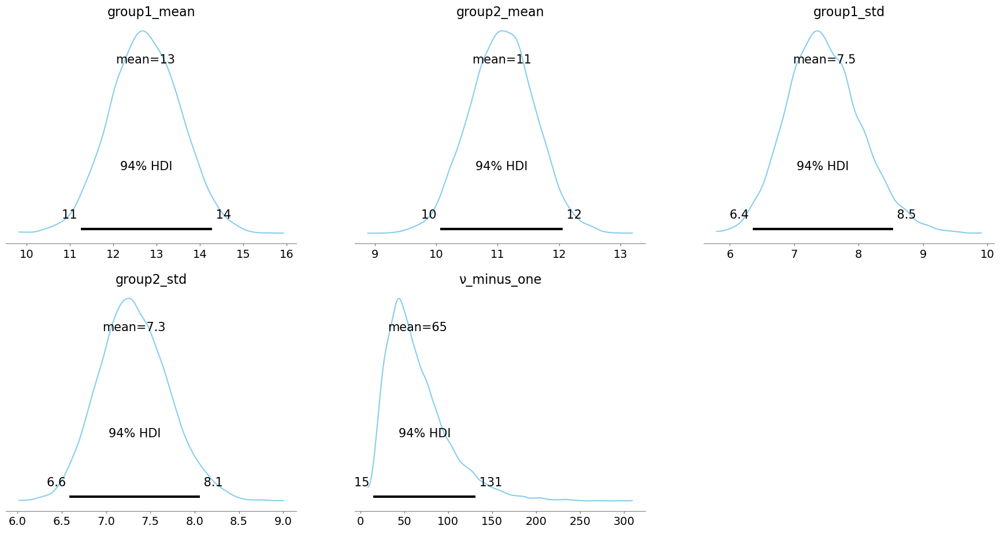

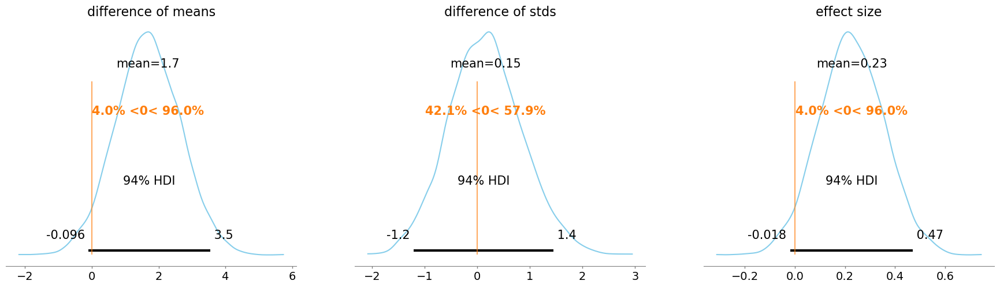

In [40]:
q = "PHQ - Total"
drug = newdfne[q]
placebo = newdfright[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 231 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,2.880,1.134,0.772,5.057,0.012,0.009,8622.0,6271.0,1.0
difference of stds,0.598,0.810,-0.980,2.021,0.011,0.008,5618.0,4785.0,1.0
effect size,0.403,0.160,0.109,0.712,0.002,0.001,8281.0,6122.0,1.0


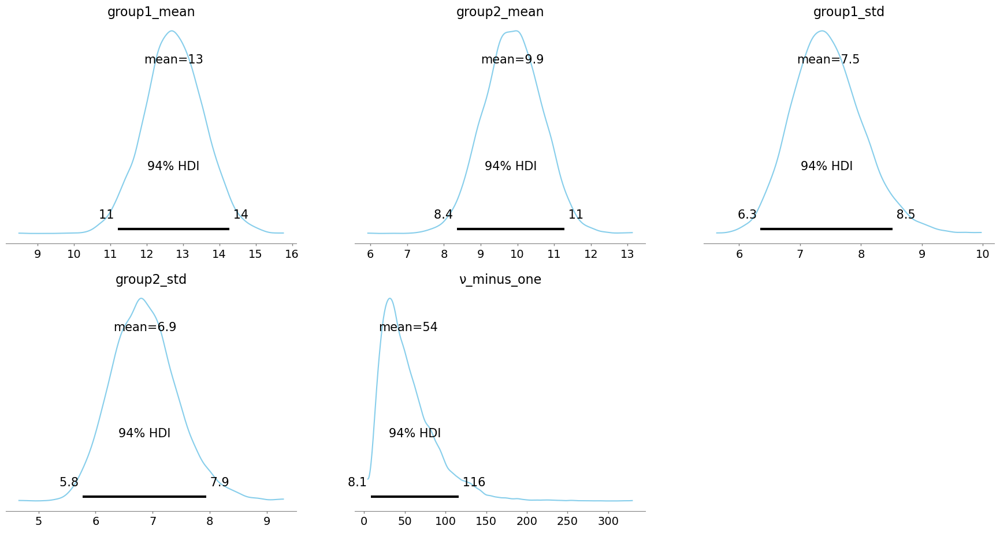

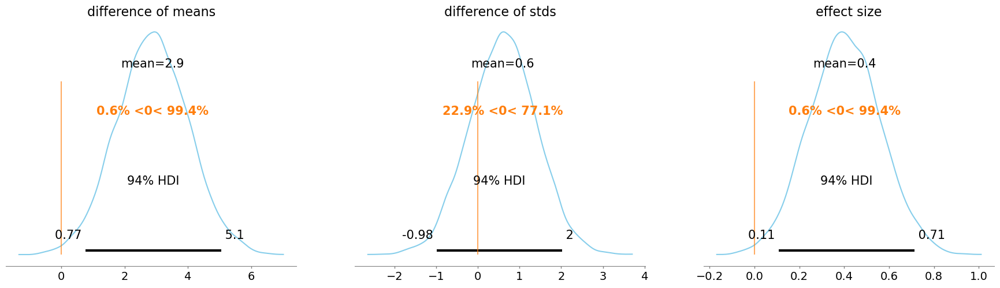

In [41]:
q = "PHQ - Total"
drug = newdfne[q]
placebo = newdfleft[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 209 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,-0.638,2.176,-4.956,3.331,0.026,0.023,6842.0,5656.0,1.0
difference of stds,0.267,1.415,-2.399,2.762,0.021,0.016,4441.0,3795.0,1.0
effect size,-0.087,0.293,-0.617,0.493,0.004,0.003,6961.0,5793.0,1.0


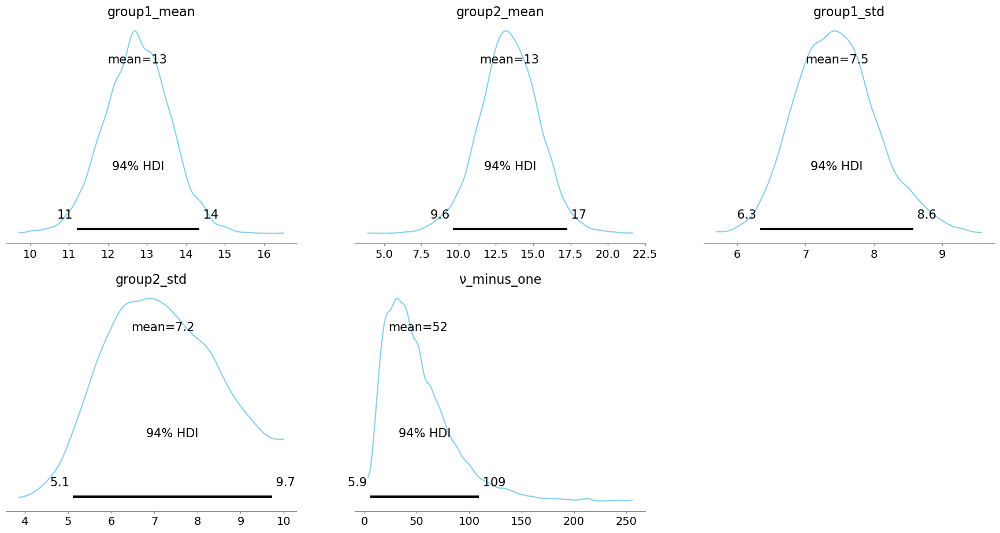

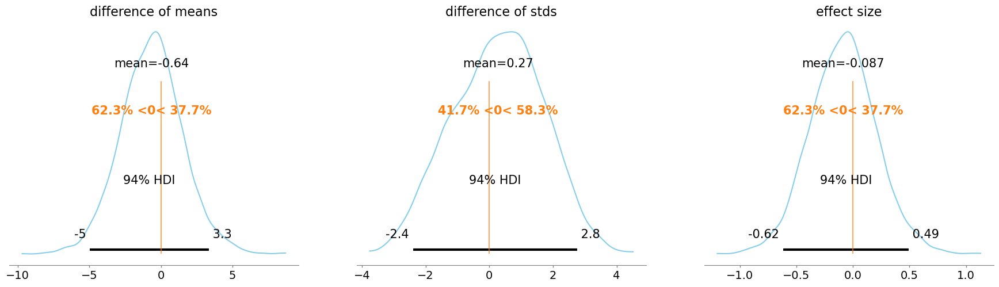

In [42]:
q = "PHQ - Total"
drug = newdfne[q]
placebo = newdfnw[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 269 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,1.187,0.961,-0.540,3.087,0.010,0.008,8918.0,6356.0,1.0
difference of stds,0.436,0.693,-0.846,1.741,0.008,0.006,8513.0,5243.0,1.0
effect size,0.168,0.136,-0.078,0.432,0.001,0.001,8873.0,6165.0,1.0


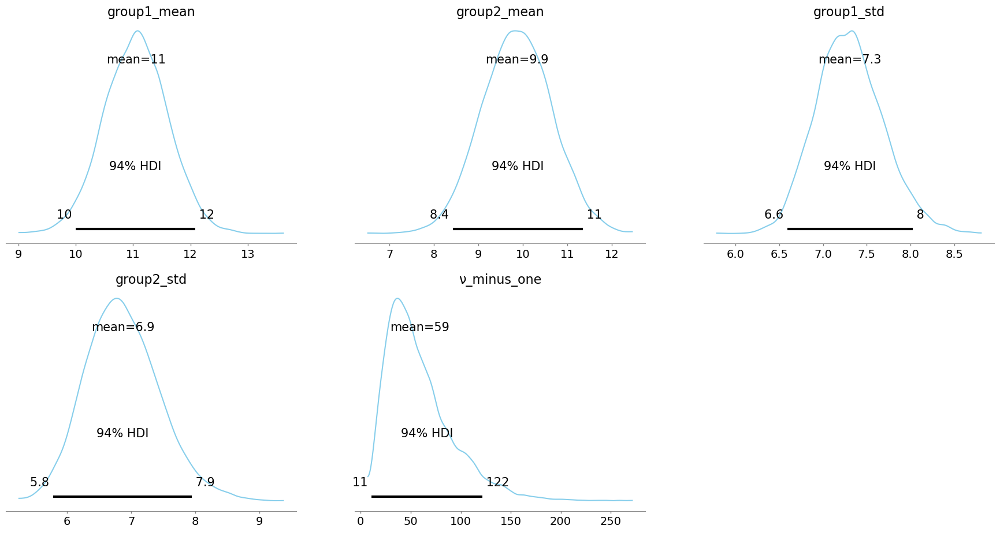

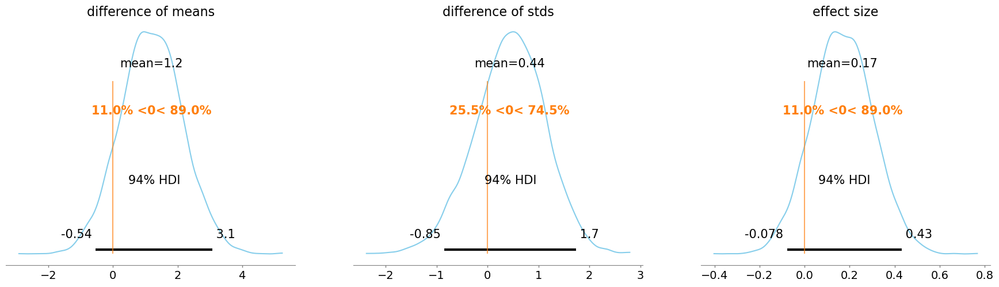

In [43]:
q = "PHQ - Total"
drug = newdfright[q]
placebo = newdfleft[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 287 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,-2.297,2.134,-6.390,1.651,0.024,0.020,8146.0,4859.0,1.0
difference of stds,0.106,1.333,-2.489,2.362,0.019,0.015,5062.0,3858.0,1.0
effect size,-0.318,0.290,-0.878,0.219,0.003,0.003,8159.0,4906.0,1.0


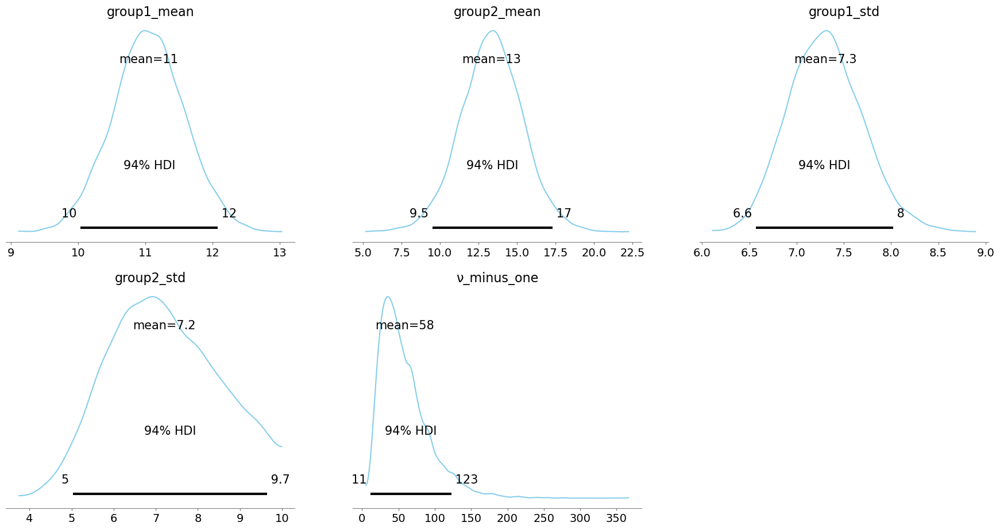

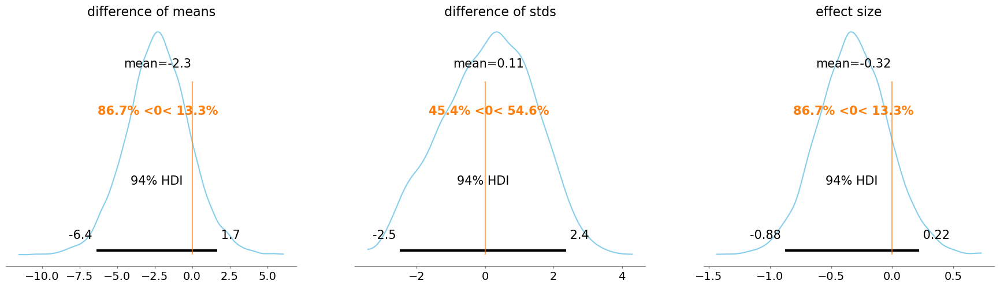

In [44]:
q = "PHQ - Total"
drug = newdfright[q]
placebo = newdfnw[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 202 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,-3.559,2.211,-7.805,0.496,0.027,0.021,6790.0,5173.0,1.0
difference of stds,-0.373,1.415,-3.202,2.019,0.020,0.019,4787.0,3955.0,1.0
effect size,-0.512,0.317,-1.108,0.063,0.004,0.003,6948.0,5155.0,1.0


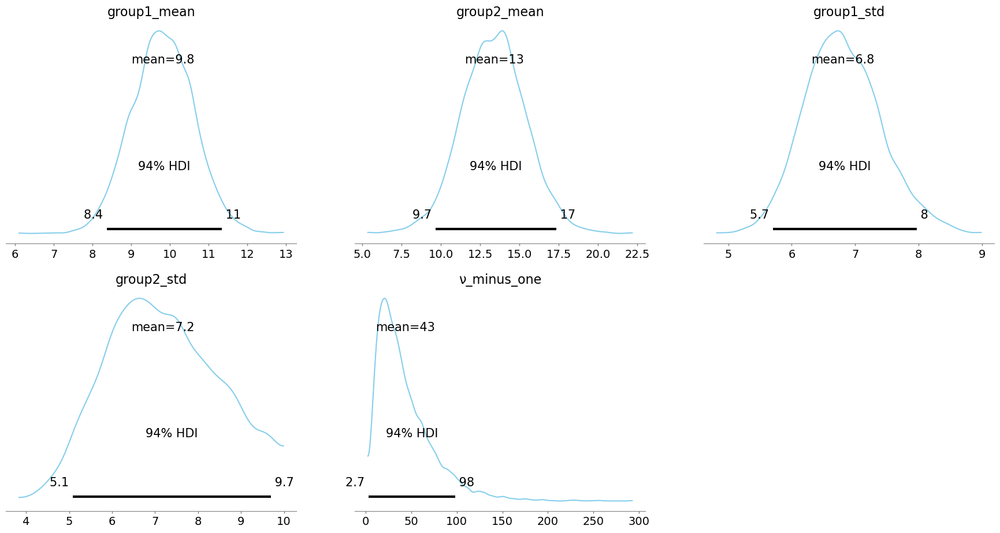

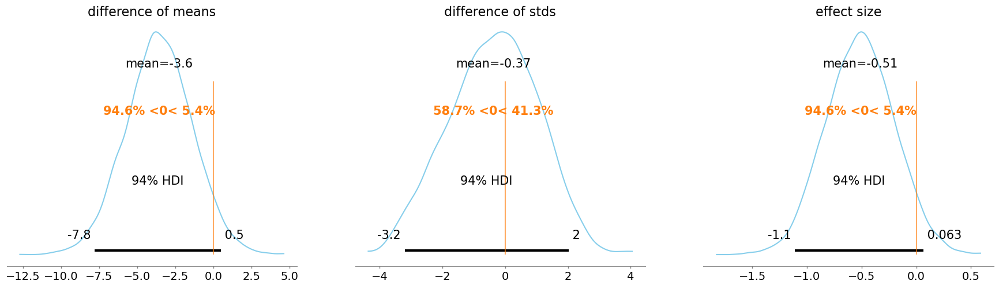

In [45]:
q = "PHQ - Total"
drug = newdfleft[q]
placebo = newdfnw[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 278 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,1.635,0.832,0.044,3.120,0.009,0.007,8580.0,6250.0,1.0
difference of stds,-0.045,0.603,-1.160,1.081,0.007,0.007,8650.0,5835.0,1.0
effect size,0.255,0.130,0.009,0.489,0.001,0.001,8656.0,6276.0,1.0


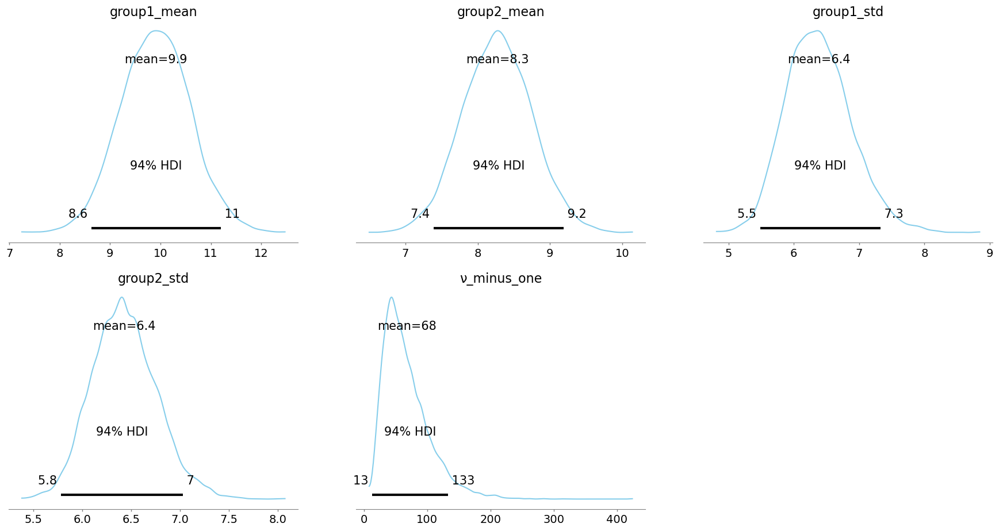

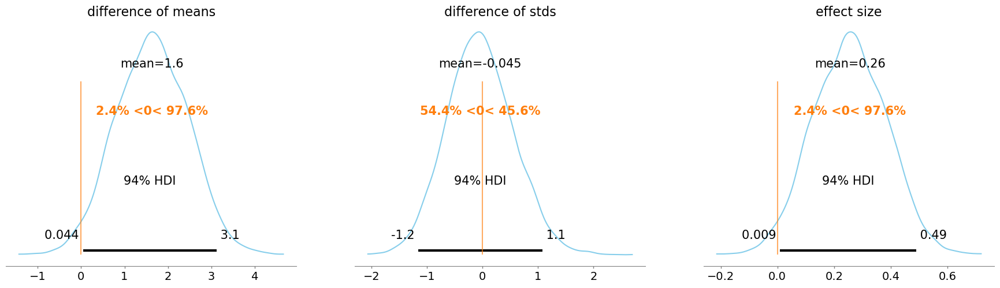

In [46]:
q = "GAD - Total"
drug = newdfne[q]
placebo = newdfright[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 210 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,1.959,0.986,0.200,3.900,0.011,0.008,7967.0,5961.0,1.0
difference of stds,0.248,0.721,-1.104,1.626,0.008,0.007,8928.0,5821.0,1.0
effect size,0.315,0.159,0.014,0.611,0.002,0.001,7934.0,6031.0,1.0


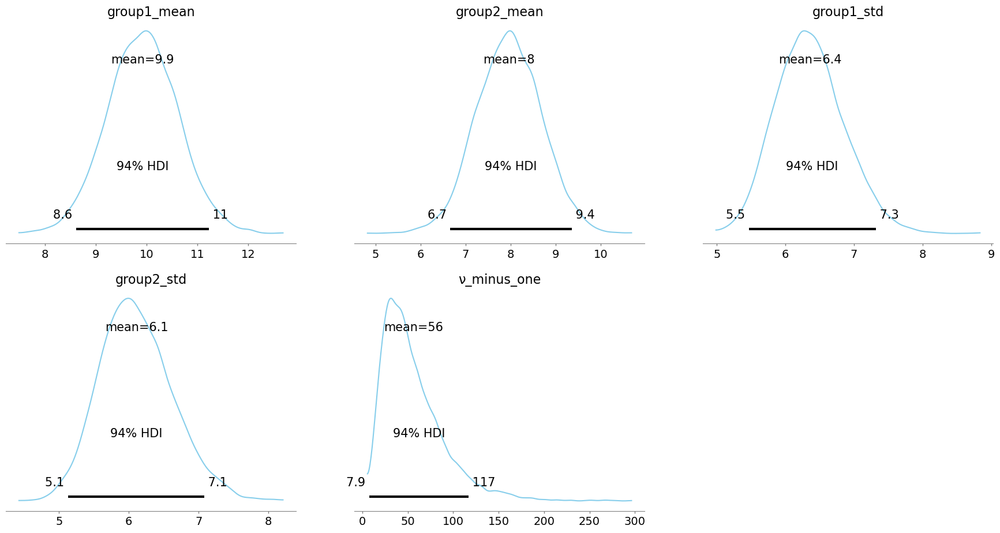

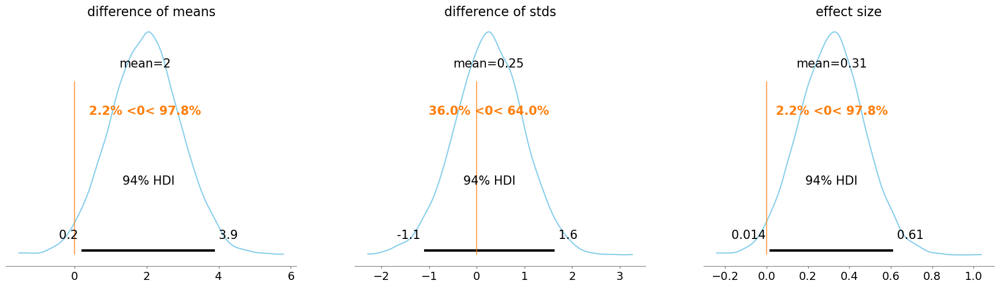

In [47]:
q = "GAD - Total"
drug = newdfne[q]
placebo = newdfleft[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 252 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,0.016,1.669,-3.271,3.109,0.019,0.019,7580.0,5240.0,1.0
difference of stds,1.055,1.295,-1.459,3.378,0.019,0.014,5380.0,3223.0,1.0
effect size,0.003,0.278,-0.531,0.529,0.003,0.003,7924.0,5563.0,1.0


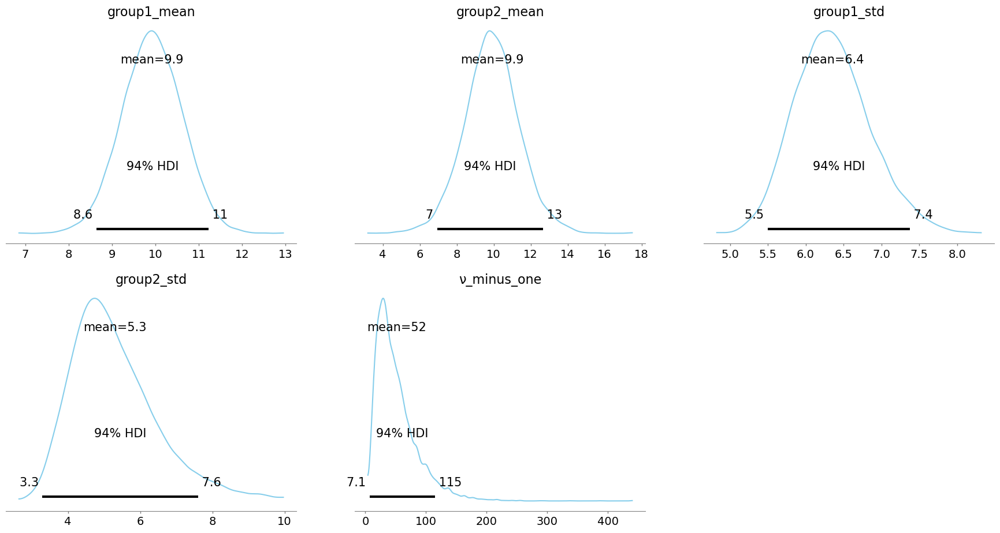

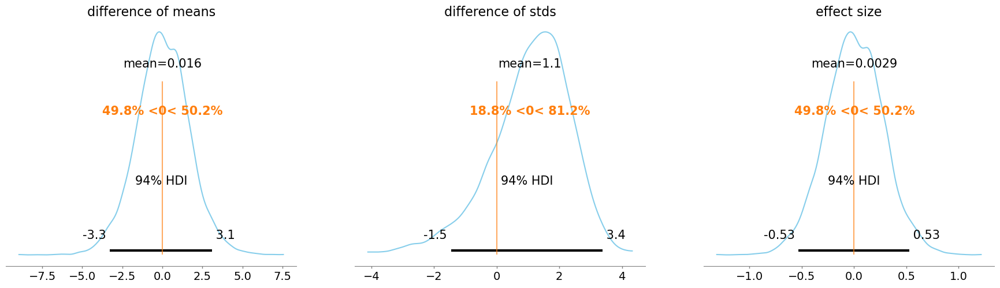

In [48]:
q = "GAD - Total"
drug = newdfne[q]
placebo = newdfnw[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 267 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,0.288,0.849,-1.295,1.874,0.009,0.009,9714.0,6232.0,1.0
difference of stds,0.296,0.613,-0.848,1.435,0.006,0.006,9950.0,6126.0,1.0
effect size,0.046,0.135,-0.212,0.289,0.001,0.001,9722.0,6122.0,1.0


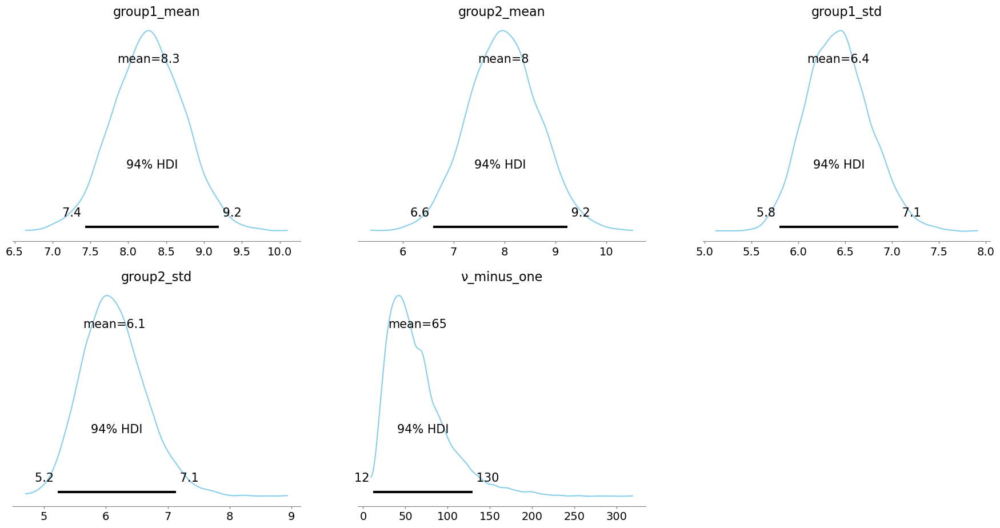

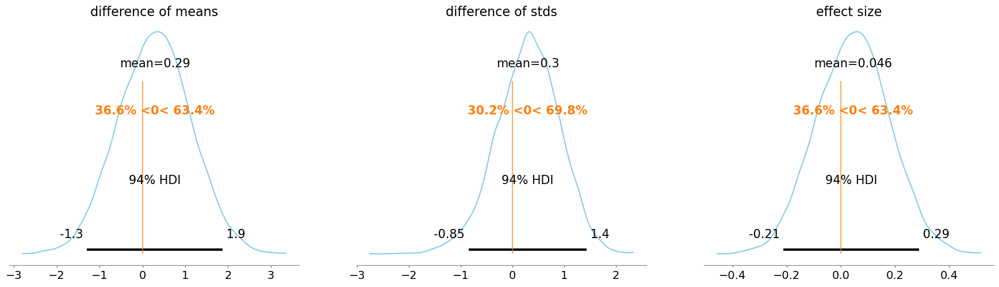

In [49]:
q = "GAD - Total"
drug = newdfright[q]
placebo = newdfleft[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 267 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,-1.589,1.610,-4.523,1.574,0.019,0.017,7647.0,5533.0,1.0
difference of stds,1.107,1.255,-1.403,3.133,0.020,0.014,5161.0,2745.0,1.0
effect size,-0.271,0.266,-0.795,0.216,0.003,0.002,8014.0,5742.0,1.0


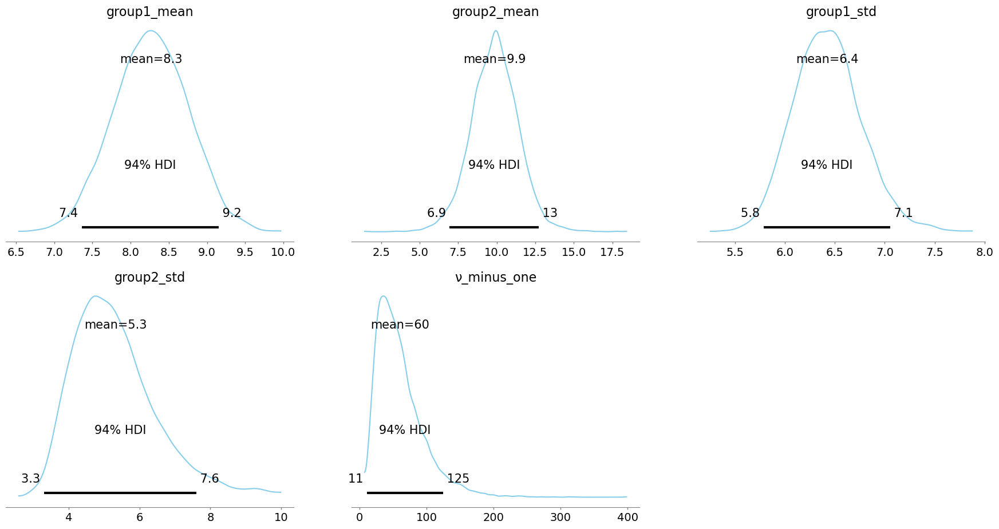

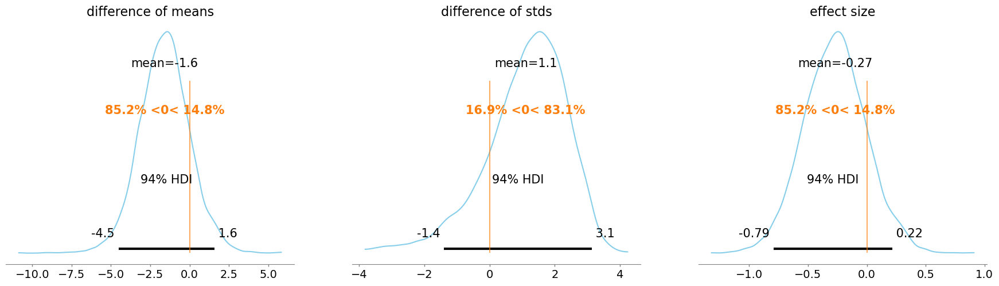

In [50]:
q = "GAD - Total"
drug = newdfright[q]
placebo = newdfnw[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 178 seconds.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
difference of means,-1.888,1.713,-5.068,1.419,0.020,0.016,7729.0,5654.0,1.0
difference of stds,0.751,1.320,-1.842,3.055,0.020,0.014,5237.0,2906.0,1.0
effect size,-0.333,0.296,-0.875,0.239,0.003,0.003,7880.0,6121.0,1.0


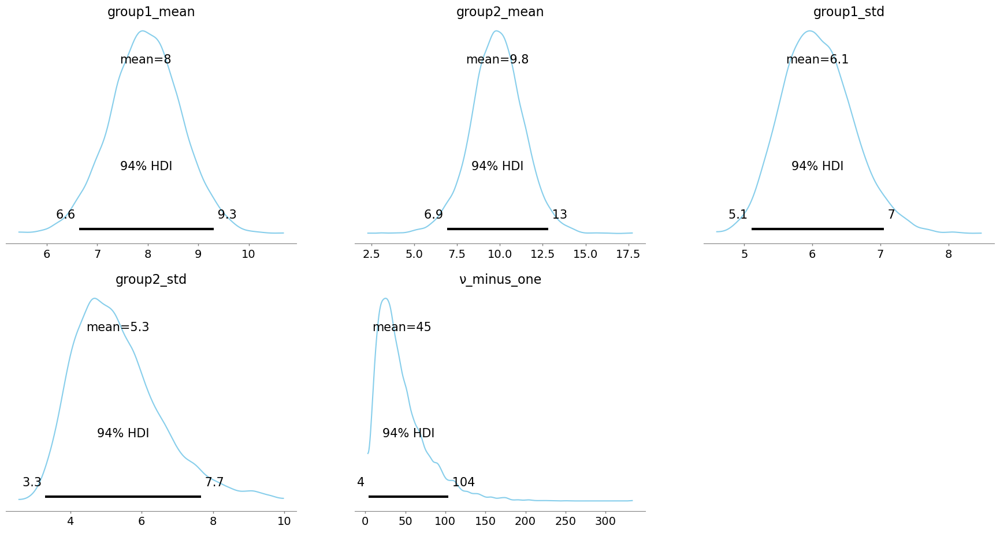

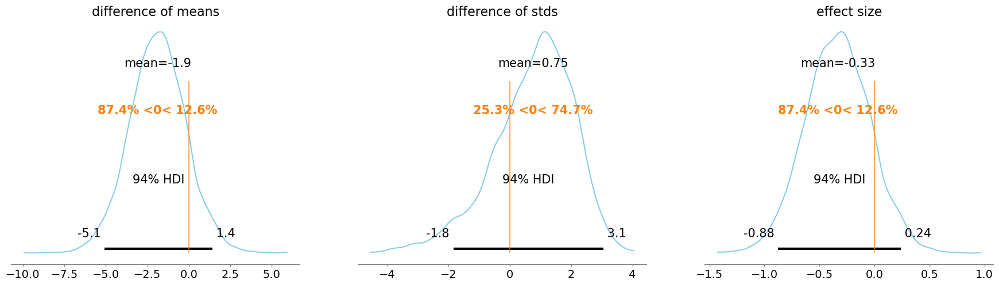

In [51]:
q = "GAD - Total"
drug = newdfleft[q]
placebo = newdfnw[q]

y1 = np.array(drug)
y2 = np.array(placebo)
y = pd.DataFrame(
    dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
)

μ_m = y.value.mean()
μ_s = y.value.std() * 2

with pm.Model() as model:
    group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
    group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)
    
σ_low = 1
σ_high = 10

with model:
    group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
    group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)
    
with model:
    ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

with model:
    λ1 = group1_std ** -2
    λ2 = group2_std ** -2

    group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
    group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)
    
with model:
    diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
    diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
    effect_size = pm.Deterministic(
        "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
    )
    
with model:
    trace = pm.sample(2000)
    
pm.plot_posterior(
    trace,
    var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
    color="#87ceeb",
);

pm.plot_posterior(
    trace,
    var_names=["difference of means", "difference of stds", "effect size"],
    ref_val=0,
    color="#87ceeb",
);

pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"])

PHQ - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 400 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.252  0.141  -0.024    0.507      0.002    0.001   
difference of stds   0.016  0.077  -0.125    0.165      0.001    0.001   
effect size          0.234  0.131  -0.013    0.480      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6229.0    4806.0    1.0  
difference of stds     5666.0    6183.0    1.0  
effect size            6273.0    4838.0    1.0  
PHQ - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 382 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.228  0.149  -0.047    0.510      0.002    0.001   
difference of stds   0.033  0.098  -0.136    0.231      0.001    0.001   
effect size          0.205  0.134  -0.046    0.453      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6441.0    5166.0    1.0  
difference of stds     5799.0    5808.0    1.0  
effect size            6598.0    5096.0    1.0  
PHQ - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 378 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.285  0.145   0.014    0.555      0.002    0.001   
difference of stds  -0.103  0.091  -0.274    0.071      0.001    0.001   
effect size          0.250  0.127   0.010    0.486      0.001    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7823.0    5187.0    1.0  
difference of stds     7555.0    6127.0    1.0  
effect size            7879.0    5114.0    1.0  
PHQ - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 386 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.146  0.145  -0.129    0.416      0.002    0.001   
difference of stds  -0.028  0.084  -0.183    0.135      0.001    0.001   
effect size          0.133  0.132  -0.128    0.369      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6868.0    4968.0    1.0  
difference of stds     5816.0    5937.0    1.0  
effect size            6971.0    5034.0    1.0  
PHQ - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 384 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.115  0.147  -0.155    0.395      0.002    0.002   
difference of stds   0.042  0.090  -0.115    0.224      0.001    0.001   
effect size          0.105  0.134  -0.136    0.363      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    5491.0    4935.0    1.0  
difference of stds     5002.0    5273.0    1.0  
effect size            5524.0    5101.0    1.0  
PHQ - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 356 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.175  0.158  -0.119    0.472      0.002    0.001   
difference of stds   0.050  0.114  -0.164    0.260      0.001    0.001   
effect size          0.147  0.132  -0.106    0.389      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7344.0    5386.0    1.0  
difference of stds     5807.0    3524.0    1.0  
effect size            7512.0    5483.0    1.0  
PHQ - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 605 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.322  0.148   0.059    0.608      0.002    0.001   
difference of stds  -0.032  0.095  -0.207    0.147      0.001    0.001   
effect size          0.286  0.132   0.053    0.541      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7260.0    5034.0    1.0  
difference of stds     5072.0    5895.0    1.0  
effect size            7433.0    5469.0    1.0  
PHQ - Q8


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 390 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.030  0.135  -0.210    0.296      0.002    0.001   
difference of stds   0.014  0.036  -0.053    0.088      0.000    0.000   
effect size          0.029  0.132  -0.209    0.284      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7644.0    6146.0    1.0  
difference of stds     7279.0    6243.0    1.0  
effect size            7690.0    6170.0    1.0  
PHQ - Q9


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 397 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.154  0.136  -0.101    0.408      0.002    0.001   
difference of stds   0.030  0.043  -0.037    0.117      0.000    0.000   
effect size          0.150  0.132  -0.094    0.400      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7088.0    5407.0    1.0  
difference of stds     6894.0    6042.0    1.0  
effect size            7129.0    5335.0    1.0  
GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 410 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.235  0.144  -0.034    0.504      0.002    0.001   
difference of stds  -0.021  0.082  -0.175    0.136      0.001    0.001   
effect size          0.216  0.132  -0.032    0.461      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6510.0    5240.0    1.0  
difference of stds     5686.0    6042.0    1.0  
effect size            6557.0    5292.0    1.0  
GAD - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 369 seconds.
C:\Users\mltlachac\Anaconda3\lib\site-packages\arviz\plots\backends\matplotlib\__init__.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = subplots(rows, cols, **backend_kwargs)


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.256  0.145  -0.023    0.521      0.002    0.001   
difference of stds  -0.007  0.098  -0.191    0.177      0.001    0.001   
effect size          0.226  0.128  -0.020    0.456      0.001    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7265.0    5388.0    1.0  
difference of stds     5343.0    5950.0    1.0  
effect size            7315.0    5259.0    1.0  
GAD - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 395 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.174  0.152  -0.099    0.473      0.002    0.001   
difference of stds   0.026  0.104  -0.162    0.226      0.001    0.001   
effect size          0.152  0.132  -0.088    0.408      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7262.0    5579.0    1.0  
difference of stds     5724.0    5277.0    1.0  
effect size            7345.0    5684.0    1.0  
GAD - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 363 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.321  0.144   0.060    0.594      0.002    0.001   
difference of stds  -0.032  0.083  -0.181    0.133      0.001    0.001   
effect size          0.292  0.131   0.054    0.539      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7025.0    5205.0    1.0  
difference of stds     5430.0    5853.0    1.0  
effect size            7033.0    5378.0    1.0  
GAD - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 409 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.215  0.145  -0.064    0.482      0.002    0.001   
difference of stds   0.044  0.082  -0.104    0.201      0.001    0.001   
effect size          0.199  0.134  -0.041    0.464      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7682.0    5360.0    1.0  
difference of stds     6638.0    6527.0    1.0  
effect size            7796.0    5378.0    1.0  
GAD - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 420 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.179  0.146  -0.095    0.446      0.002    0.002   
difference of stds   0.039  0.087  -0.123    0.201      0.001    0.001   
effect size          0.164  0.133  -0.096    0.398      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6013.0    3612.0    1.0  
difference of stds     5357.0    4684.0    1.0  
effect size            6111.0    4087.0    1.0  
GAD - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 400 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.254  0.143  -0.022    0.517      0.002    0.001   
difference of stds   0.046  0.083  -0.103    0.209      0.001    0.001   
effect size          0.234  0.132  -0.026    0.470      0.001    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7933.0    5519.0    1.0  
difference of stds     6099.0    5724.0    1.0  
effect size            8079.0    5725.0    1.0  


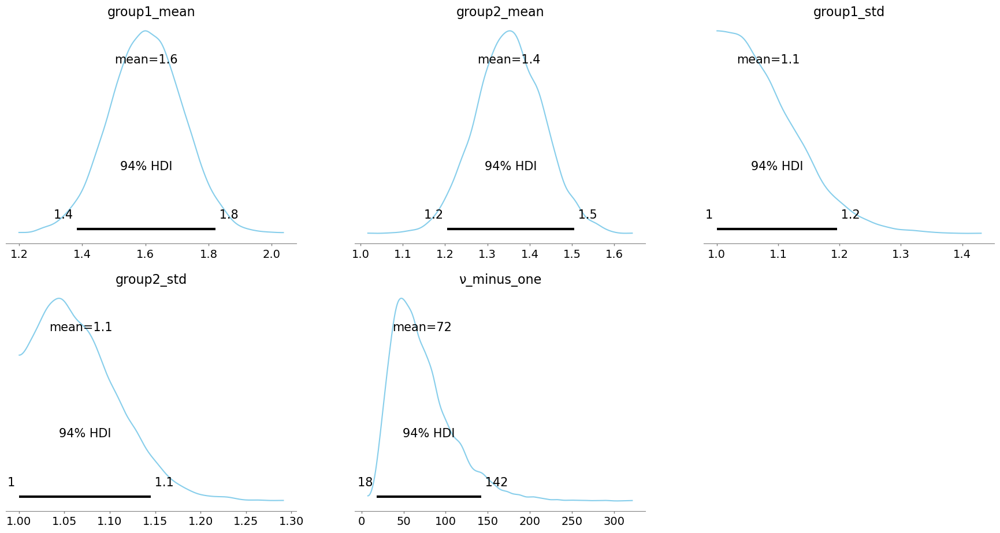

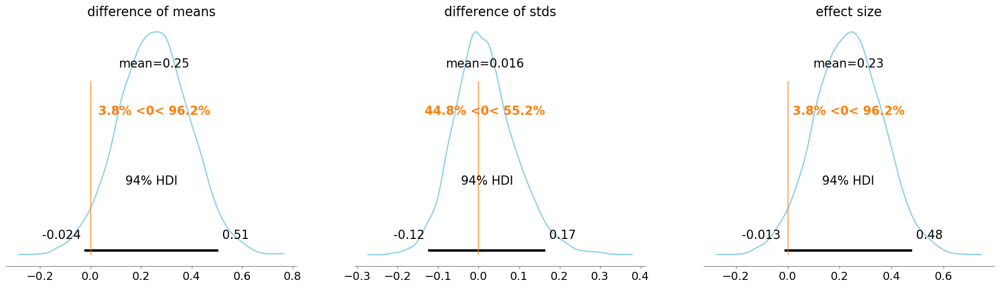

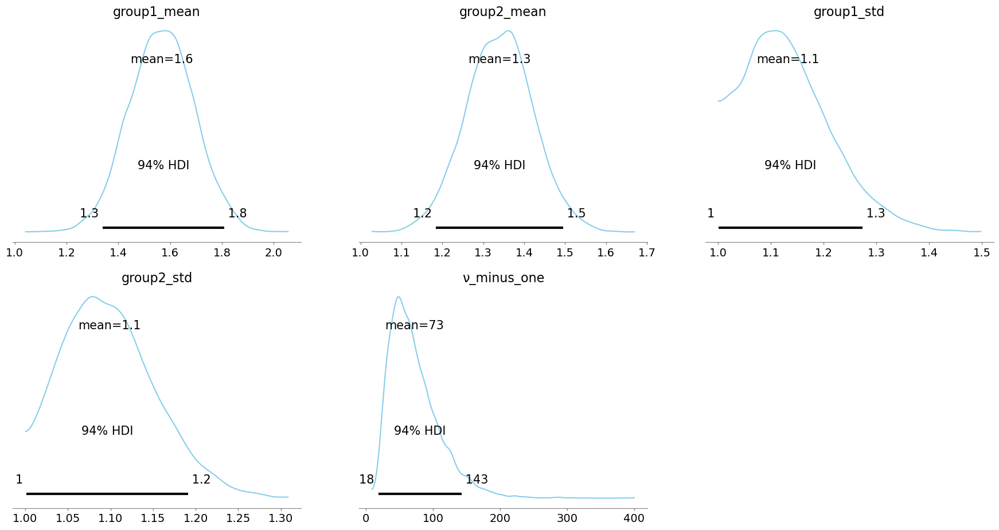

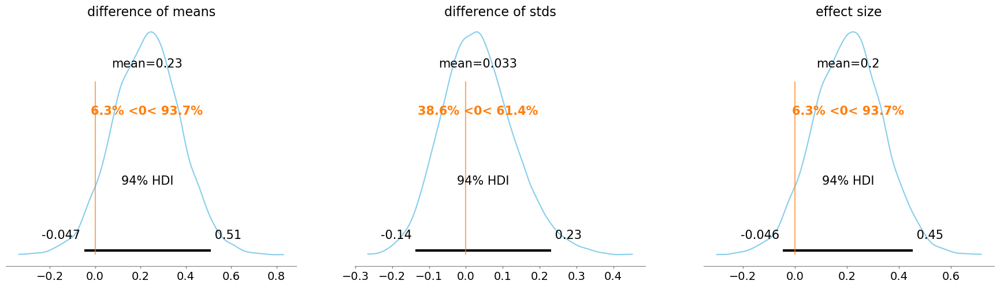

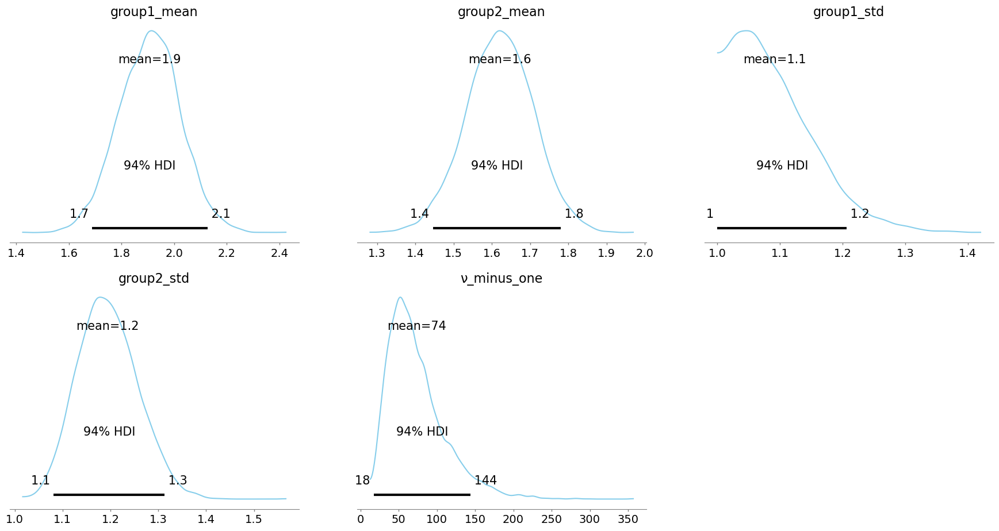

...

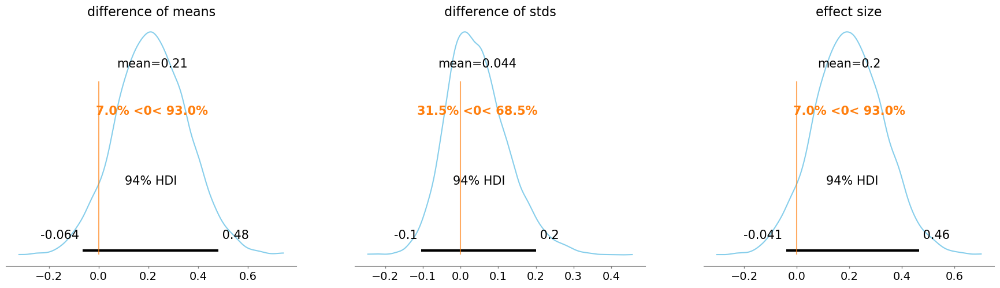

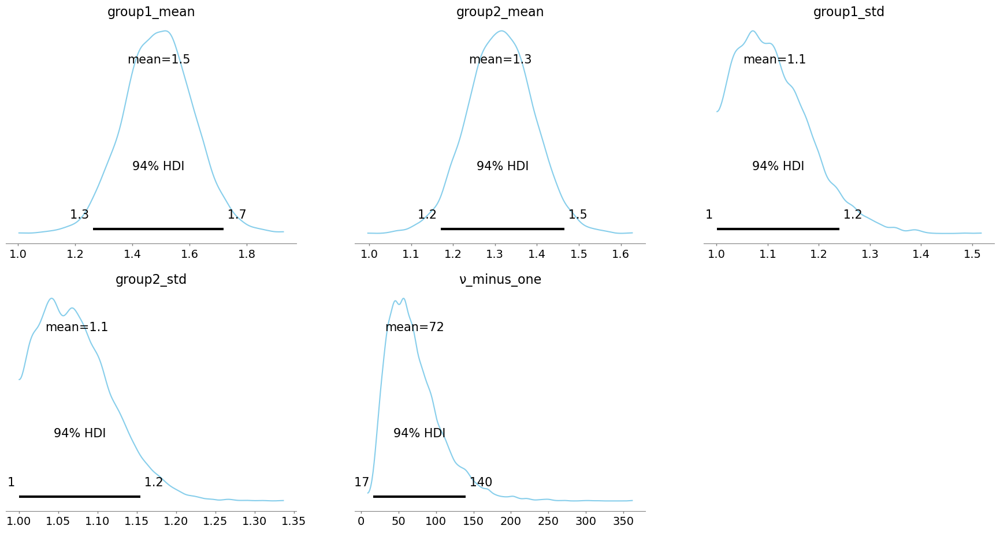

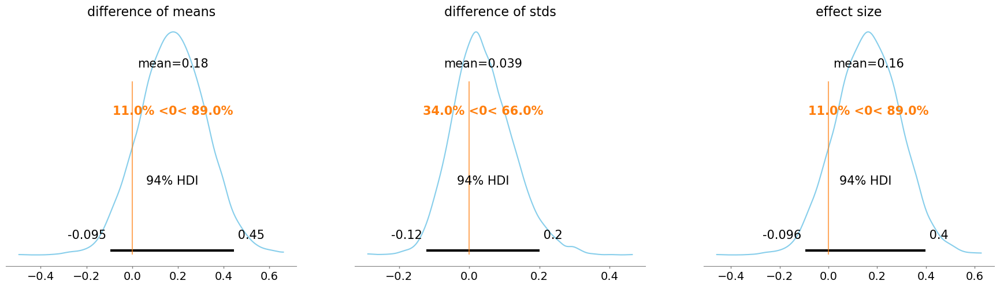

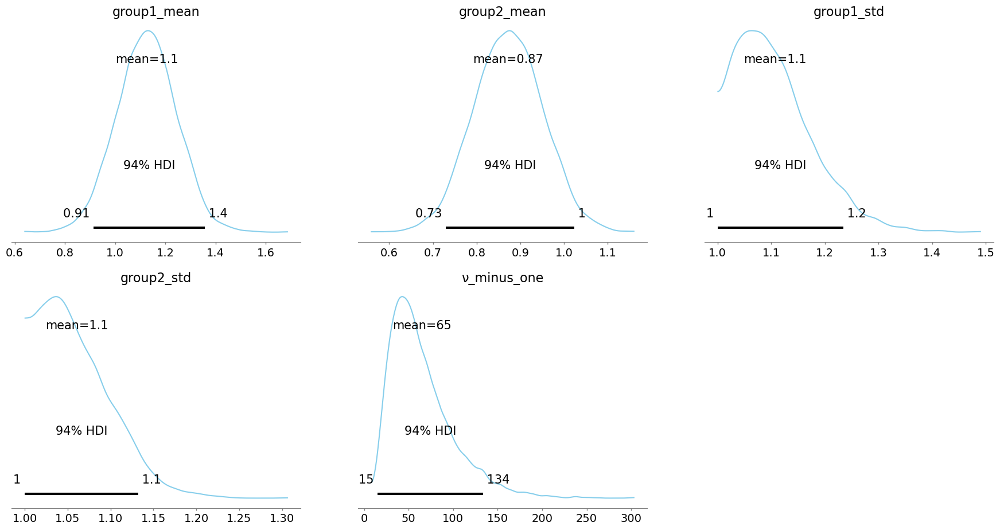

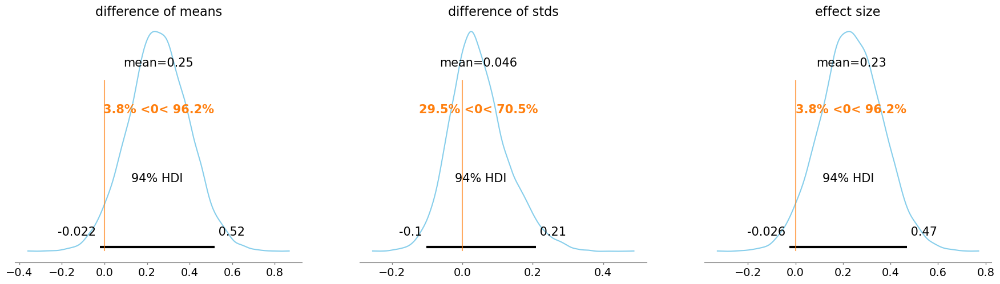

In [55]:
#q = "PHQ - Total"
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfne[q]
    placebo = newdfright[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

PHQ - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 267 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.403  0.167   0.080    0.707      0.002    0.001   
difference of stds   0.024  0.081  -0.135    0.175      0.001    0.001   
effect size          0.376  0.157   0.087    0.675      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6957.0    5468.0    1.0  
difference of stds     6771.0    6446.0    1.0  
effect size            7137.0    5276.0    1.0  
PHQ - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 273 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.362  0.175   0.026    0.679      0.002    0.002   
difference of stds   0.064  0.100  -0.125    0.255      0.001    0.001   
effect size          0.329  0.159   0.028    0.620      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6524.0    4795.0    1.0  
difference of stds     6616.0    5670.0    1.0  
effect size            6675.0    4810.0    1.0  
PHQ - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 283 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.282  0.180  -0.035    0.641      0.002    0.002   
difference of stds  -0.096  0.113  -0.307    0.113      0.001    0.001   
effect size          0.248  0.158  -0.034    0.557      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    5875.0    5236.0    1.0  
difference of stds     6504.0    5659.0    1.0  
effect size            5989.0    5219.0    1.0  
PHQ - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 265 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.285  0.174  -0.029    0.620      0.002    0.002   
difference of stds  -0.023  0.098  -0.224    0.148      0.001    0.001   
effect size          0.261  0.159  -0.028    0.569      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6688.0    5079.0    1.0  
difference of stds     6097.0    5990.0    1.0  
effect size            6784.0    5298.0    1.0  
PHQ - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 264 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.441  0.178   0.102    0.767      0.002    0.002   
difference of stds   0.002  0.107  -0.202    0.207      0.001    0.001   
effect size          0.395  0.160   0.093    0.687      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    6748.0    4947.0    1.0  
difference of stds     6285.0    5640.0    1.0  
effect size            6861.0    5114.0    1.0  
PHQ - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 270 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.386  0.184   0.044    0.733      0.002    0.002   
difference of stds   0.130  0.112  -0.084    0.338      0.001    0.001   
effect size          0.336  0.160   0.035    0.635      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6995.0    5468.0    1.0  
difference of stds     6697.0    5775.0    1.0  
effect size            7148.0    5710.0    1.0  
PHQ - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 282 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.456  0.171   0.142    0.777      0.002    0.001   
difference of stds   0.028  0.098  -0.165    0.209      0.001    0.001   
effect size          0.415  0.157   0.124    0.704      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7308.0    5922.0    1.0  
difference of stds     6618.0    6542.0    1.0  
effect size            7293.0    5892.0    1.0  
PHQ - Q8


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 263 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.122  0.159  -0.180    0.412      0.002    0.001   
difference of stds   0.003  0.044  -0.078    0.095      0.001    0.000   
effect size          0.118  0.154  -0.173    0.398      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7497.0    6251.0    1.0  
difference of stds     7369.0    6046.0    1.0  
effect size            7548.0    6232.0    1.0  
PHQ - Q9


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 284 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.163  0.163  -0.156    0.455      0.002    0.002   
difference of stds   0.003  0.055  -0.104    0.111      0.001    0.001   
effect size          0.156  0.156  -0.144    0.441      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    9271.0    5063.0    1.0  
difference of stds     8179.0    6261.0    1.0  
effect size            9399.0    5367.0    1.0  
GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 280 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.260  0.169  -0.071    0.563      0.002    0.002   
difference of stds  -0.010  0.093  -0.193    0.165      0.001    0.001   
effect size          0.239  0.156  -0.057    0.528      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    6230.0    4655.0    1.0  
difference of stds     6453.0    5956.0    1.0  
effect size            6255.0    4805.0    1.0  
GAD - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 279 seconds.
C:\Users\mltlachac\Anaconda3\lib\site-packages\arviz\plots\backends\matplotlib\__init__.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = subplots(rows, cols, **backend_kwargs)


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.339  0.176   0.010    0.674      0.002    0.002   
difference of stds   0.063  0.098  -0.121    0.248      0.001    0.001   
effect size          0.308  0.160  -0.009    0.595      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7904.0    4697.0    1.0  
difference of stds     6399.0    5884.0    1.0  
effect size            8068.0    5238.0    1.0  
GAD - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 300 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.183  0.184  -0.163    0.525      0.002    0.002   
difference of stds   0.019  0.120  -0.212    0.239      0.002    0.001   
effect size          0.159  0.159  -0.146    0.451      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    6686.0    5025.0    1.0  
difference of stds     6220.0    5664.0    1.0  
effect size            6801.0    4948.0    1.0  
GAD - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 261 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.345  0.178   0.007    0.674      0.002    0.002   
difference of stds  -0.039  0.103  -0.231    0.161      0.001    0.001   
effect size          0.313  0.162   0.009    0.620      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6788.0    5026.0    1.0  
difference of stds     5639.0    6420.0    1.0  
effect size            6811.0    4975.0    1.0  
GAD - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 262 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.376  0.172   0.043    0.693      0.002    0.001   
difference of stds   0.024  0.094  -0.145    0.218      0.001    0.001   
effect size          0.346  0.158   0.037    0.635      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7179.0    5304.0    1.0  
difference of stds     7453.0    5817.0    1.0  
effect size            7298.0    5358.0    1.0  
GAD - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 271 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.292  0.169  -0.034    0.595      0.002    0.001   
difference of stds   0.042  0.092  -0.124    0.224      0.001    0.001   
effect size          0.268  0.156  -0.023    0.554      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7230.0    5292.0    1.0  
difference of stds     5840.0    5724.0    1.0  
effect size            7325.0    5768.0    1.0  
GAD - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 270 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.141  0.179  -0.182    0.486      0.002    0.002   
difference of stds  -0.034  0.112  -0.250    0.175      0.001    0.001   
effect size          0.126  0.160  -0.165    0.433      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    8413.0    4837.0    1.0  
difference of stds     5453.0    5909.0    1.0  
effect size            8590.0    5745.0    1.0  


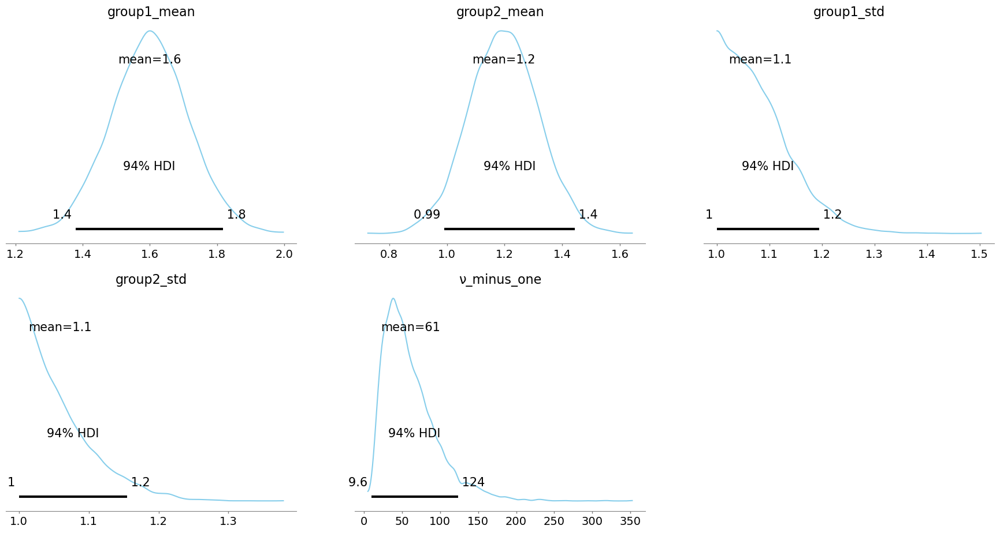

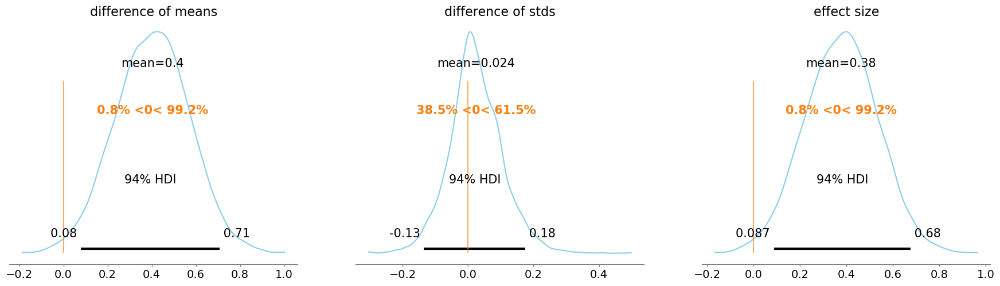

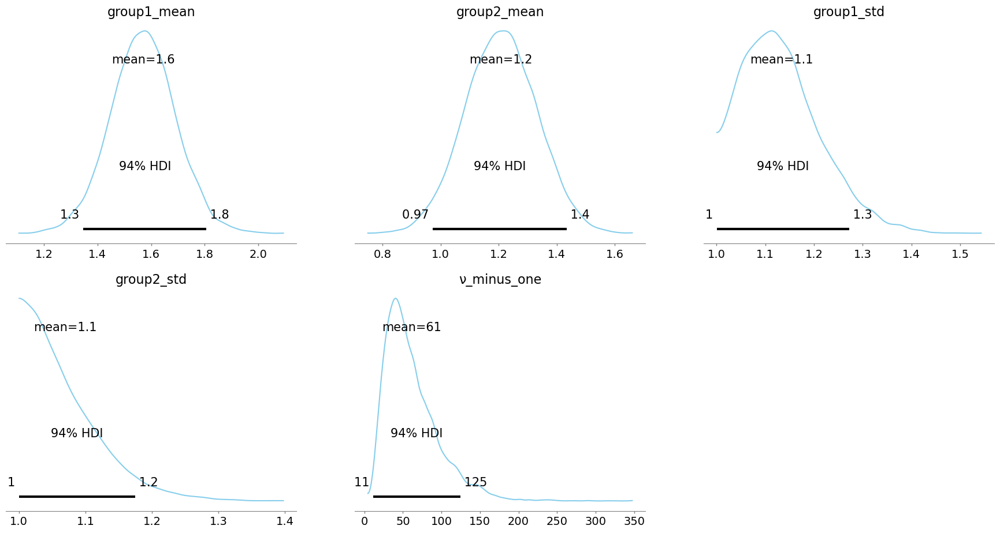

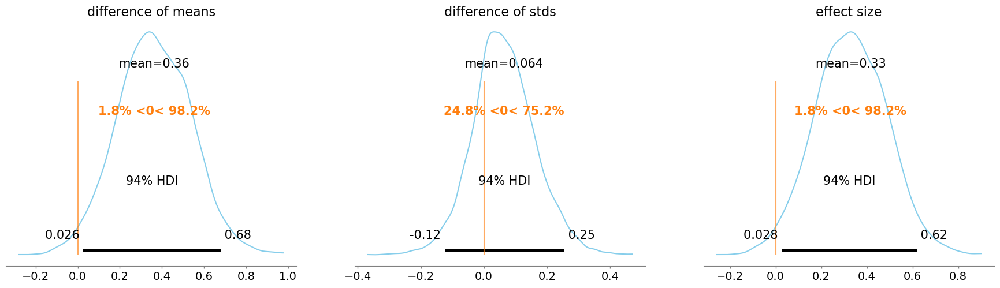

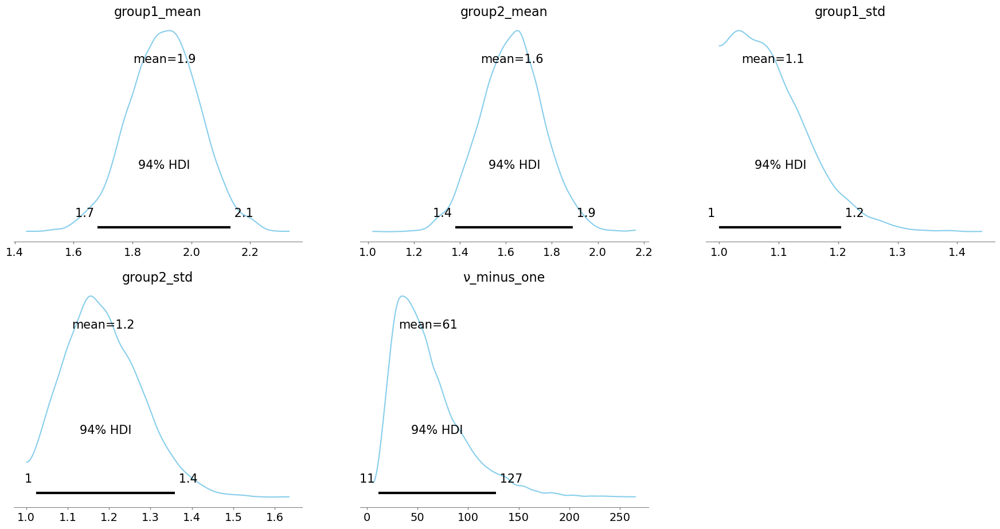

...

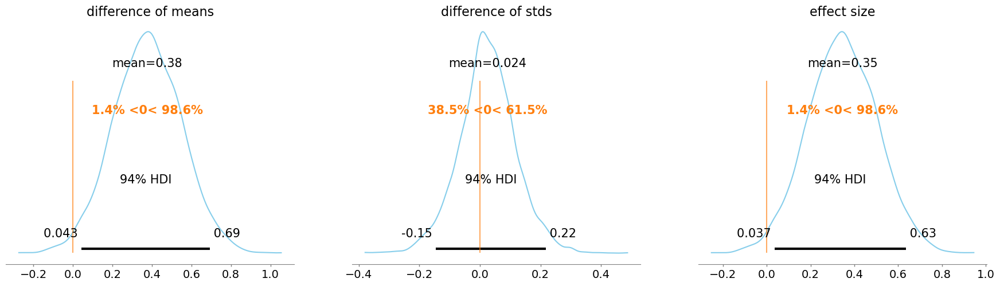

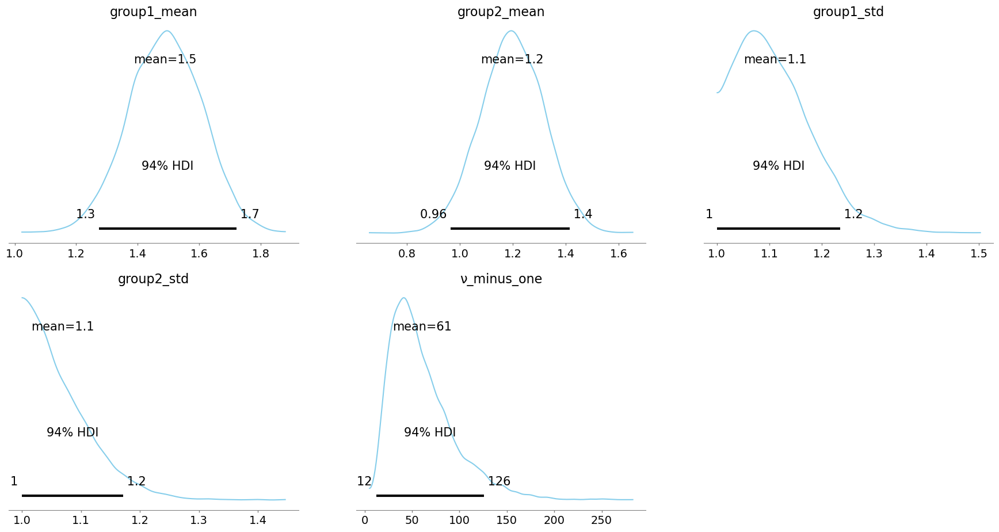

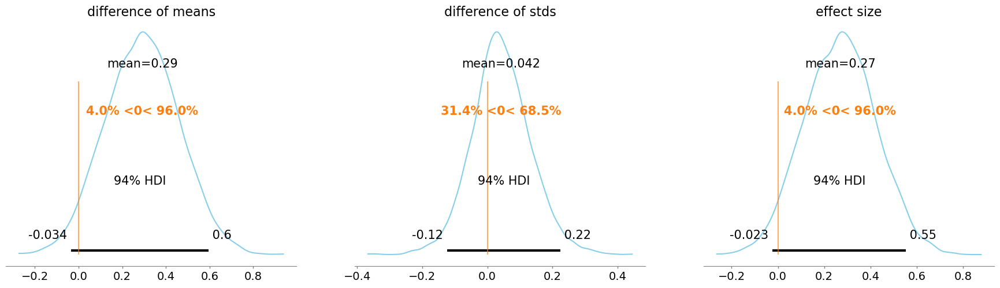

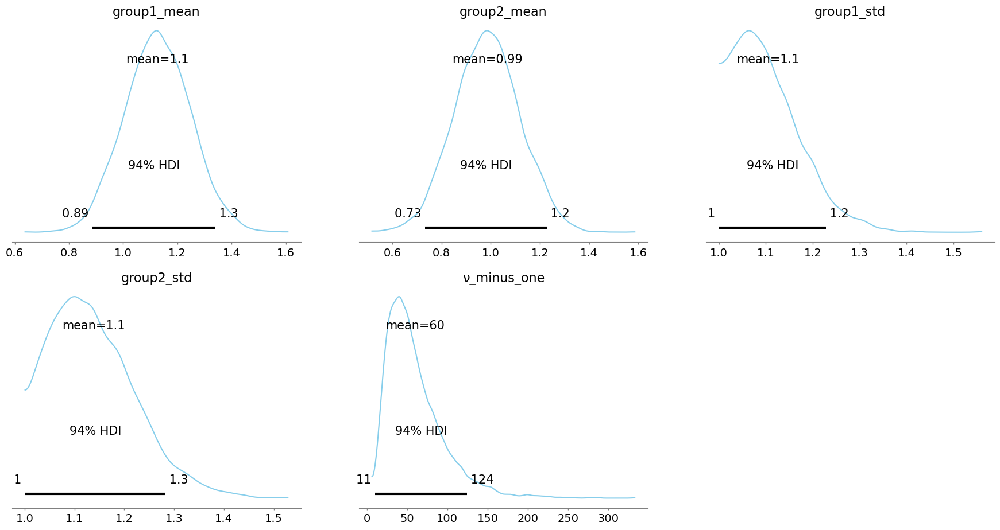

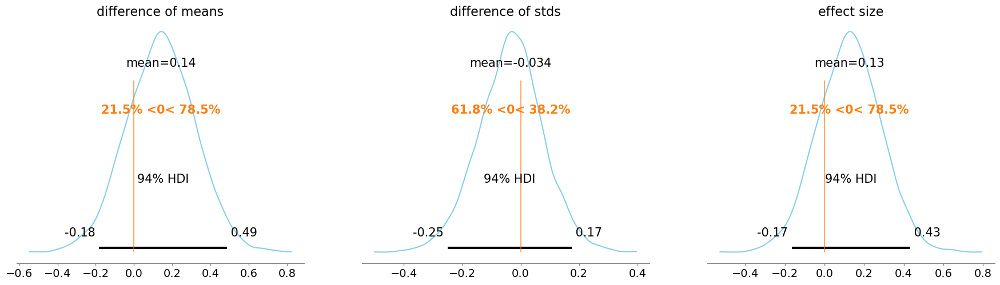

In [54]:
#q = "PHQ - Total"
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfne[q]
    placebo = newdfleft[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

PHQ - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 206 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.294  0.379  -0.431    0.995      0.005    0.004   
difference of stds  -0.198  0.256  -0.677    0.172      0.003    0.002   
effect size          0.250  0.315  -0.372    0.808      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6686.0    5069.0    1.0  
difference of stds     6059.0    5482.0    1.0  
effect size            7161.0    5567.0    1.0  
PHQ - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 193 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.181  0.360  -0.472    0.873      0.005    0.004   
difference of stds  -0.069  0.212  -0.470    0.271      0.003    0.002   
effect size          0.156  0.305  -0.401    0.730      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6295.0    4958.0    1.0  
difference of stds     6470.0    5983.0    1.0  
effect size            6575.0    5323.0    1.0  
PHQ - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 199 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.077  0.347  -0.709    0.599      0.004    0.004   
difference of stds  -0.100  0.195  -0.473    0.202      0.002    0.002   
effect size         -0.069  0.302  -0.649    0.493      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6895.0    5006.0    1.0  
difference of stds     6806.0    5639.0    1.0  
effect size            7221.0    5371.0    1.0  
PHQ - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 203 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.140  0.344  -0.799    0.498      0.004    0.004   
difference of stds  -0.104  0.194  -0.472    0.187      0.002    0.002   
effect size         -0.123  0.299  -0.672    0.463      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6568.0    4952.0    1.0  
difference of stds     7031.0    6128.0    1.0  
effect size            6867.0    5263.0    1.0  
PHQ - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 228 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.020  0.380  -0.698    0.730      0.005    0.005   
difference of stds  -0.166  0.259  -0.673    0.213      0.003    0.002   
effect size          0.018  0.310  -0.574    0.588      0.004    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    6335.0    5237.0    1.0  
difference of stds     5545.0    6033.0    1.0  
effect size            6748.0    5444.0    1.0  
PHQ - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 180 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.059  0.439  -0.897    0.784      0.005    0.005   
difference of stds  -0.279  0.348  -0.950    0.278      0.004    0.003   
effect size         -0.044  0.315  -0.629    0.553      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7851.0    5784.0    1.0  
difference of stds     5808.0    4096.0    1.0  
effect size            8433.0    6389.0    1.0  
PHQ - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 208 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.063  0.367  -0.783    0.619      0.005    0.004   
difference of stds  -0.125  0.236  -0.566    0.239      0.003    0.002   
effect size         -0.053  0.307  -0.612    0.560      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6296.0    4892.0    1.0  
difference of stds     6706.0    5934.0    1.0  
effect size            6748.0    5180.0    1.0  
PHQ - Q8


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 200 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.387  0.367  -1.085    0.298      0.005    0.004   
difference of stds  -0.247  0.249  -0.714    0.080      0.003    0.002   
effect size         -0.336  0.312  -0.929    0.256      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6280.0    5140.0    1.0  
difference of stds     6375.0    5309.0    1.0  
effect size            6609.0    5344.0    1.0  
PHQ - Q9


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 203 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.369  0.360  -1.029    0.321      0.005    0.004   
difference of stds  -0.176  0.213  -0.572    0.123      0.002    0.002   
effect size         -0.327  0.314  -0.884    0.287      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6395.0    5103.0    1.0  
difference of stds     6249.0    5768.0    1.0  
effect size            6903.0    5375.0    1.0  
GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 214 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.048  0.357  -0.726    0.628      0.004    0.004   
difference of stds  -0.153  0.220  -0.558    0.189      0.003    0.002   
effect size         -0.042  0.304  -0.598    0.547      0.004    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    6718.0    5169.0    1.0  
difference of stds     6444.0    5736.0    1.0  
effect size            7192.0    5404.0    1.0  
GAD - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 189 seconds.
C:\Users\mltlachac\Anaconda3\lib\site-packages\arviz\plots\backends\matplotlib\__init__.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = subplots(rows, cols, **backend_kwargs)


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.254  0.348  -0.388    0.908      0.004    0.004   
difference of stds  -0.051  0.202  -0.416    0.260      0.002    0.002   
effect size          0.221  0.298  -0.334    0.774      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6656.0    5083.0    1.0  
difference of stds     6731.0    6302.0    1.0  
effect size            7015.0    5306.0    1.0  
GAD - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 192 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.101  0.347  -0.762    0.540      0.004    0.004   
difference of stds   0.007  0.183  -0.342    0.311      0.002    0.002   
effect size         -0.088  0.297  -0.650    0.464      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7516.0    4518.0    1.0  
difference of stds     8251.0    6813.0    1.0  
effect size            7748.0    5202.0    1.0  
GAD - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 191 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.053  0.355  -0.615    0.697      0.005    0.004   
difference of stds  -0.119  0.207  -0.537    0.177      0.002    0.002   
effect size          0.047  0.304  -0.534    0.588      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6017.0    4810.0    1.0  
difference of stds     6653.0    5934.0    1.0  
effect size            6411.0    5316.0    1.0  
GAD - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 218 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.041  0.349  -0.623    0.678      0.005    0.004   
difference of stds  -0.087  0.202  -0.478    0.227      0.002    0.002   
effect size          0.035  0.300  -0.543    0.584      0.004    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    5486.0    4571.0    1.0  
difference of stds     6613.0    6082.0    1.0  
effect size            5746.0    4916.0    1.0  
GAD - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 213 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.114  0.362  -0.817    0.549      0.004    0.004   
difference of stds  -0.128  0.234  -0.576    0.209      0.003    0.002   
effect size         -0.098  0.303  -0.656    0.485      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7065.0    5733.0    1.0  
difference of stds     6154.0    5864.0    1.0  
effect size            7252.0    5820.0    1.0  
GAD - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 214 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.020  0.365  -0.691    0.690      0.005    0.004   
difference of stds  -0.111  0.222  -0.529    0.223      0.003    0.002   
effect size         -0.018  0.310  -0.628    0.551      0.004    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    5968.0    4791.0    1.0  
difference of stds     6352.0    5566.0    1.0  
effect size            6246.0    5004.0    1.0  


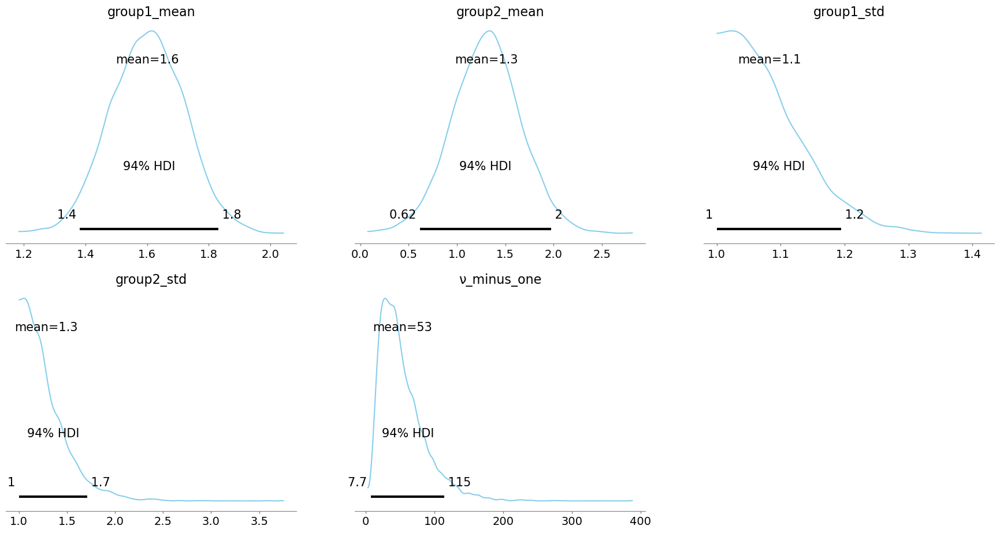

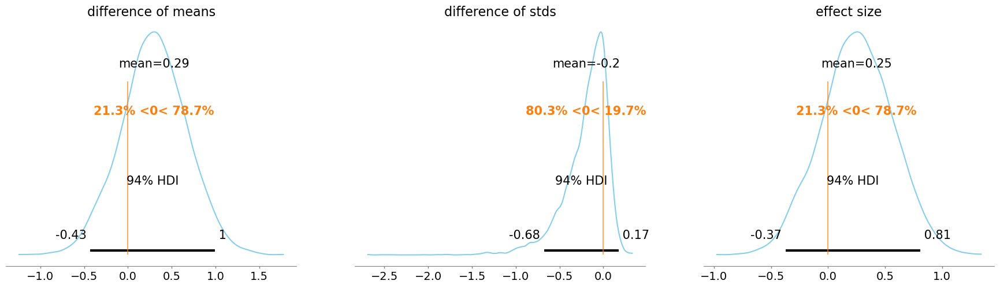

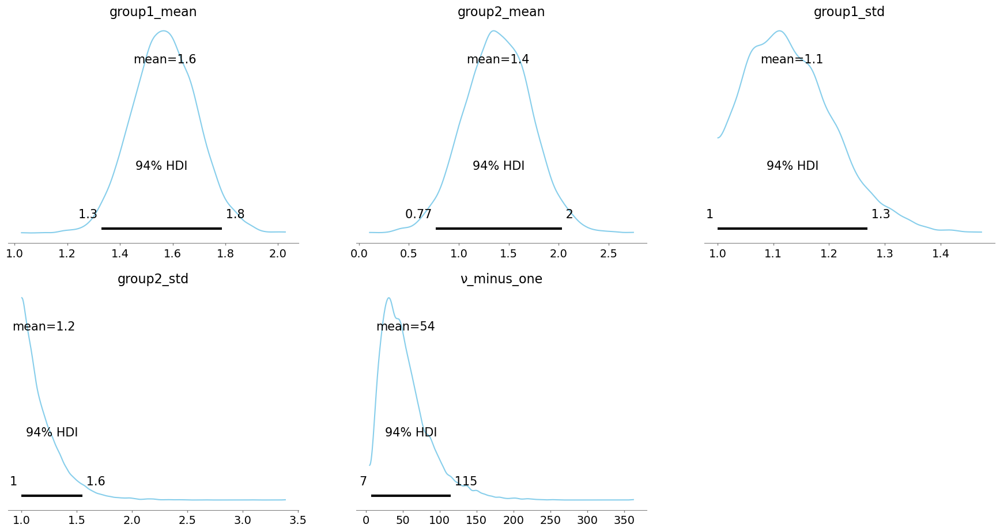

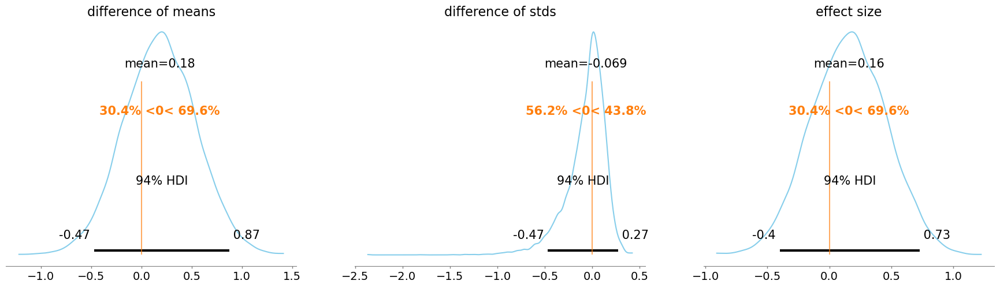

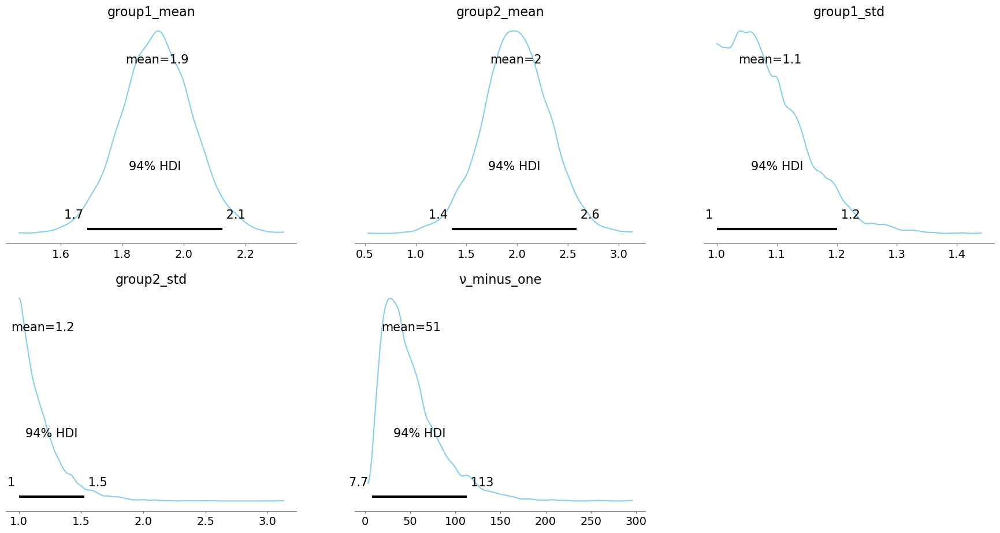

...

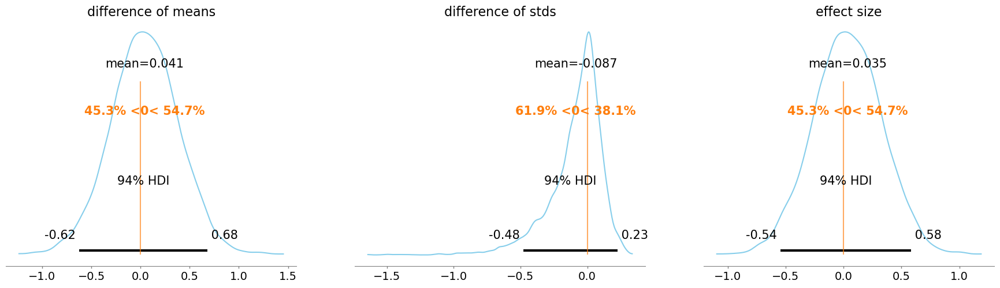

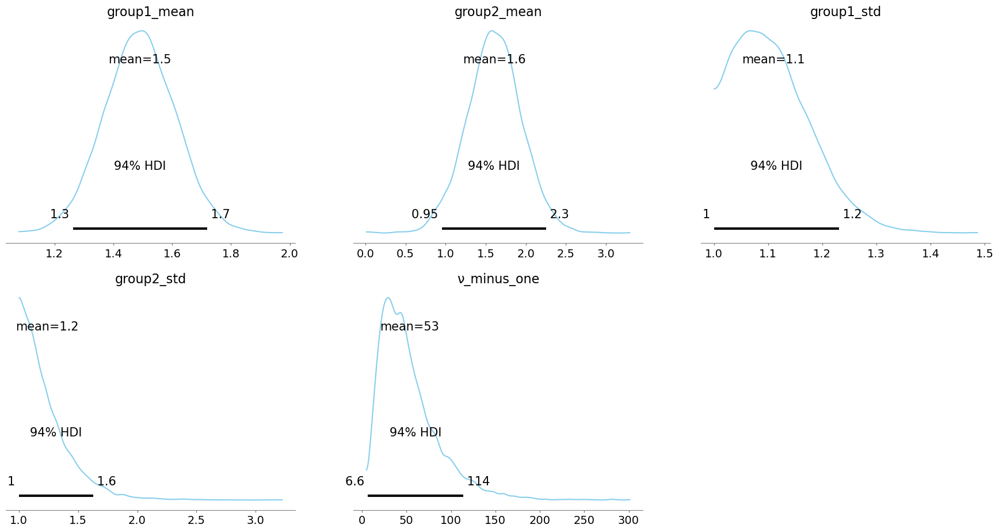

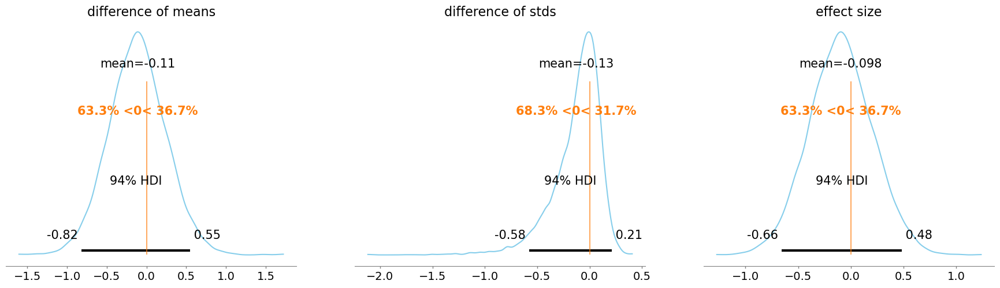

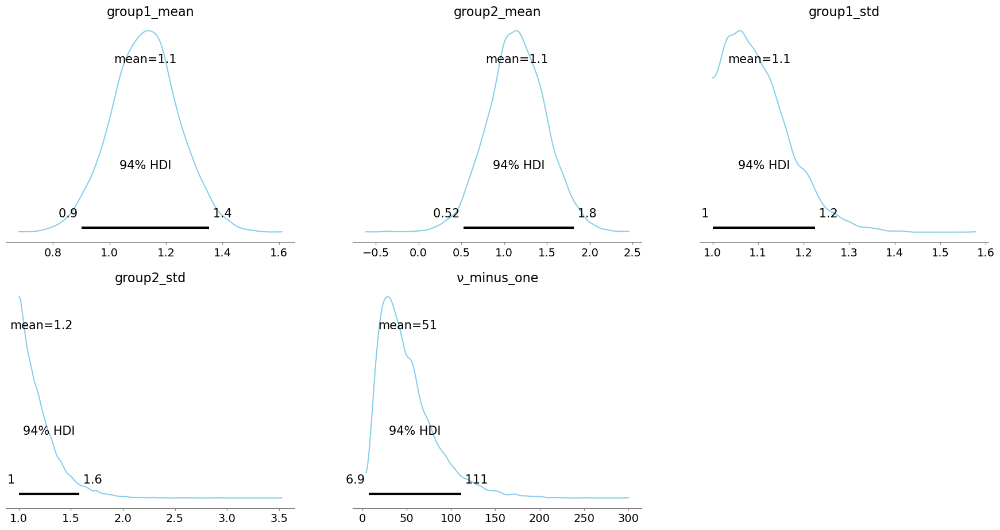

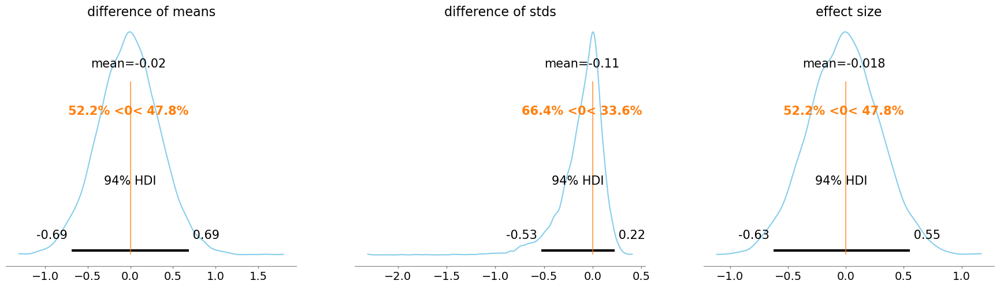

In [56]:
#q = "PHQ - Total"
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfne[q]
    placebo = newdfnw[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

In [57]:
#q = "PHQ - Total"
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfright[q]
    placebo = newdfleft[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

PHQ - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 394 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.151  0.146  -0.111    0.437      0.002    0.001   
difference of stds   0.005  0.069  -0.122    0.140      0.001    0.001   
effect size          0.142  0.137  -0.108    0.403      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6528.0    4983.0    1.0  
difference of stds     6254.0    5864.0    1.0  
effect size            6579.0    4844.0    1.0  
PHQ - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 385 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.129  0.146  -0.138    0.410      0.002    0.001   
difference of stds   0.028  0.078  -0.121    0.171      0.001    0.001   
effect size          0.119  0.135  -0.130    0.373      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7001.0    5735.0    1.0  
difference of stds     5323.0    6245.0    1.0  
effect size            7097.0    5671.0    1.0  
PHQ - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 346 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.001  0.161  -0.311    0.291      0.002    0.002   
difference of stds   0.009  0.115  -0.198    0.228      0.002    0.001   
effect size         -0.001  0.135  -0.264    0.241      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    7777.0    5544.0    1.0  
difference of stds     4887.0    5125.0    1.0  
effect size            7972.0    5828.0    1.0  
PHQ - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 467 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.142  0.153  -0.142    0.435      0.002    0.002   
difference of stds   0.003  0.093  -0.181    0.169      0.001    0.001   
effect size          0.128  0.138  -0.135    0.384      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    5103.0    4261.0    1.0  
difference of stds     5296.0    5111.0    1.0  
effect size            5189.0    4521.0    1.0  
PHQ - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 404 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.317  0.156   0.035    0.615      0.002    0.001   
difference of stds  -0.037  0.091  -0.212    0.131      0.001    0.001   
effect size          0.290  0.142   0.038    0.567      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6537.0    4884.0    1.0  
difference of stds     6209.0    6143.0    1.0  
effect size            6614.0    4901.0    1.0  
PHQ - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 375 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.211  0.150  -0.078    0.492      0.002    0.001   
difference of stds   0.078  0.091  -0.100    0.240      0.001    0.001   
effect size          0.187  0.133  -0.075    0.430      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7626.0    5552.0    1.0  
difference of stds     6403.0    6310.0    1.0  
effect size            7702.0    5562.0    1.0  
PHQ - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 371 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.129  0.153  -0.165    0.405      0.002    0.001   
difference of stds   0.058  0.088  -0.105    0.224      0.001    0.001   
effect size          0.116  0.137  -0.153    0.359      0.001    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    8281.0    5779.0    1.0  
difference of stds     6286.0    5563.0    1.0  
effect size            8389.0    5779.0    1.0  
PHQ - Q8


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 386 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.088  0.139  -0.173    0.352      0.002    0.001   
difference of stds  -0.011  0.033  -0.076    0.052      0.000    0.000   
effect size          0.086  0.136  -0.176    0.336      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7048.0    5426.0    1.0  
difference of stds     7779.0    6471.0    1.0  
effect size            7080.0    5618.0    1.0  
PHQ - Q9


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 399 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.002  0.138  -0.258    0.263      0.002    0.002   
difference of stds  -0.026  0.040  -0.110    0.038      0.000    0.000   
effect size          0.002  0.134  -0.255    0.252      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    6059.0    5203.0    1.0  
difference of stds     7096.0    6070.0    1.0  
effect size            6100.0    5279.0    1.0  
GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 383 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.024  0.147  -0.254    0.296      0.002    0.002   
difference of stds   0.008  0.086  -0.151    0.171      0.001    0.001   
effect size          0.022  0.134  -0.220    0.280      0.001    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    8438.0    5264.0    1.0  
difference of stds     6028.0    5727.0    1.0  
effect size            8576.0    5493.0    1.0  
GAD - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 374 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.074  0.147  -0.192    0.352      0.002    0.002   
difference of stds   0.073  0.082  -0.090    0.219      0.001    0.001   
effect size          0.067  0.133  -0.185    0.308      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7434.0    5482.0    1.0  
difference of stds     6794.0    5513.0    1.0  
effect size            7510.0    5422.0    1.0  
GAD - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 358 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.011  0.154  -0.290    0.281      0.002    0.002   
difference of stds  -0.009  0.104  -0.201    0.186      0.001    0.001   
effect size          0.010  0.135  -0.251    0.250      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    7289.0    5158.0    1.0  
difference of stds     5358.0    5626.0    1.0  
effect size            7326.0    5454.0    1.0  
GAD - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 379 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.025  0.151  -0.249    0.324      0.002    0.002   
difference of stds  -0.008  0.099  -0.200    0.169      0.001    0.001   
effect size          0.023  0.135  -0.253    0.258      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    6833.0    4920.0    1.0  
difference of stds     5909.0    6026.0    1.0  
effect size            6923.0    5159.0    1.0  
GAD - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 402 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.160  0.143  -0.108    0.430      0.002    0.001   
difference of stds  -0.021  0.074  -0.165    0.117      0.001    0.001   
effect size          0.150  0.134  -0.097    0.410      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    7021.0    5576.0    1.0  
difference of stds     6466.0    6110.0    1.0  
effect size            7056.0    5311.0    1.0  
GAD - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 432 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.117  0.147  -0.158    0.398      0.002    0.002   
difference of stds   0.003  0.073  -0.140    0.139      0.001    0.001   
effect size          0.109  0.137  -0.144    0.376      0.002    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    6275.0    4402.0    1.0  
difference of stds     6300.0    5552.0    1.0  
effect size            6332.0    4507.0    1.0  
GAD - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 394 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.118  0.152  -0.398    0.177      0.002    0.001   
difference of stds  -0.081  0.095  -0.265    0.087      0.001    0.001   
effect size         -0.107  0.137  -0.356    0.164      0.002    0.001   

                     ess_bulk  ess_tail  r_hat  
difference of means    8107.0    5783.0    1.0  
difference of stds     5656.0    5447.0    1.0  
effect size            8246.0    6118.0    1.0  


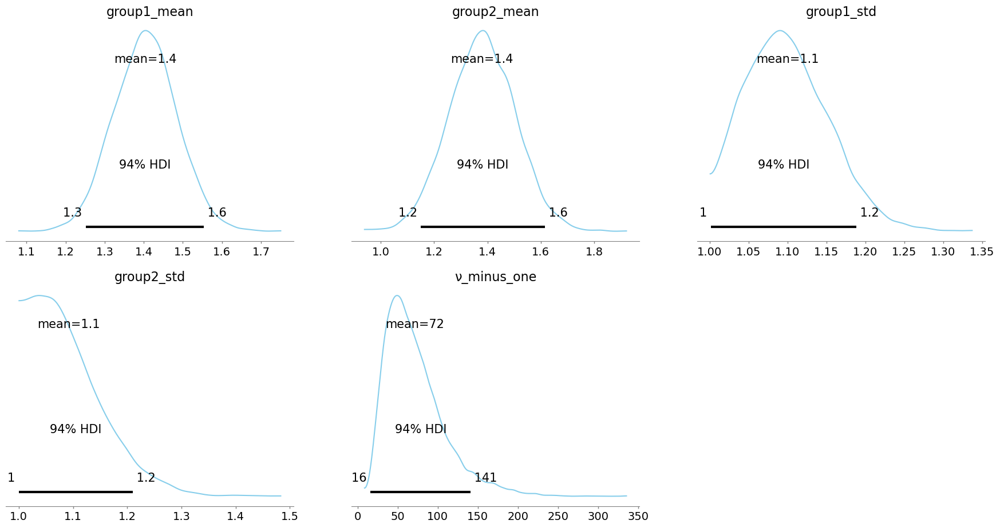

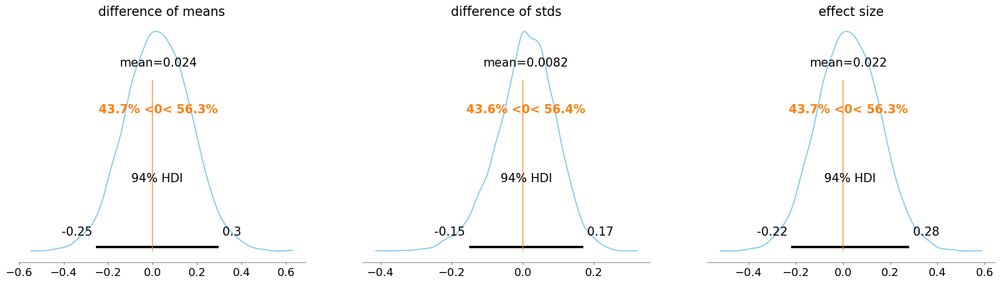

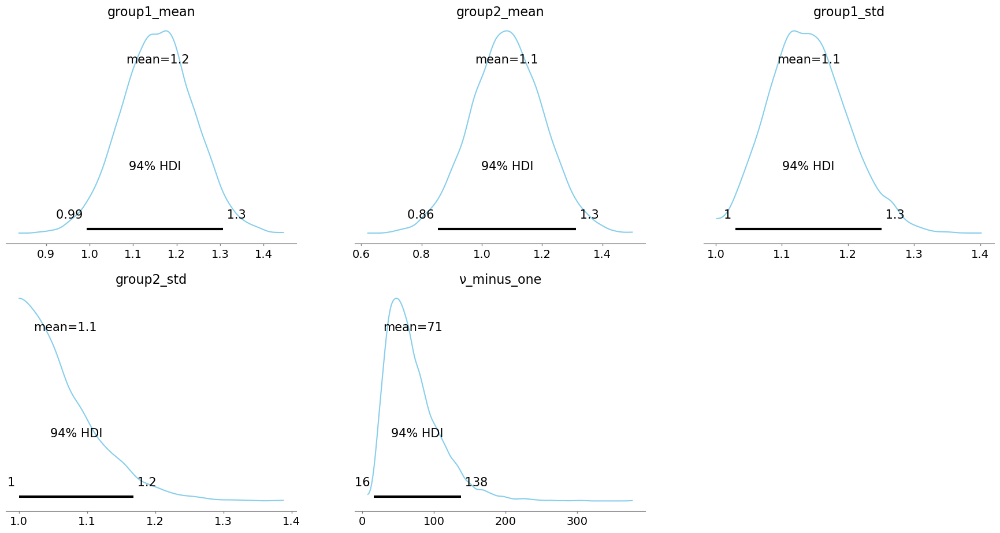

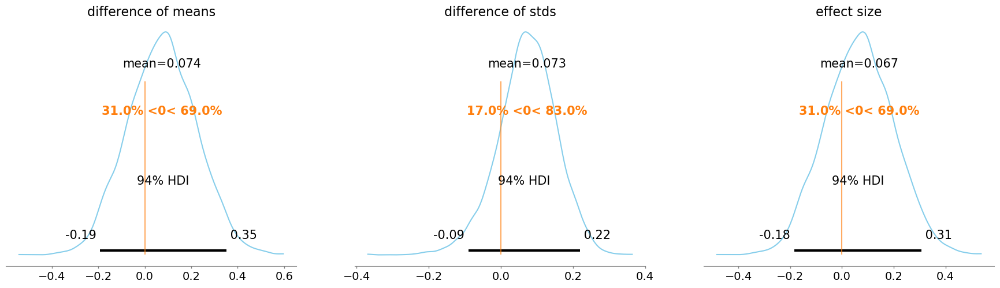

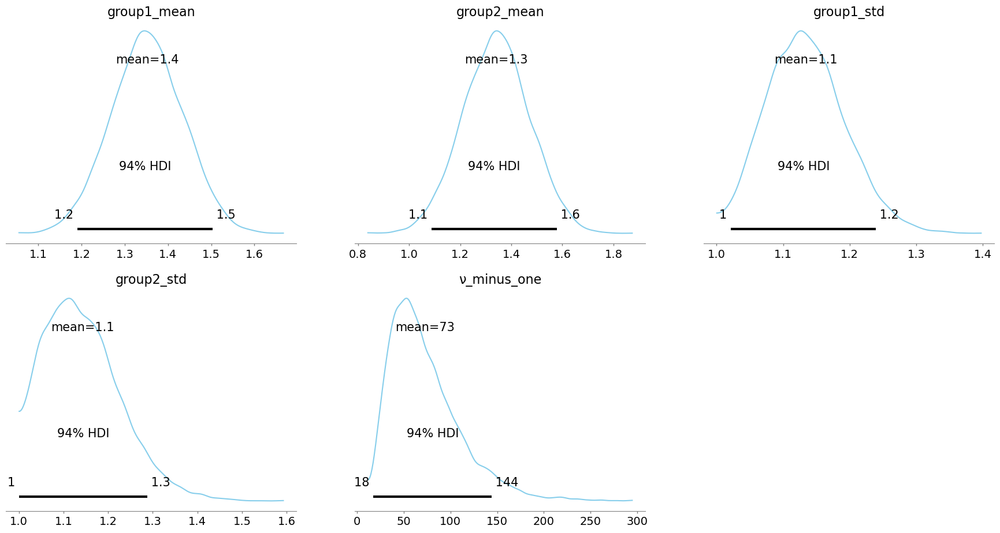

...

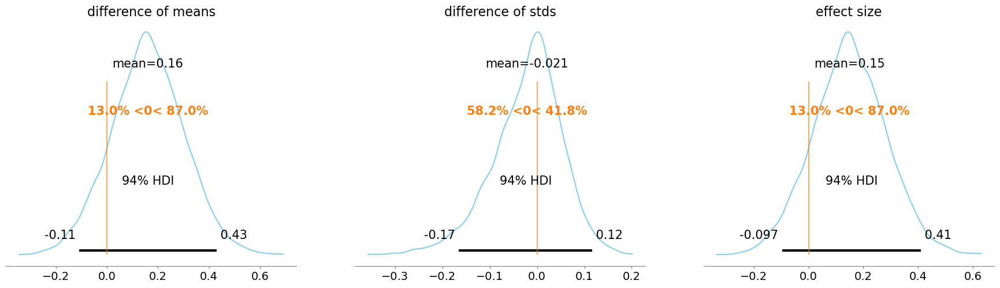

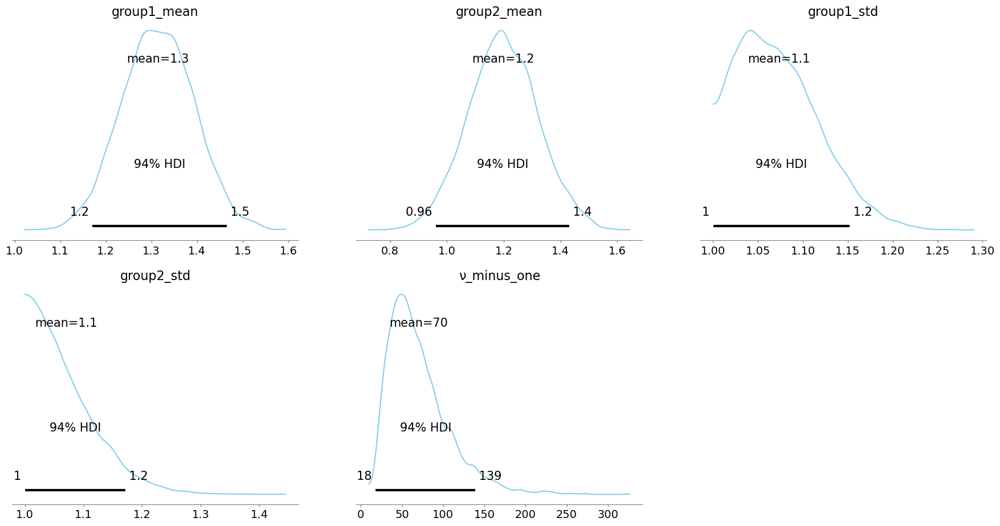

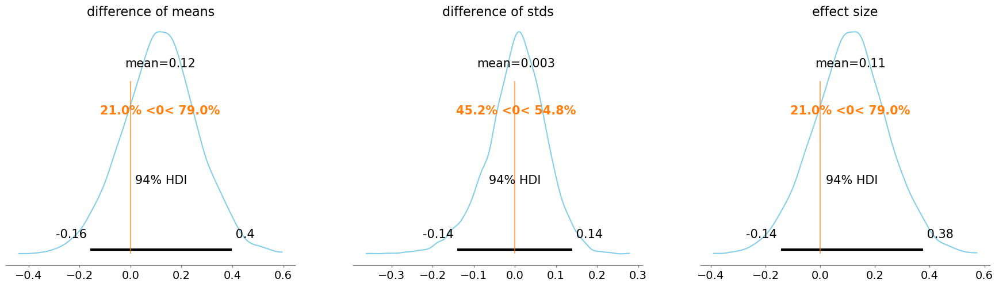

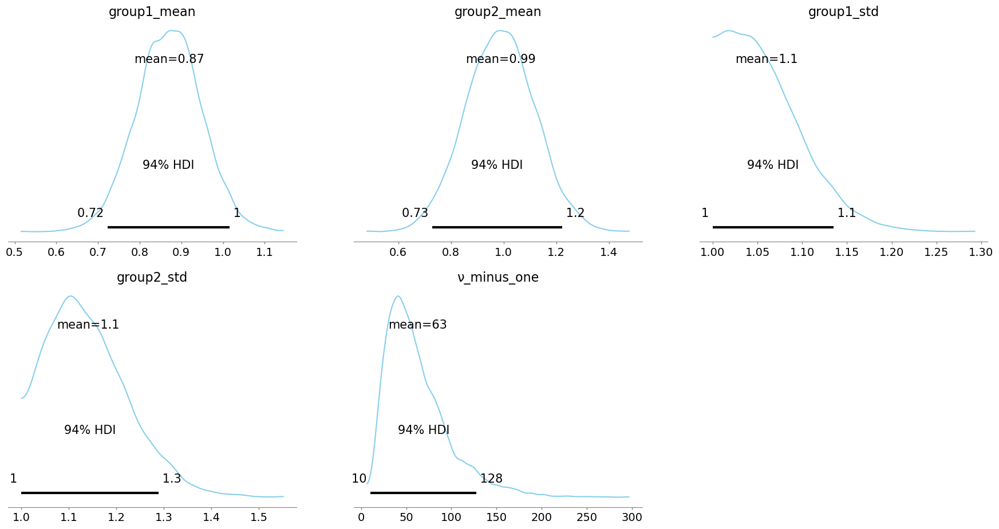

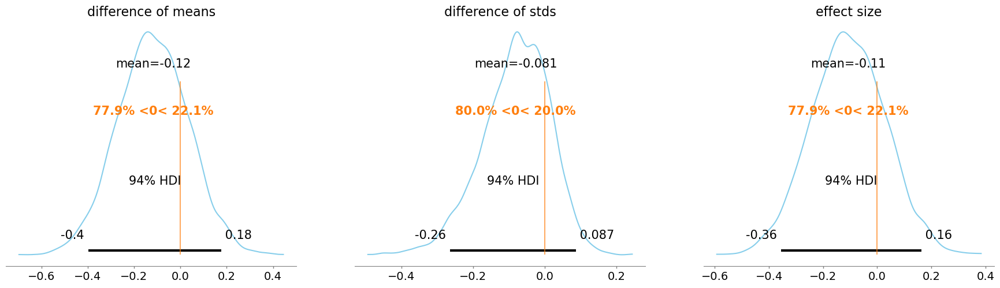

In [62]:
#q = "PHQ - Total"
for q in ['GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfright[q]
    placebo = newdfleft[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

PHQ - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 622 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means  0.042  0.372  -0.609    0.789      0.005    0.005   
difference of stds  -0.211  0.248  -0.650    0.130      0.003    0.002   
effect size          0.036  0.307  -0.551    0.613      0.004    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    6083.0    4330.0    1.0  
difference of stds     6044.0    5238.0    1.0  
effect size            6639.0    4595.0    1.0  
PHQ - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 584 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.042  0.346  -0.685    0.611      0.004    0.004   
difference of stds  -0.107  0.206  -0.490    0.184      0.003    0.002   
effect size         -0.037  0.297  -0.601    0.509      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6603.0    5122.0    1.0  
difference of stds     5726.0    5315.0    1.0  
effect size            6930.0    5439.0    1.0  
PHQ - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 507 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.370  0.342  -1.044    0.250      0.004    0.003   
difference of stds   0.008  0.198  -0.354    0.288      0.002    0.002   
effect size         -0.312  0.285  -0.842    0.228      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6300.0    4983.0    1.0  
difference of stds     7270.0    6201.0    1.0  
effect size            6531.0    5258.0    1.0  
PHQ - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 1057 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.097  0.374  -0.812    0.596      0.004    0.004   
difference of stds  -0.207  0.252  -0.674    0.158      0.003    0.002   
effect size         -0.082  0.308  -0.641    0.516      0.003    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    7566.0    4915.0    1.0  
difference of stds     6318.0    5359.0    1.0  
effect size            8375.0    5413.0    1.0  
PHQ - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 488 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.222  0.422  -1.045    0.533      0.005    0.004   
difference of stds  -0.325  0.338  -0.929    0.198      0.004    0.003   
effect size         -0.170  0.307  -0.762    0.381      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6431.0    5404.0    1.0  
difference of stds     5112.0    4365.0    1.0  
effect size            6917.0    5868.0    1.0  
PHQ - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 1552 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.379  0.360  -1.052    0.302      0.005    0.004   
difference of stds  -0.091  0.226  -0.525    0.236      0.003    0.002   
effect size         -0.320  0.298  -0.870    0.249      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6309.0    5101.0    1.0  
difference of stds     6085.0    5342.0    1.0  
effect size            6739.0    5219.0    1.0  
PHQ - Q8


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 674 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.422  0.366  -1.111    0.263      0.005    0.004   
difference of stds  -0.256  0.238  -0.699    0.044      0.003    0.002   
effect size         -0.369  0.313  -0.989    0.181      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6271.0    4516.0    1.0  
difference of stds     6607.0    4950.0    1.0  
effect size            6724.0    5018.0    1.0  
PHQ - Q9


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 440 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.518  0.342  -1.162    0.129      0.004    0.003   
difference of stds  -0.209  0.217  -0.622    0.037      0.002    0.002   
effect size         -0.464  0.304  -1.025    0.114      0.003    0.002   

                     ess_bulk  ess_tail  r_hat  
difference of means    7447.0    5821.0    1.0  
difference of stds     6020.0    4465.0    1.0  
effect size            7877.0    5821.0    1.0  
GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 298 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.285  0.352  -0.970    0.372      0.004    0.004   
difference of stds  -0.133  0.222  -0.549    0.169      0.003    0.002   
effect size         -0.245  0.297  -0.811    0.317      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7750.0    4994.0    1.0  
difference of stds     6247.0    5867.0    1.0  
effect size            8402.0    5521.0    1.0  
GAD - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 302 seconds.
C:\Users\mltlachac\Anaconda3\lib\site-packages\arviz\plots\backends\matplotlib\__init__.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = subplots(rows, cols, **backend_kwargs)


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.005  0.344  -0.637    0.664      0.004    0.004   
difference of stds  -0.044  0.191  -0.396    0.245      0.002    0.002   
effect size         -0.004  0.292  -0.560    0.539      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6255.0    4842.0    1.0  
difference of stds     7004.0    6216.0    1.0  
effect size            6582.0    5207.0    1.0  
GAD - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 451 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.260  0.327  -0.864    0.347      0.004    0.003   
difference of stds  -0.012  0.166  -0.328    0.223      0.002    0.001   
effect size         -0.229  0.284  -0.779    0.280      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7176.0    4838.0    1.0  
difference of stds     8028.0    6844.0    1.0  
effect size            7506.0    5022.0    1.0  
GAD - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 300 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.267  0.347  -0.904    0.408      0.005    0.004   
difference of stds  -0.088  0.211  -0.463    0.216      0.003    0.002   
effect size         -0.232  0.295  -0.784    0.317      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    5941.0    4692.0    1.0  
difference of stds     6478.0    5549.0    1.0  
effect size            6393.0    5281.0    1.0  
GAD - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 369 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.186  0.343  -0.855    0.437      0.004    0.004   
difference of stds  -0.131  0.188  -0.488    0.130      0.002    0.002   
effect size         -0.166  0.301  -0.763    0.369      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6940.0    5153.0    1.0  
difference of stds     6363.0    5238.0    1.0  
effect size            7269.0    5465.0    1.0  
GAD - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 335 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.294  0.354  -0.947    0.370      0.004    0.004   
difference of stds  -0.164  0.223  -0.589    0.134      0.003    0.002   
effect size         -0.256  0.300  -0.818    0.301      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6467.0    5233.0    1.0  
difference of stds     5655.0    5563.0    1.0  
effect size            6881.0    5397.0    1.0  
GAD - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 354 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.271  0.342  -0.914    0.358      0.004    0.003   
difference of stds  -0.155  0.209  -0.548    0.117      0.002    0.002   
effect size         -0.239  0.296  -0.757    0.351      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7451.0    5160.0    1.0  
difference of stds     6762.0    6306.0    1.0  
effect size            7926.0    5545.0    1.0  


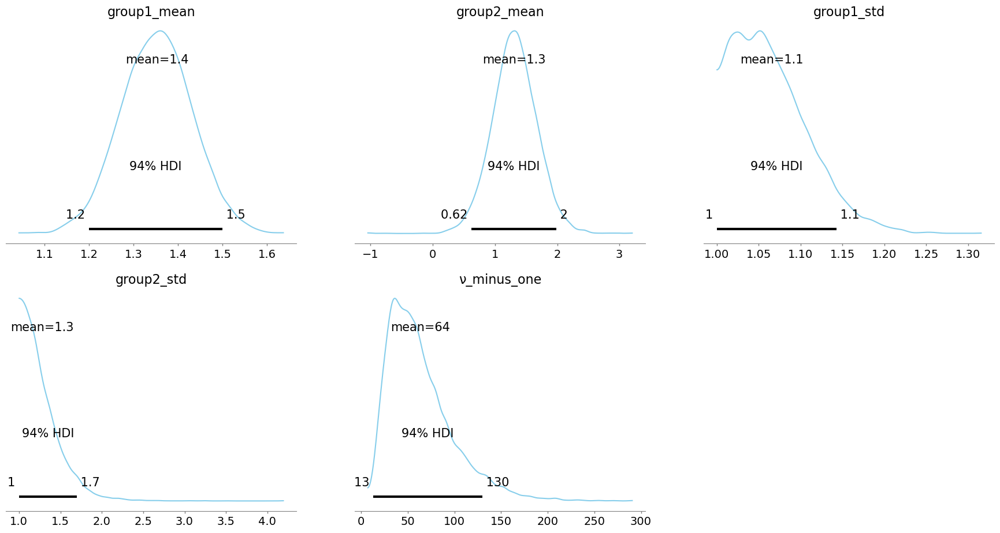

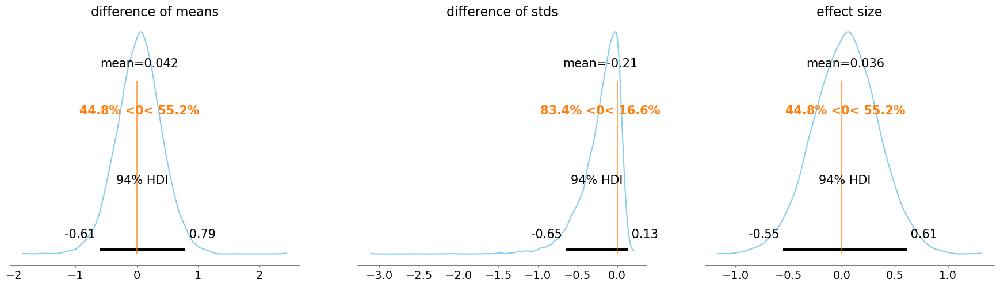

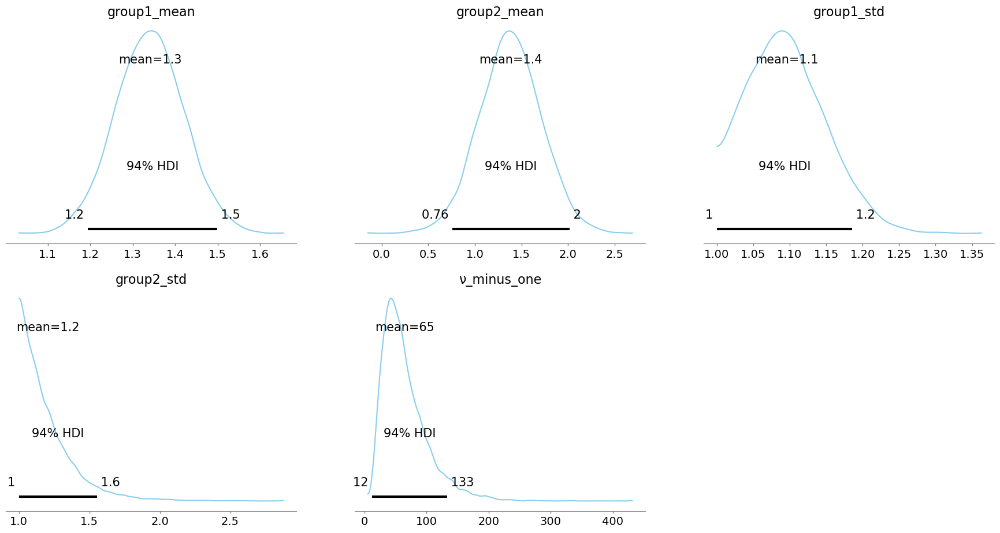

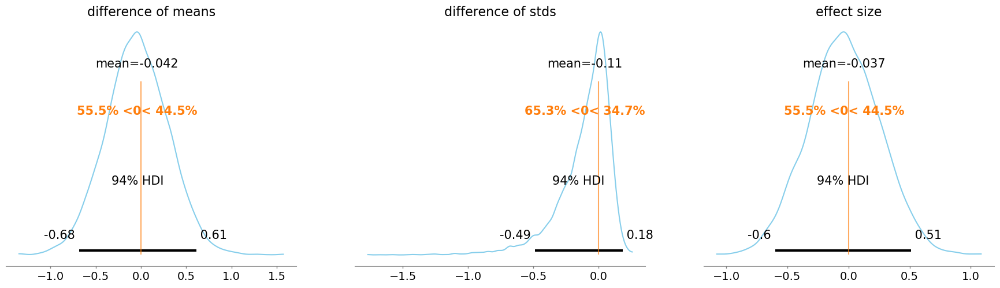

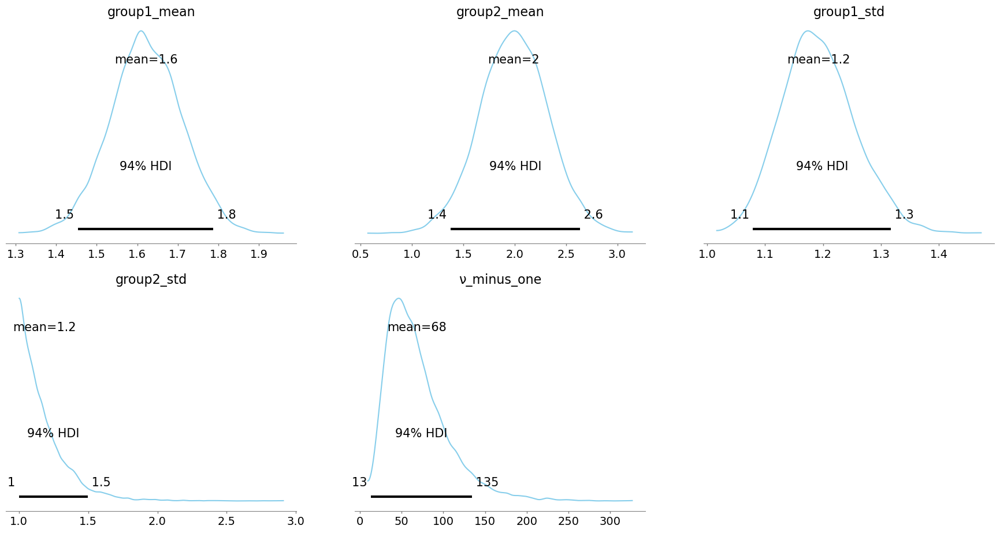

...

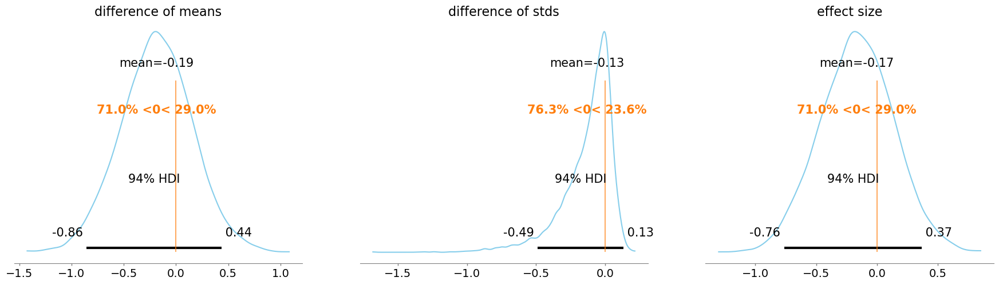

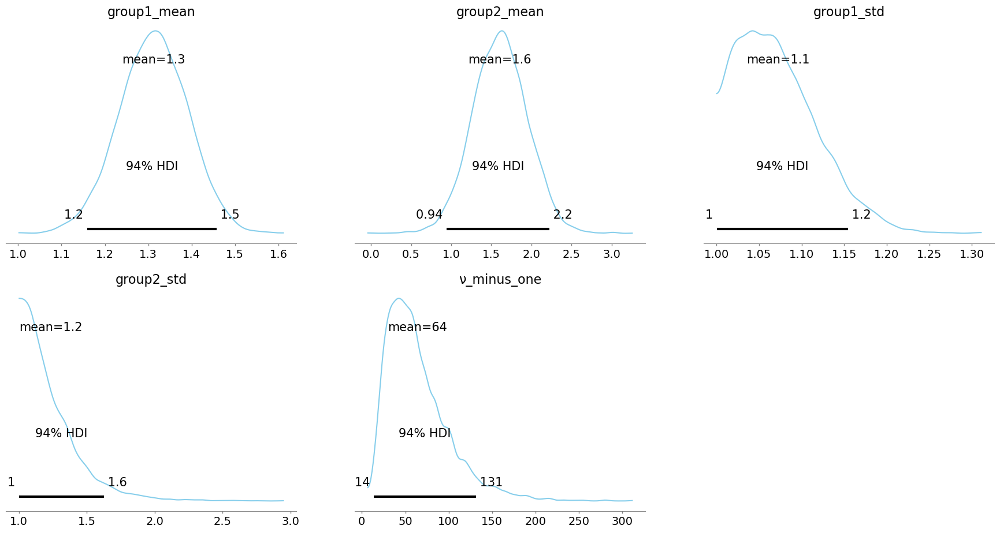

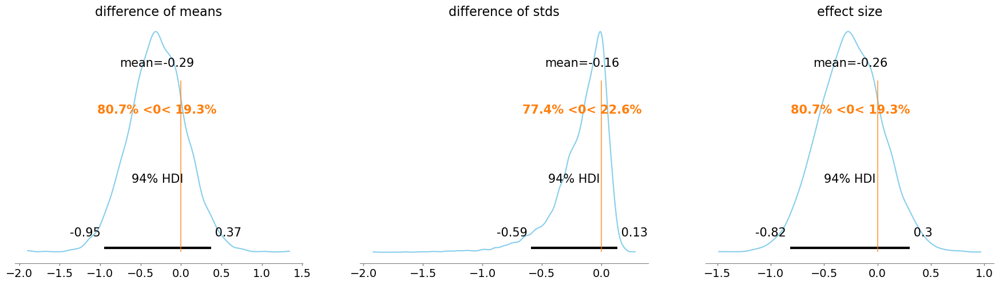

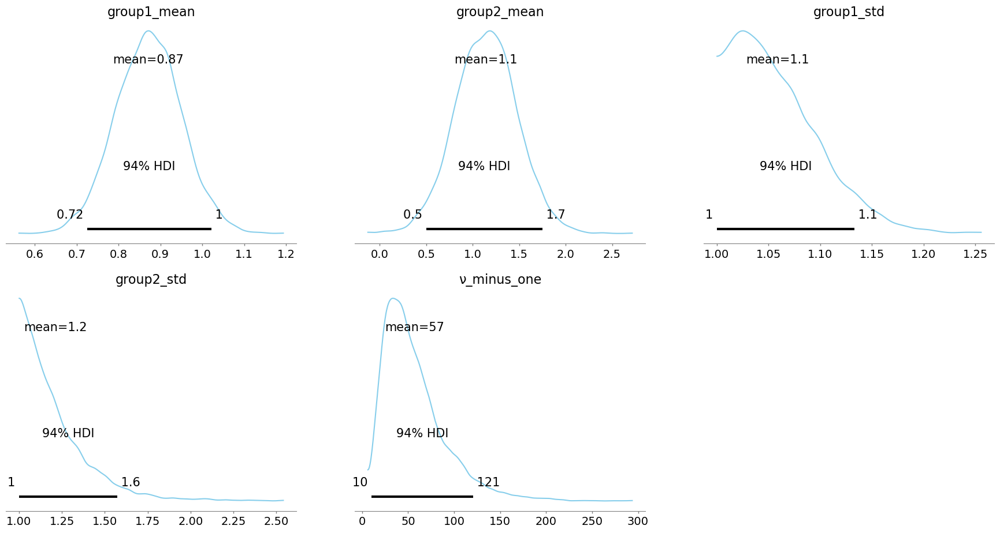

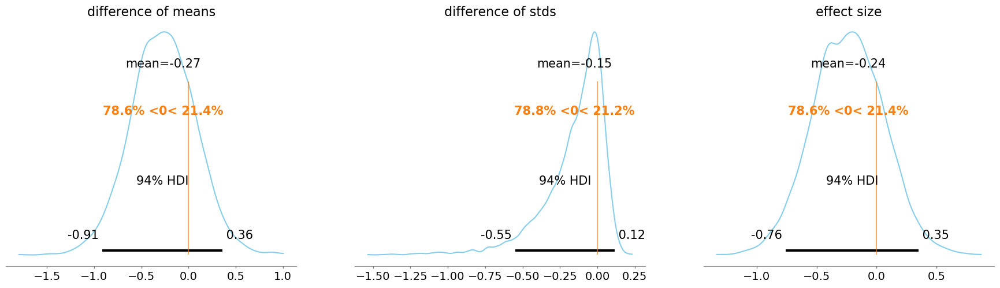

In [60]:
#q = "PHQ - Total"
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfright[q]
    placebo = newdfnw[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

PHQ - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 354 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.085  0.377  -0.798    0.607      0.005    0.004   
difference of stds  -0.210  0.258  -0.696    0.134      0.003    0.002   
effect size         -0.073  0.311  -0.663    0.503      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6059.0    4814.0    1.0  
difference of stds     5171.0    4902.0    1.0  
effect size            6484.0    5035.0    1.0  


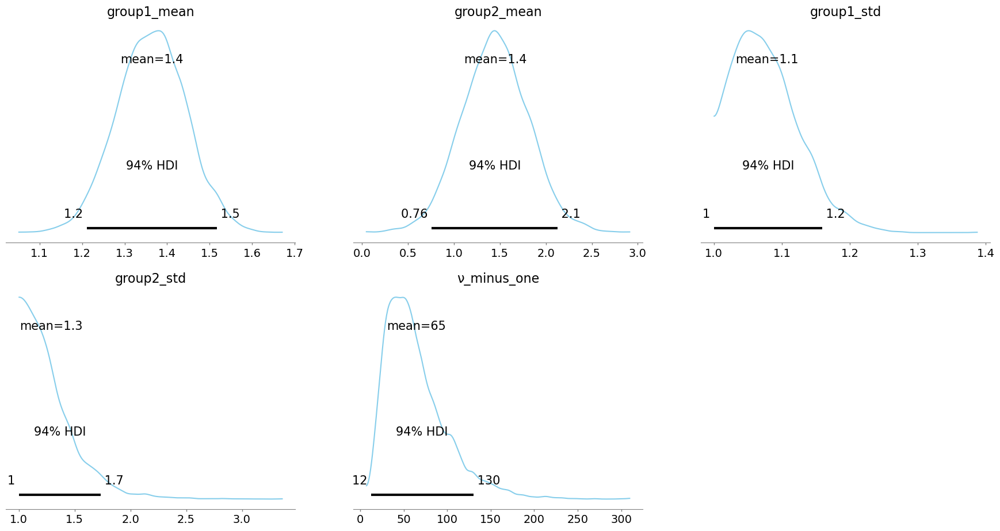

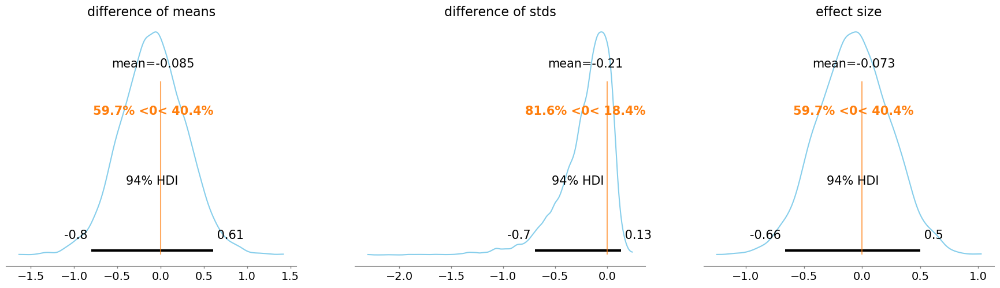

In [63]:
#q = "PHQ - Total"
for q in ['PHQ - Q5']:
    print(q)
    drug = newdfright[q]
    placebo = newdfnw[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

PHQ - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 203 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.097  0.382  -0.791    0.664      0.005    0.005   
difference of stds  -0.218  0.260  -0.728    0.115      0.003    0.002   
effect size         -0.083  0.320  -0.656    0.548      0.004    0.004   

                     ess_bulk  ess_tail  r_hat  
difference of means    5828.0    4687.0    1.0  
difference of stds     5892.0    5229.0    1.0  
effect size            6275.0    5087.0    1.0  
PHQ - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 230 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.175  0.359  -0.831    0.515      0.004    0.004   
difference of stds  -0.132  0.206  -0.524    0.165      0.002    0.002   
effect size         -0.155  0.312  -0.756    0.413      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6844.0    5172.0    1.0  
difference of stds     6084.0    5809.0    1.0  
effect size            7224.0    5277.0    1.0  
PHQ - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 223 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.369  0.357  -1.036    0.288      0.004    0.003   
difference of stds  -0.003  0.208  -0.391    0.343      0.003    0.002   
effect size         -0.313  0.300  -0.881    0.242      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7062.0    5011.0    1.0  
difference of stds     6676.0    5825.0    1.0  
effect size            7385.0    5153.0    1.0  
PHQ - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 225 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.418  0.351  -1.078    0.258      0.004    0.004   
difference of stds  -0.082  0.203  -0.456    0.249      0.002    0.002   
effect size         -0.365  0.303  -0.933    0.209      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6744.0    5046.0    1.0  
difference of stds     6817.0    5987.0    1.0  
effect size            7069.0    5269.0    1.0  
PHQ - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 207 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.416  0.381  -1.157    0.268      0.005    0.004   
difference of stds  -0.170  0.257  -0.683    0.202      0.003    0.002   
effect size         -0.349  0.314  -0.960    0.215      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    5760.0    4745.0    1.0  
difference of stds     6588.0    5402.0    1.0  
effect size            6171.0    4936.0    1.0  
PHQ - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 193 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.440  0.445  -1.306    0.390      0.005    0.004   
difference of stds  -0.412  0.351  -1.048    0.157      0.004    0.003   
effect size         -0.341  0.334  -0.958    0.301      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6862.0    5502.0    1.0  
difference of stds     5741.0    3458.0    1.0  
effect size            7469.0    5567.0    1.0  
PHQ - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 192 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.510  0.366  -1.153    0.212      0.005    0.004   
difference of stds  -0.147  0.229  -0.564    0.221      0.003    0.002   
effect size         -0.443  0.314  -1.018    0.161      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6196.0    5010.0    1.0  
difference of stds     6036.0    5890.0    1.0  
effect size            6432.0    5030.0    1.0  
PHQ - Q8


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 190 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.512  0.371  -1.203    0.203      0.004    0.003   
difference of stds  -0.247  0.249  -0.717    0.061      0.003    0.002   
effect size         -0.445  0.317  -1.039    0.167      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6977.0    5020.0    1.0  
difference of stds     6615.0    4760.0    1.0  
effect size            7591.0    5036.0    1.0  
PHQ - Q9


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 191 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.538  0.365  -1.210    0.178      0.004    0.003   
difference of stds  -0.180  0.213  -0.564    0.104      0.003    0.002   
effect size         -0.479  0.321  -1.066    0.155      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7056.0    5643.0    1.0  
difference of stds     5860.0    5821.0    1.0  
effect size            7419.0    5643.0    1.0  
GAD - Q1


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 190 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.306  0.357  -0.944    0.389      0.004    0.004   
difference of stds  -0.143  0.234  -0.567    0.224      0.003    0.002   
effect size         -0.264  0.303  -0.813    0.319      0.003    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    7150.0    4965.0    1.0  
difference of stds     6085.0    5295.0    1.0  
effect size            7624.0    5306.0    1.0  
GAD - Q2


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 220 seconds.
C:\Users\mltlachac\Anaconda3\lib\site-packages\arviz\plots\backends\matplotlib\__init__.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = subplots(rows, cols, **backend_kwargs)


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.086  0.352  -0.744    0.565      0.004    0.004   
difference of stds  -0.116  0.197  -0.496    0.164      0.002    0.002   
effect size         -0.076  0.308  -0.644    0.502      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6769.0    5344.0    1.0  
difference of stds     6974.0    6135.0    1.0  
effect size            7211.0    5601.0    1.0  
GAD - Q3


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 204 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.277  0.342  -0.887    0.383      0.004    0.003   
difference of stds  -0.006  0.174  -0.348    0.268      0.002    0.002   
effect size         -0.243  0.297  -0.795    0.311      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6762.0    5702.0    1.0  
difference of stds     7420.0    6143.0    1.0  
effect size            6918.0    5788.0    1.0  
GAD - Q4


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 200 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.285  0.356  -0.931    0.400      0.004    0.004   
difference of stds  -0.076  0.208  -0.494    0.241      0.002    0.002   
effect size         -0.247  0.304  -0.810    0.317      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6840.0    5189.0    1.0  
difference of stds     6480.0    6711.0    1.0  
effect size            7224.0    5415.0    1.0  
GAD - Q5


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 210 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.351  0.362  -1.045    0.315      0.005    0.004   
difference of stds  -0.118  0.199  -0.499    0.180      0.002    0.002   
effect size         -0.310  0.315  -0.909    0.283      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6171.0    4931.0    1.0  
difference of stds     7360.0    5647.0    1.0  
effect size            6860.0    5180.0    1.0  
GAD - Q6


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 200 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.405  0.364  -1.099    0.278      0.004    0.004   
difference of stds  -0.169  0.232  -0.604    0.165      0.003    0.002   
effect size         -0.353  0.313  -0.939    0.245      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6714.0    5181.0    1.0  
difference of stds     6516.0    5246.0    1.0  
effect size            7162.0    5209.0    1.0  
GAD - Q7


C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
C:\Users\mltlachac\Anaconda3\lib\site-packages\pytensor\tensor\rewriting\elemwise.py:1030: UserWarning: Loop fusion failed because the resulting node would exceed the kernel argument limit.
  warn(
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [group1_mean, group2_mean, group1_std, group2_std, ν_minus_one]


Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 197 seconds.


                      mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  \
difference of means -0.163  0.362  -0.868    0.504      0.004    0.004   
difference of stds  -0.076  0.214  -0.490    0.280      0.003    0.002   
effect size         -0.141  0.305  -0.723    0.430      0.004    0.003   

                     ess_bulk  ess_tail  r_hat  
difference of means    6975.0    5160.0    1.0  
difference of stds     7374.0    5918.0    1.0  
effect size            7257.0    5410.0    1.0  


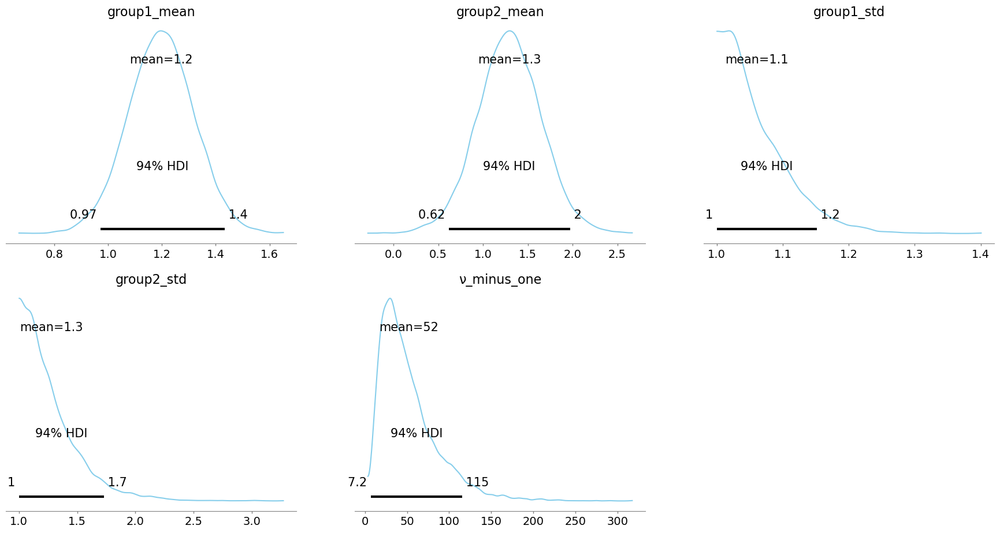

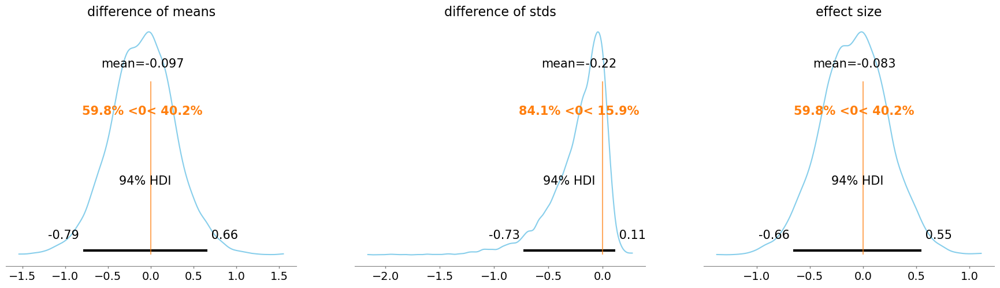

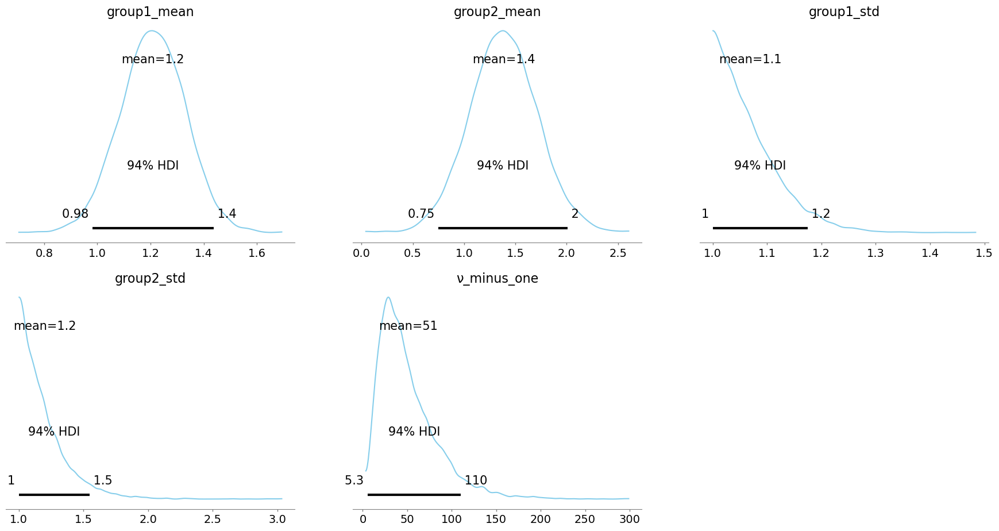

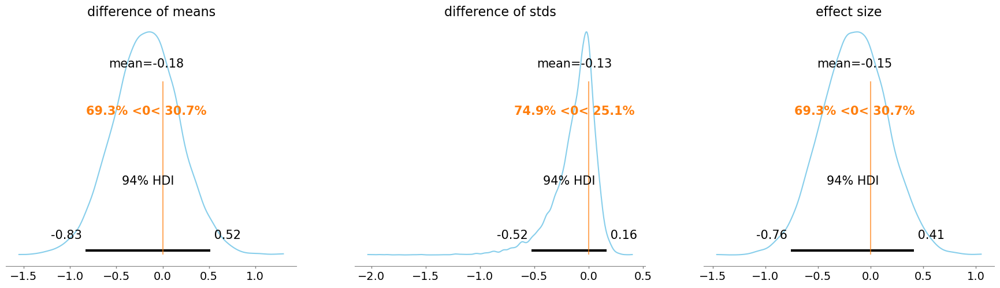

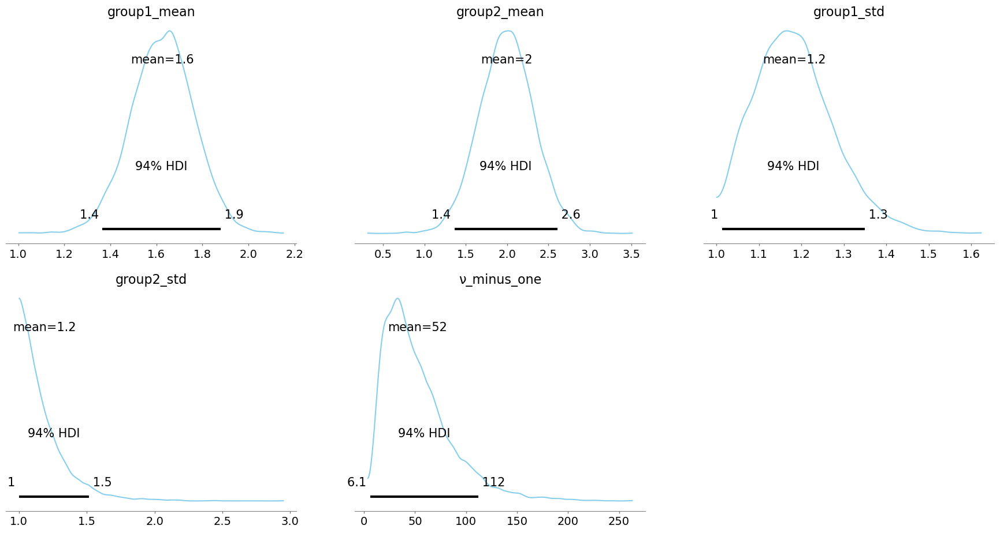

...

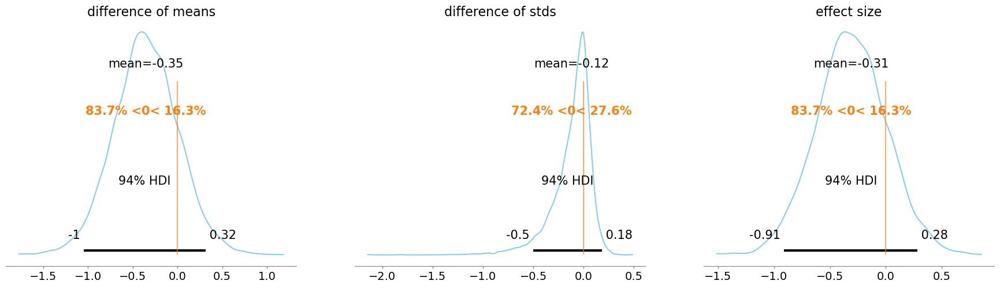

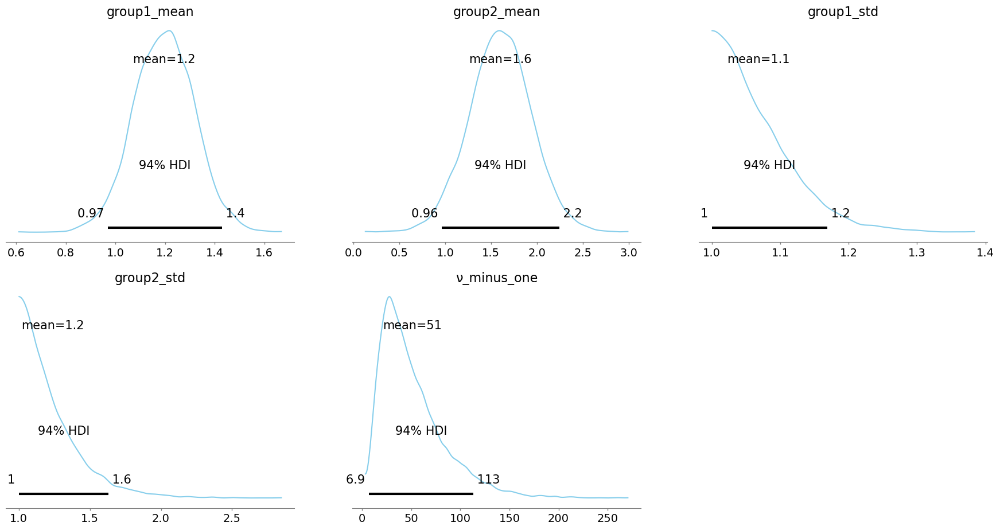

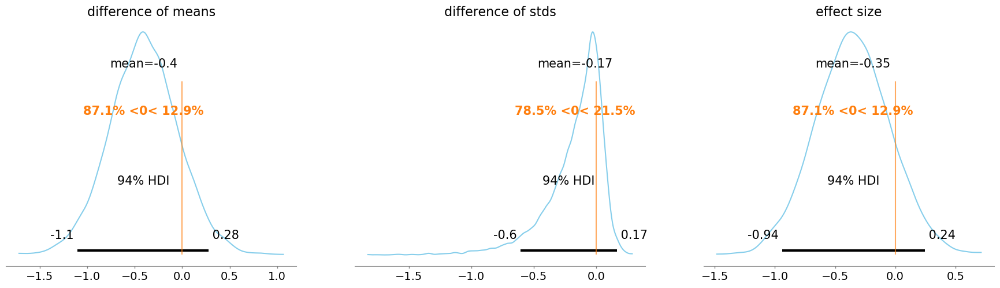

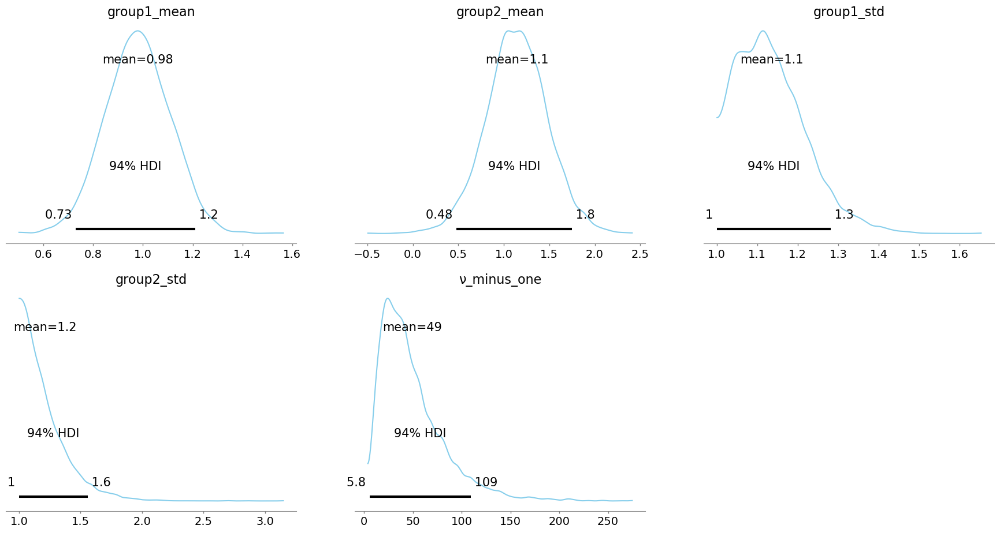

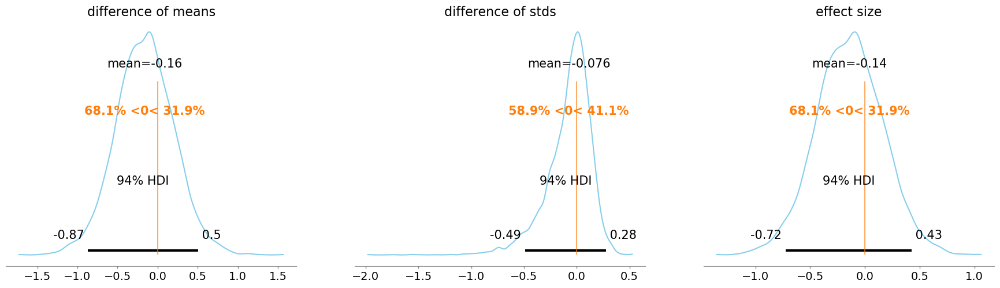

In [61]:
#q = "PHQ - Total"
for q in ['PHQ - Q1', 'PHQ - Q2', 'PHQ - Q3', 'PHQ - Q4', 'PHQ - Q5', 'PHQ - Q6', 'PHQ - Q7', 'PHQ - Q8', 'PHQ - Q9', 'GAD - Q1', 'GAD - Q2', 'GAD - Q3', 'GAD - Q4', 'GAD - Q5', 'GAD - Q6', 'GAD - Q7']:
    print(q)
    drug = newdfleft[q]
    placebo = newdfnw[q]

    y1 = np.array(drug)
    y2 = np.array(placebo)
    y = pd.DataFrame(
        dict(value=np.r_[y1, y2], group=np.r_[["drug"] * len(drug), ["placebo"] * len(placebo)])
    )

    μ_m = y.value.mean()
    μ_s = y.value.std() * 2

    with pm.Model() as model:
        group1_mean = pm.Normal("group1_mean", mu=μ_m, sigma=μ_s)
        group2_mean = pm.Normal("group2_mean", mu=μ_m, sigma=μ_s)

    σ_low = 1
    σ_high = 10

    with model:
        group1_std = pm.Uniform("group1_std", lower=σ_low, upper=σ_high)
        group2_std = pm.Uniform("group2_std", lower=σ_low, upper=σ_high)

    with model:
        ν = pm.Exponential("ν_minus_one", 1 / 29.0) + 1

    with model:
        λ1 = group1_std ** -2
        λ2 = group2_std ** -2

        group1 = pm.StudentT("drug", nu=ν, mu=group1_mean, lam=λ1, observed=y1)
        group2 = pm.StudentT("placebo", nu=ν, mu=group2_mean, lam=λ2, observed=y2)

    with model:
        diff_of_means = pm.Deterministic("difference of means", group1_mean - group2_mean)
        diff_of_stds = pm.Deterministic("difference of stds", group1_std - group2_std)
        effect_size = pm.Deterministic(
            "effect size", diff_of_means / np.sqrt((group1_std ** 2 + group2_std ** 2) / 2)
        )

    with model:
        trace = pm.sample(2000)

    pm.plot_posterior(
        trace,
        var_names=["group1_mean", "group2_mean", "group1_std", "group2_std", "ν_minus_one"],
        color="#87ceeb",
    );

    pm.plot_posterior(
        trace,
        var_names=["difference of means", "difference of stds", "effect size"],
        ref_val=0,
        color="#87ceeb",
    );

    print(pm.summary(trace, var_names=["difference of means", "difference of stds", "effect size"]))

## Back to other stuff

In [28]:
texts = pd.read_csv("textLogsDepreST-CAT2021.csv")
print(texts.shape)
textsin = texts[texts.Direction == 1].reset_index()
textsout = texts[texts.Direction == 2].reset_index()
print(textsin.shape[0]+textsout.shape[0])
texts.head(2)

(444925, 4)
444925


,id,UnixTimestamp,Direction,Contact
0,HJERN37PE,1578822661204,1,f48f908ec1db8d3e7f86d516ebdab5213f892b7235c421...
1,HJERN37PE,1578822661793,1,f48f908ec1db8d3e7f86d516ebdab5213f892b7235c421...


In [29]:
outc = []
idlist = newdfleft["id"]
for i in range(0, len(idlist)):
    part = idlist[i]
    count = 0
    stamp = pd.to_datetime(newdfleft.Timestamp[i][1:-1])
    temp = textsin[textsin["id"] == part]
    for ts in temp.UnixTimestamp:
        stamp2 = pd.to_datetime(ts, unit = 'ms')
        diff = (stamp-stamp2).days
        if diff <112:
            count = count+1
    outc.append(count)

In [30]:
print(outc)

[1796, 392, 820, 7, 0, 361, 93, 13, 0, 0, 604, 240, 553, 1, 9, 320, 374, 285, 428, 0, 204, 247, 239, 47, 172, 624, 293, 252, 256, 285, 298, 71, 199, 305, 3, 6, 0, 0, 105, 0, 243, 1472, 0, 406, 455, 505, 0, 635, 676, 26, 0, 1, 355, 597, 1, 994, 4, 245, 480, 403, 45, 584, 0, 396, 160, 309, 196, 2, 215, 142, 193, 0, 429, 2, 401, 255, 133, 0, 363]


In [31]:
check = pd.DataFrame()
check["id"] = idlist
check["old"] = newdfleft["intext14"]
check["new"] = outc
check.to_csv("checkResearch.csv")

In [32]:
for log in ["incall14", "outcall14", "intext14", "outtext14"]:
    #print(log)
    #print('&', int(round(sum(newdfne[log])/len(newdfne[log]))),  "$\pm$", int(round(newdfne[log].std())))
    #print('&', int(round(sum(newdfright[log])/len(newdfright[log]))), "$\pm$",  int(round(newdfright[log].std())))
    #print('&', int(round(sum(newdfleft[log])/len(newdfleft[log]))), "$\pm$", int(round(newdfleft[log].std())))
    print('&', int(round(sum(newdfnw[log])/len(newdfnw[log]))), "$\pm$", int(round(newdfnw[log].std())))


& 5 $\pm$ 12
& 92 $\pm$ 193
& 29 $\pm$ 31
& 20 $\pm$ 22


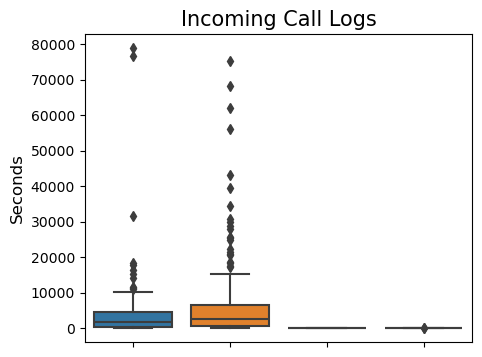

& 0.0


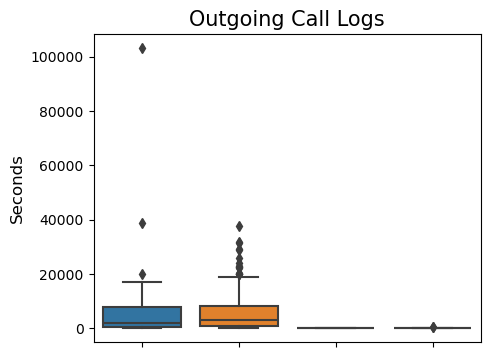

& 0.0


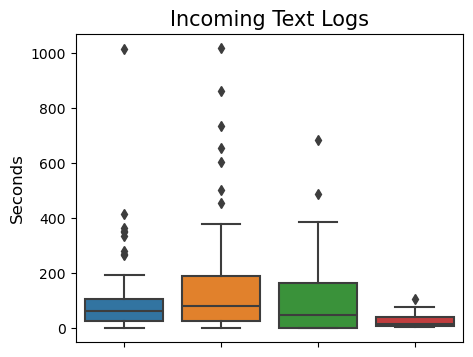

& 0.165


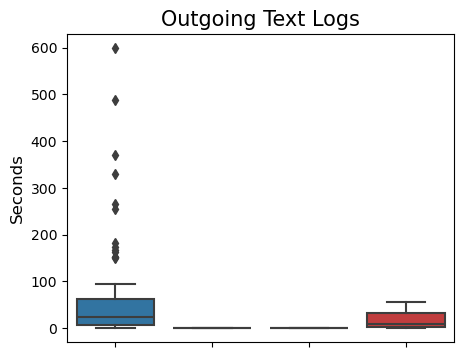

& nan


In [34]:
loglist = ["incall14", "outcall14", "intext14", "outtext14"]
tlist = ["Incoming Call Logs", "Outgoing Call Logs", "Incoming Text Logs", "Outgoing Text Logs"]

for i in range(0,4):
    log = loglist[i]
    tname = tlist[i]
#log in ["incall14", "outcall14", "intext14", "outtext14"]:

    fig = plt.figure(figsize =(5,4))
    fig = sns.boxplot(data=[newdfne[log], newdfright[log], newdfleft[log], newdfnw[log]])
    plt.title(log)
    plt.title(tname, fontsize = 15)
    plt.ylabel("Seconds", fontsize = 12)
    fig.set(xticklabels=[])
    
    #plt.savefig("images/" + log + ".png", bbox_inches= 'tight')
    plt.show()
    plt.close()
    print('&', round(ttest_ind(newdfright[log], newdfleft[log])[1],3))
    #print(f_oneway(newdfne[log], newdfright[log], newdfleft[log], newdfnw[log]))

In [36]:
for demo in ['Gender', 'Age','StudentStatus', 'PriorDepressionTreatment', 'Remote', 'COVID', 'Group']:
    print(newdfne[demo].value_counts(), newdfne[demo].value_counts()/newdfne.shape[0])
    print(newdfright[demo].value_counts(), newdfright[demo].value_counts()/newdfright.shape[0])
    print(newdfleft[demo].value_counts(), newdfleft[demo].value_counts()/newdfleft.shape[0])
    print(newdfnw[demo].value_counts(), newdfnw[demo].value_counts()/newdfnw.shape[0])
    
    print("_______________________________________")

Woman    47
Man      35
Other     5
-         1
Name: Gender, dtype: int64 Woman    0.534091
Man      0.397727
Other    0.056818
-        0.011364
Name: Gender, dtype: float64
Woman    94
Man      88
Other     7
Name: Gender, dtype: int64 Woman    0.497354
Man      0.465608
Other    0.037037
Name: Gender, dtype: float64
Man      46
Woman    31
Other     2
Name: Gender, dtype: int64 Man      0.582278
Woman    0.392405
Other    0.025316
Name: Gender, dtype: float64
Woman    6
Man      6
Other    1
Name: Gender, dtype: int64 Woman    0.461538
Man      0.461538
Other    0.076923
Name: Gender, dtype: float64
_______________________________________
24-39    43
40-55    29
18-23    13
56+       2
-         1
Name: Age, dtype: int64 24-39    0.488636
40-55    0.329545
18-23    0.147727
56+      0.022727
-        0.011364
Name: Age, dtype: float64
24-39    110
18-23     40
40-55     36
56+        3
Name: Age, dtype: int64 24-39    0.582011
18-23    0.211640
40-55    0.190476
56+      0.015873
N